### Step 1: Obtain Data

In [1]:
import pandas as pd
import os
import shutil

data = pd.read_csv("images_2007724.csv")

/var/folders/tw/djq1qjxx4_v0lvns6wbl3cxm0000gn/T/ipykernel_43619/2618677848.py:5: DtypeWarning: Columns (17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("images_2007724.csv")


In [2]:
data.columns
data['deployment_id'].unique()

array(['SW01A', 'SW01B', 'SW01C', 'SW01D', 'SW01E', 'SW01F', 'SW02A',
       'SW02B', 'SW02C', 'SW02D', 'SW02E', 'SW02F', 'SW03A', 'SW03C',
       'SW03E', 'SW03F', 'SW04A', 'SW04B', 'SW04E', 'SW04F', 'SW05A',
       'SW05B', 'SW05F', 'SW06A', 'SW06B', 'SW06C', 'SW06D', 'SW06E',
       'SW06F', 'SW07A', 'SW07B', 'SW07C', 'SW07D', 'SW07E', 'SW07F',
       'SW07P', 'SW08A', 'SW08B', 'SW08D', 'SW08E', 'SW08F', 'SW09A',
       'SW09B', 'SW09C', 'SW09D', 'SW09E', 'SW09F', 'SW10A', 'SW03D',
       'SW03P', 'SW04D', 'SW10B', 'SW10C', 'SW10D', 'SW10E', 'SW10F',
       'SW10P', 'SW11A', 'SW11B', 'SW11C', 'SW05C', 'SW08C', 'SW11D',
       'SW11E', 'SW11F', 'SW12A', 'SW12B', 'SW12C', 'SW12D', 'SW12E',
       'SW12F', 'SW13A', 'SW13B', 'SW13C', 'SW13D', 'SW13E', 'SW13F',
       'SW14A', 'SW14B', 'SW14C', 'SW14D', 'SW14E', 'SW15A', 'SW15B',
       'SW15C', 'SW15D', 'SW15E', 'SW15F', 'SW16A', 'SW16B', 'SW16D',
       'SW16E', 'SW16P', 'SW17A', 'SW17B', 'SW17C', 'SW17D', 'SW17E',
       'SW18A', 'SW1

In [3]:
# What camera images do we have so far?
avail_deploy = ['SW09D'
                ,'SW16A', 'SW16B', 'SW16C', 'SW16D', 'SW16E', 'SW16F', 'SW16P'
                ,'SW17A', 'SW17B', 'SW17C', 'SW17D', 'SW17E', 'SW17F'
                ,'SW18A', 'SW18B', 'SW18C', 'SW18D', 'SW18E', 'SW18F'
                ,'SWF01F', 'SWF02F', 'SWF03F', 'SWF04F']

current_data = data[data['deployment_id'].isin(avail_deploy)]

In [50]:
# Remove blank, set-up images
current_data_animal = current_data[(~current_data['common_name'].isin(['Blank', 'Setup_Pickup'])) & 
                                    (current_data['common_name'].notna())]
current_data_animal['common_name'].value_counts()

common_name
White-bellied Pangolin                279
Western Tree Hyrax                     97
Red River Hog                          70
Chimpanzee                             42
Putty-nosed Monkey                     36
Galago Species                         32
Giant Ground Pangolin                  29
Dwarf Hornbill                         24
African Harrier-hawk                   23
Congo Pied Hornbill                    20
Lord Derby's Scaly-tailed Squirrel     19
Cephalophus Species                    16
Grey-cheeked Mangabey                  14
African Giant Squirrel                 13
Milne-Edwards's Potto                  11
Primate                                 9
Rodent                                  8
Western Little Hornbill                 8
Graphiurus Species                      8
Red-headed Malimbe                      8
Western Bluebill                        8
Western Nicator                         7
Unknown                                 7
Great Blue Turaco     

In [5]:
# Extract the filenames of the images that have pangolins
pangolin_df = current_data_animal[current_data_animal['common_name'].str.contains('pangolin', case=False, na=False)]
pangolin_files = pangolin_df['filename'].tolist()

# Extract the filenames of the images in current_data_animal that are other animals
animal_df = current_data_animal[~current_data_animal['common_name'].str.contains('pangolin', case=False, na=False)]
animal_files = animal_df['filename'].tolist()


In [9]:
import os
import shutil
import torch
import numpy as np
from PIL import Image, ImageDraw
from transformers import DetrImageProcessor, DetrForObjectDetection
import ssl

ssl._create_default_https_context = ssl._create_unverified_context

# Setup destination folder for Pangolin images
destination_folder = 'Pangolin_Images_3_12_Preprocessed'  # Make sure you have this folder created in the same directory.
os.makedirs(destination_folder, exist_ok=True)

# Load the pre-trained DETR model and processor
model = DetrForObjectDetection.from_pretrained('facebook/detr-resnet-50')
processor = DetrImageProcessor.from_pretrained('facebook/detr-resnet-50')
model.eval()

# Loop through the pangolin DataFrame
for _, row in pangolin_df.iterrows():
    source_folder = row['deployment_id']
    filename = row['filename']
    source_path = os.path.join(source_folder, filename)

    if os.path.isfile(source_path):
        # 1. Copy the image into the destination folder
        dest_path = os.path.join(destination_folder, filename)
        shutil.copy2(source_path, dest_path)

        # 2. Open the copied image for processing
        with Image.open(dest_path) as img:
            # 3. Preprocess the image and run the model
            inputs = processor(images=img, return_tensors="pt")
            with torch.no_grad():
                outputs = model(**inputs)

            # Extract the bounding boxes, labels, and scores from the model outputs
            target_sizes = torch.tensor([img.size[::-1]])  # H, W format for target size
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

            # Check if any objects are detected
            if len(results['boxes']) > 0:
                # 4. Use the first bounding box to crop around the pangolin (if detected)
                box = results['boxes'][0].tolist()  # Get the first bounding box (in xyxy format)
                left, top, right, bottom = box

                # Crop the image around the bounding box
                cropped_img = img.crop((left, top, right, bottom))

                # 5. Convert the cropped image to black and white
                bw_img = cropped_img.convert('L')

                # 6. Save the processed image back to the destination folder
                bw_img.save(dest_path)
            else:
                img = img.convert('L')
                img.save(dest_path)


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [10]:
# Setup destination folder
destination_folder = 'Other_Animal_Images_3_12_Preprocessed'
os.makedirs(destination_folder, exist_ok=True)

# Load the pre-trained DETR model and processor
model = DetrForObjectDetection.from_pretrained('facebook/detr-resnet-50')
processor = DetrImageProcessor.from_pretrained('facebook/detr-resnet-50')
model.eval()

# Loop through the pangolin DataFrame
for _, row in animal_df.iterrows():
    source_folder = row['deployment_id']
    filename = row['filename']
    source_path = os.path.join(source_folder, filename)

    if os.path.isfile(source_path):
        # 1. Copy the image into the destination folder
        dest_path = os.path.join(destination_folder, filename)
        shutil.copy2(source_path, dest_path)

        # 2. Open the copied image for processing
        with Image.open(dest_path) as img:
            # 3. Preprocess the image and run the model
            inputs = processor(images=img, return_tensors="pt")
            with torch.no_grad():
                outputs = model(**inputs)

            # Extract the bounding boxes, labels, and scores from the model outputs
            target_sizes = torch.tensor([img.size[::-1]])  # H, W format for target size
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

            # Check if any objects are detected
            if len(results['boxes']) > 0:
                # 4. Use the first bounding box to crop around the pangolin (if detected)
                box = results['boxes'][0].tolist()  # Get the first bounding box (in xyxy format)
                left, top, right, bottom = box

                # Crop the image around the bounding box
                cropped_img = img.crop((left, top, right, bottom))

                # 5. Convert the cropped image to black and white
                bw_img = cropped_img.convert('L')

                # 6. Save the processed image back to the destination folder
                bw_img.save(dest_path)
            else:
                img = img.convert('L')
                img.save(dest_path)


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


### Step 2: Create baseline x_train and y_train (without the splits)

In [30]:
# Suppress warnings
import os
import pandas as pd

# Define base folders
pangolin_folder = "Pangolin_Images_3_12_Preprocessed"
other_animals_folder = "Other_Animal_Images_3_12_Preprocessed"

# Get the list of files in each folder
pangolin_files = [f for f in os.listdir(pangolin_folder) if f.endswith('.JPG')]
other_animal_files = [f for f in os.listdir(other_animals_folder) if f.endswith('.JPG')]

# Create file paths for each image
pangolin_filepaths = [os.path.join(pangolin_folder, f) for f in pangolin_files]
other_animal_filepaths = [os.path.join(other_animals_folder, f) for f in other_animal_files]

# Combine file paths and create labels
filepaths = pangolin_filepaths + other_animal_filepaths
labels = [1] * len(pangolin_filepaths) + [0] * len(other_animal_filepaths)

# Create the DataFrame for x_train
x_train = pd.DataFrame(filepaths, columns=['filepath'])

# Create the DataFrame for y_train with binary labels
y_train = pd.DataFrame(labels, columns=['label'])

# Set the index to be the filename without the '.JPG' extension
x_train.index = [os.path.splitext(os.path.basename(f))[0] for f in filepaths]
y_train.index = x_train.index  # Use the same index for y_train

# Set column names
x_train.index.name = 'id'
y_train.index.name = 'id'

# Combine x_train and y_train into a single DataFrame
combined_df = pd.concat([x_train], axis=1)
#y_train = y_train.to_numpy().argmax(axis=1)
# Print the combined DataFrame
#print(combined_df.head())
#print(x_train.head)
y_train = y_train["label"].to_numpy()
print(y_train)
print(len(y_train))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

### Step 3: The Dataset

First, we'll create an `ImagesDataset` class that will define how we access our data and any transformations we might want to apply. 

This new class will inherit from the PyTorch [`Dataset`](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html) class, but we'll also need to define our own `__init__`, `__len__` and `__getitem__` **special methods**:
* **`__init__`** will instantiate the dataset object with two dataframes: an `x_train` df containing image IDs and image file paths, and a `y_train` df containing image IDs and labels. This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`.
* **`__getitem__`** will define how we access a sample from the data. This method gets called whenever we use an indexing operation like `dataset[index]`. In this case, whenever accessing a particular image sample (for example, to get the first image we'd do `dataset[0]`) the following will happen:
  * look up the image filepath using the index
  * load the image with [`PIL.Image`](https://pillow.readthedocs.io/en/stable/reference/Image.html)
  * apply some transformations (more on this below)
  * return a dictionary containing the image ID, the image itself as a Tensor, and a label (if it exists)
* **`__len__`** simply returns the size of the dataset, which we do by calling `len` on the input dataframe.

In [31]:
import torch
from torch.utils.data import Dataset
from torchvision import transforms


class ImagesDataset(Dataset):
    """Reads in an image, transforms pixel values, and serves
    a dictionary containing the image id, image tensors, and label.
    """

    def __init__(self, x_df, y_df=None):
        # This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`
        # Will instantiate the dataset object with 2 dataframes
        # x_train_df = contains image IDs and image file paths
        # y_train_df = contains image IDs and labels
        self.data = x_df
        self.label = y_df
        self.transform = transforms.Compose(
            [
                transforms.Resize((224, 224)), # resizes image to 224x224 pixels
                transforms.ToTensor(), # converts image to a PyTorch Tensor, normalizing pixel values b/w 0 and 1
                transforms.Normalize( # standardizes image using mean and standard dev of the ImageNet dataset
                    mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)
                ),
            ]
        )

    def __getitem__(self, index):
        filepath = self.data.iloc[index]["filepath"]
        # Skip non-image files like .DS_Store
        if filepath.endswith(".DS_Store"):
            print(filepath)

        image = Image.open(self.data.iloc[index]["filepath"]).convert("RGB") # Opens image from filepath and converts it to RBG image
        image = self.transform(image) # Applies transformation pipeline (resize, tensor conversion, normalization)
        image_id = self.data.index[index] # Retrieves image ID
        # if we don't have labels (e.g. for test set) just return the image and image id
        if self.label is None:
            sample = {"image_id": image_id, "image": image} # If no label, returns dictionary with just image_id and transformed image (so if no y_df)
        else: # If label: 
            label = torch.tensor(self.label[index], 
                                 dtype=torch.float) # Converts label into a PyTorch Tensor
            sample = {"image_id": image_id, "image": image, "label": label} # Returns a dictionary containing image_id, image, and label
        return sample

    def __len__(self): # Returns # of images in x_df (length of dataset)
        return len(self.data)

## STEP 4: Training

#### STRATIFIED KFOLD
For K_Fold:
- 80% train, 20% test
- Within train, we further split:
- 90% train, 10% val
- Train and validate for 15 epochs/fold
- Save the best model as that which produces the lowest val loss
- Run the best model of each fold on the test data for that fold


Fold 1/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got ra

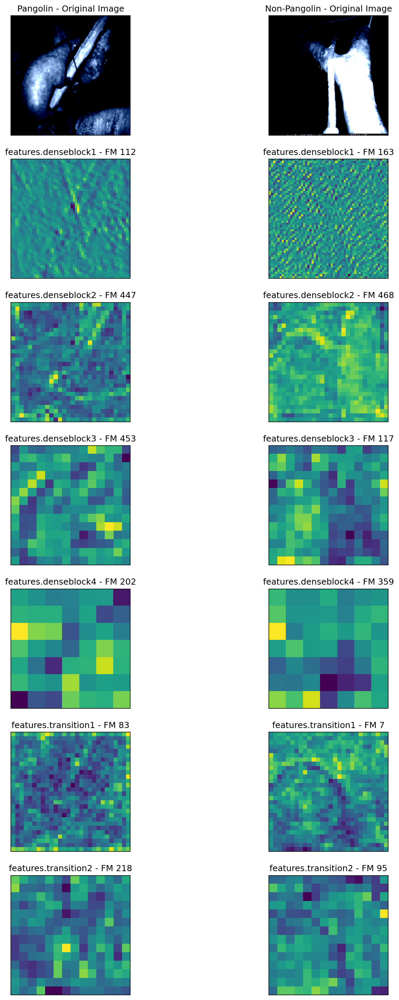

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6458, Validation Loss: 0.6148
Training Per-Species Metrics:
Precision: 0.6860, Recall: 0.8820, F1: 0.7717
Species 1 - Accuracy: 0.6418, Precision: 0.3091, Recall: 0.1156, F1: 0.1683
Training Overall Accuracy: 0.6418, Precision: 0.4975, Recall: 0.4988, F1: 0.4700
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 157.33722281455994





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

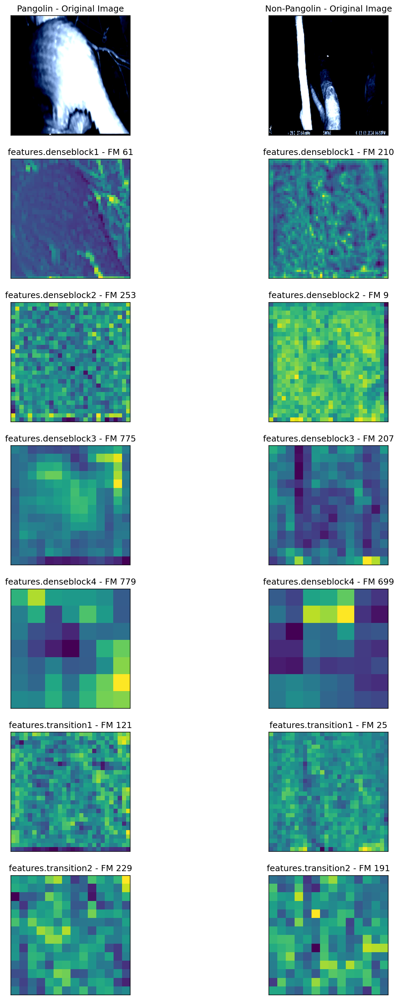

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6147995293140411
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5206, Validation Loss: 0.5144
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 154.3284411430359





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clippin

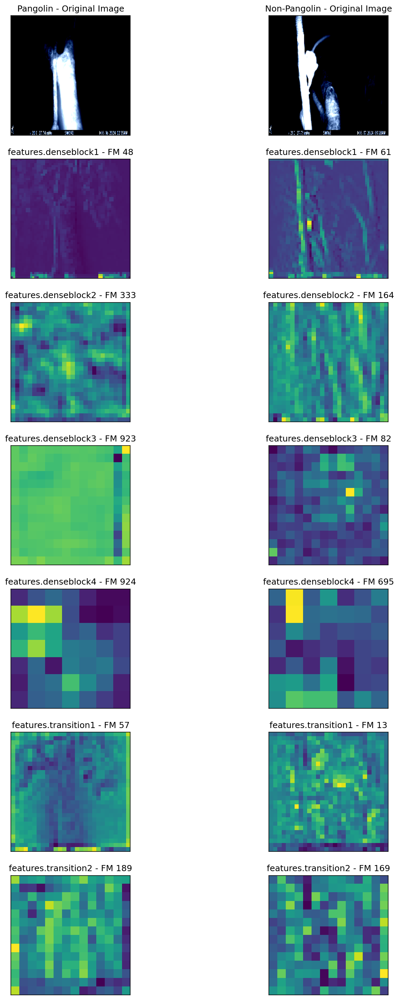

0.5144029408693314
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.4252, Validation Loss: 0.4248
Training Per-Species Metrics:
Precision: 0.7102, Recall: 0.9969, F1: 0.8295
Species 1 - Accuracy: 0.7186, Precision: 0.9412, Recall: 0.1088, F1: 0.1951
Training Overall Accuracy: 0.7186, Precision: 0.8257, Recall: 0.5529, F1: 0.5123
Validation Overall Accuracy: 0.7547, Precision: 0.8673, Recall: 0.6176, F1: 0.6140
Epoch time 152.73419499397278





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

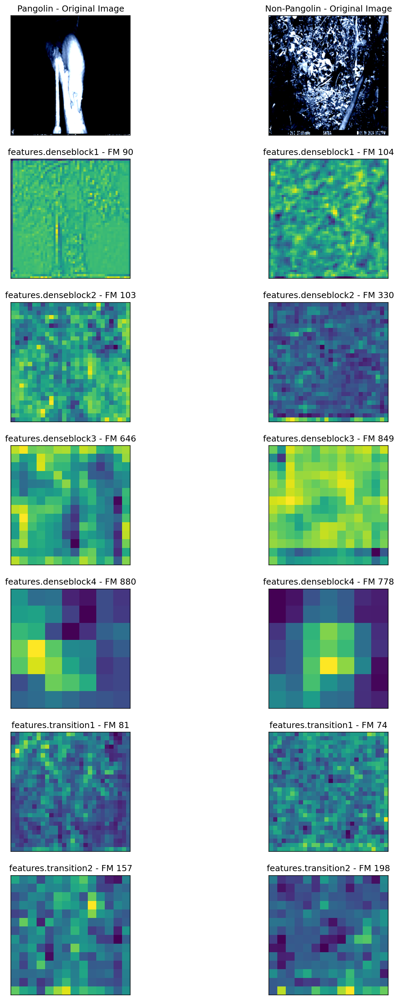

0.4248092323541641
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.3502, Validation Loss: 0.3588
Training Per-Species Metrics:
Precision: 0.8368, Recall: 0.9876, F1: 0.9060
Species 1 - Accuracy: 0.8593, Precision: 0.9551, Recall: 0.5782, F1: 0.7203
Training Overall Accuracy: 0.8593, Precision: 0.8959, Recall: 0.7829, F1: 0.8132
Validation Overall Accuracy: 0.7736, Precision: 0.8750, Recall: 0.6471, F1: 0.6558
Epoch time 154.6457917690277





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clippin

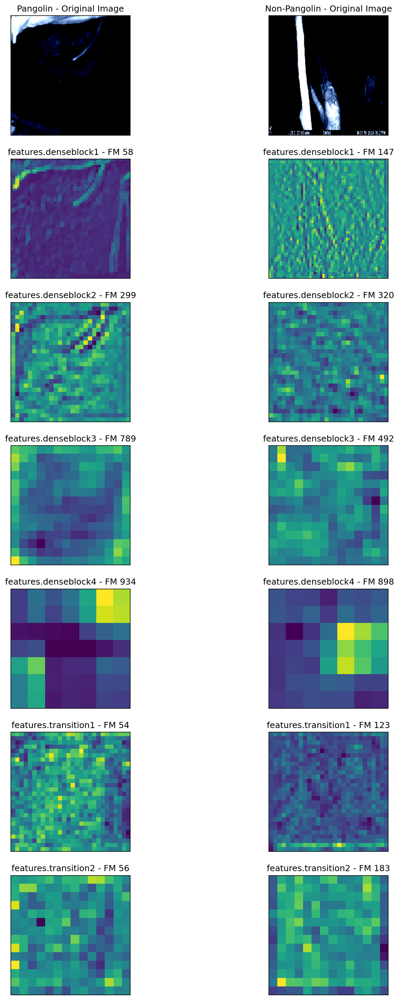

0.35879333317279816
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.2881, Validation Loss: 0.2806
Training Per-Species Metrics:
Precision: 0.9072, Recall: 0.9720, F1: 0.9385
Species 1 - Accuracy: 0.9126, Precision: 0.9274, Recall: 0.7823, F1: 0.8487
Training Overall Accuracy: 0.9126, Precision: 0.9173, Recall: 0.8772, F1: 0.8936
Validation Overall Accuracy: 0.9245, Precision: 0.9272, Recall: 0.8979, F1: 0.9105
Epoch time 151.2047209739685





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5870366..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5870366..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5870366..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clip

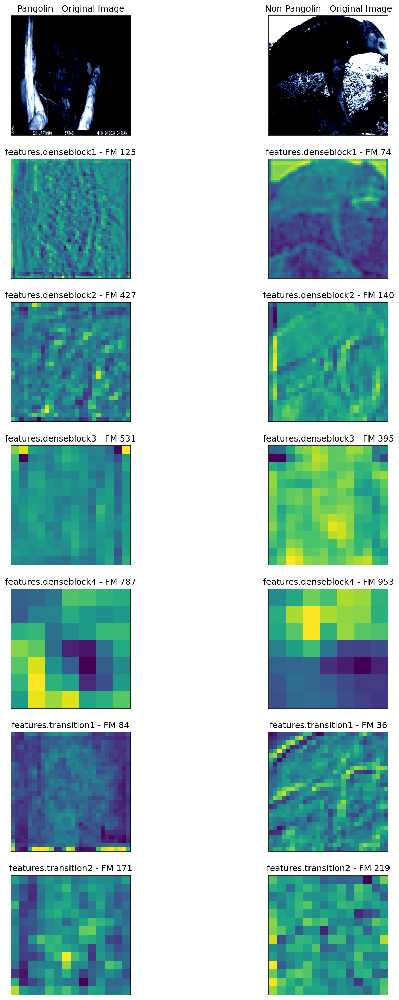

0.2805924788117409
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.2346, Validation Loss: 0.2302
Training Per-Species Metrics:
Precision: 0.9873, Recall: 0.9689, F1: 0.9781
Species 1 - Accuracy: 0.9701, Precision: 0.9346, Recall: 0.9728, F1: 0.9533
Training Overall Accuracy: 0.9701, Precision: 0.9610, Recall: 0.9709, F1: 0.9657
Validation Overall Accuracy: 0.9434, Precision: 0.9417, Recall: 0.9273, F1: 0.9340
Epoch time 150.63654708862305





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

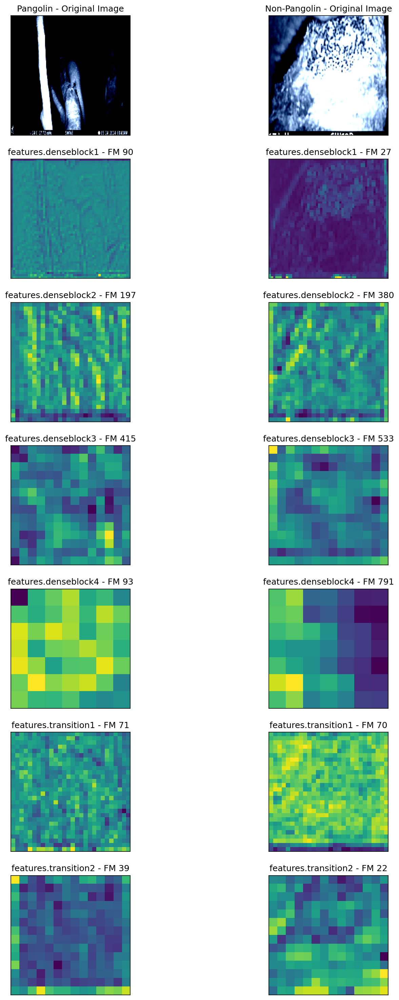

0.2302197366952896
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.1766, Validation Loss: 0.1891
Training Per-Species Metrics:
Precision: 0.9874, Recall: 0.9720, F1: 0.9797
Species 1 - Accuracy: 0.9723, Precision: 0.9408, Recall: 0.9728, F1: 0.9565
Training Overall Accuracy: 0.9723, Precision: 0.9641, Recall: 0.9724, F1: 0.9681
Validation Overall Accuracy: 0.9623, Precision: 0.9567, Recall: 0.9567, F1: 0.9567
Epoch time 154.4299247264862





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

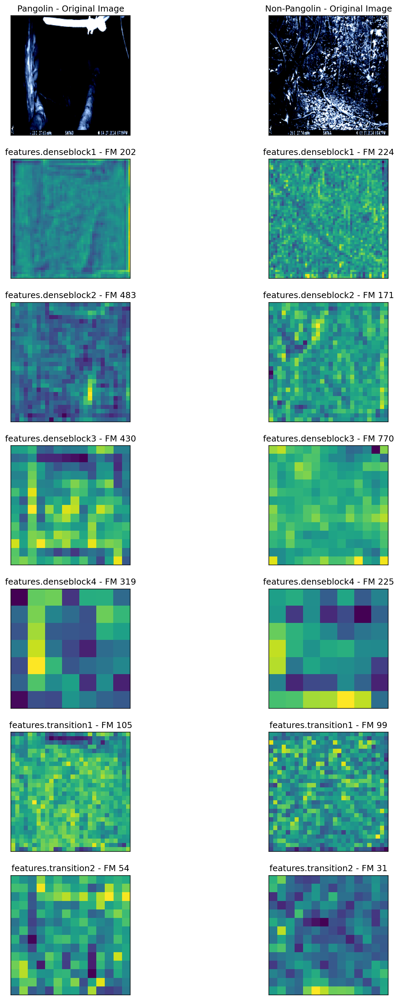

0.18906991183757782
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.1314, Validation Loss: 0.1518
Training Per-Species Metrics:
Precision: 0.9906, Recall: 0.9845, F1: 0.9875
Species 1 - Accuracy: 0.9829, Precision: 0.9664, Recall: 0.9796, F1: 0.9730
Training Overall Accuracy: 0.9829, Precision: 0.9785, Recall: 0.9820, F1: 0.9803
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 150.56152892112732





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

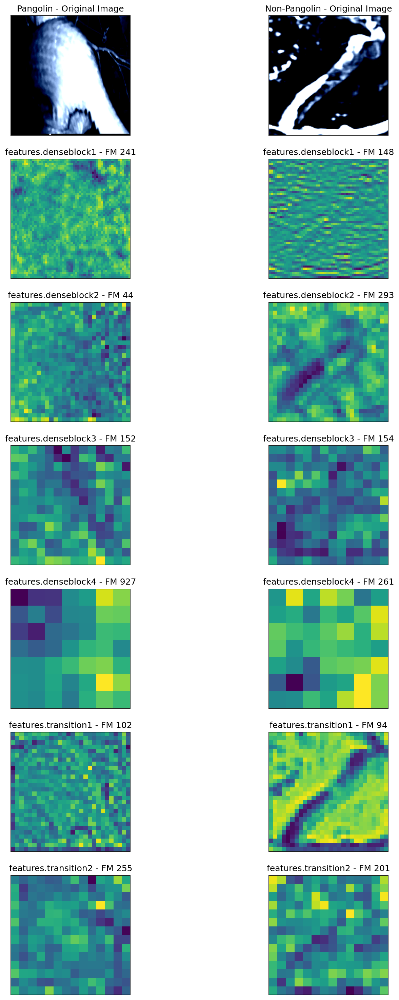

0.1517694592475891
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.1022, Validation Loss: 0.1162
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9907, F1: 0.9953
Species 1 - Accuracy: 0.9936, Precision: 0.9800, Recall: 1.0000, F1: 0.9899
Training Overall Accuracy: 0.9936, Precision: 0.9900, Recall: 0.9953, F1: 0.9926
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 157.82226610183716





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.1

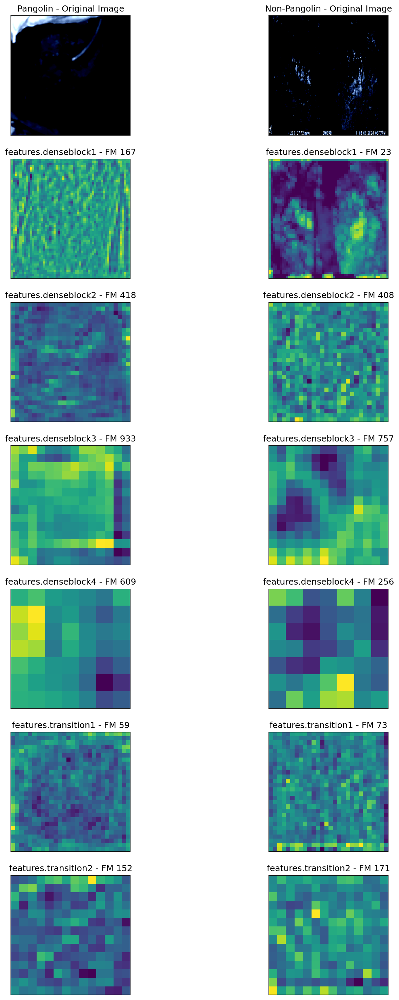

0.11616856977343559
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.0738, Validation Loss: 0.1099
Training Per-Species Metrics:
Precision: 0.9969, Recall: 0.9969, F1: 0.9969
Species 1 - Accuracy: 0.9957, Precision: 0.9932, Recall: 0.9932, F1: 0.9932
Training Overall Accuracy: 0.9957, Precision: 0.9950, Recall: 0.9950, F1: 0.9950
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 165.01792120933533





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Cli

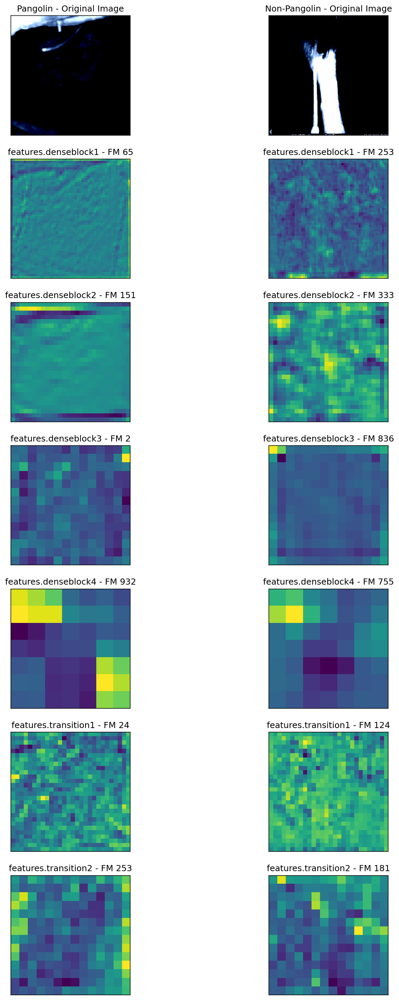

0.10990996658802032
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.0524, Validation Loss: 0.0821
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9969, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 0.9932, Recall: 1.0000, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9966, Recall: 0.9984, F1: 0.9975
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 165.11451506614685





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

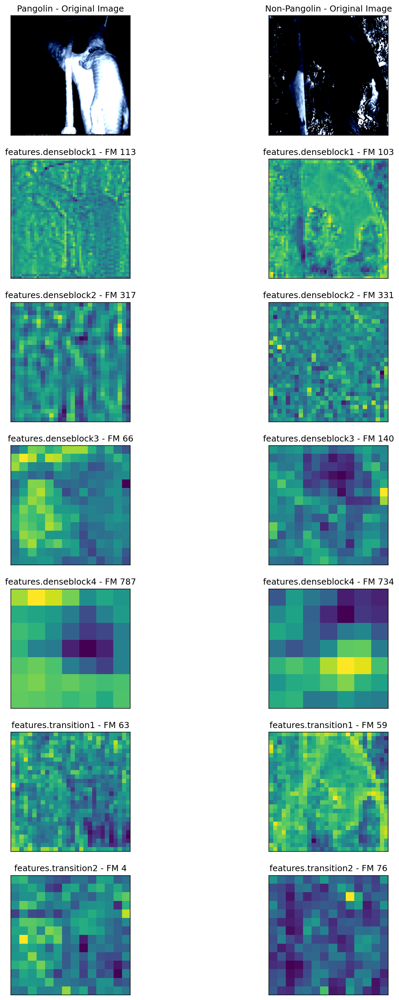

0.08212432637810707
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.0395, Validation Loss: 0.0667
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 164.67509603500366





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

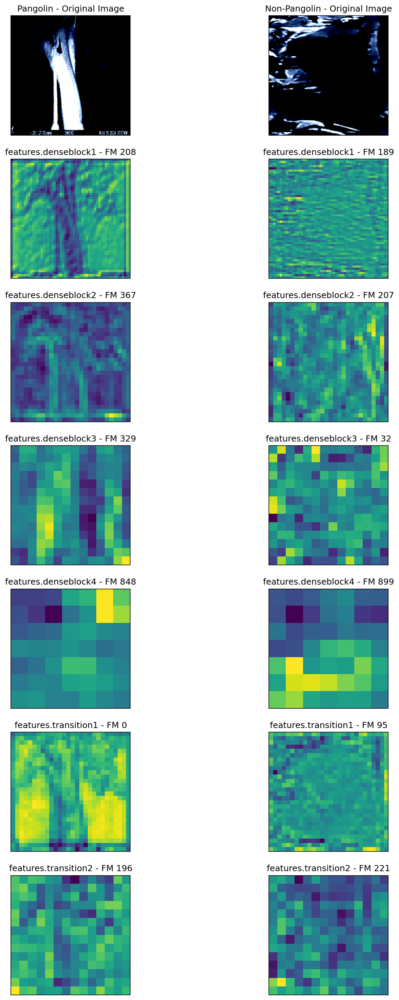

0.06674306094646454
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.0294, Validation Loss: 0.0620
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 164.34642100334167





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].
Clip

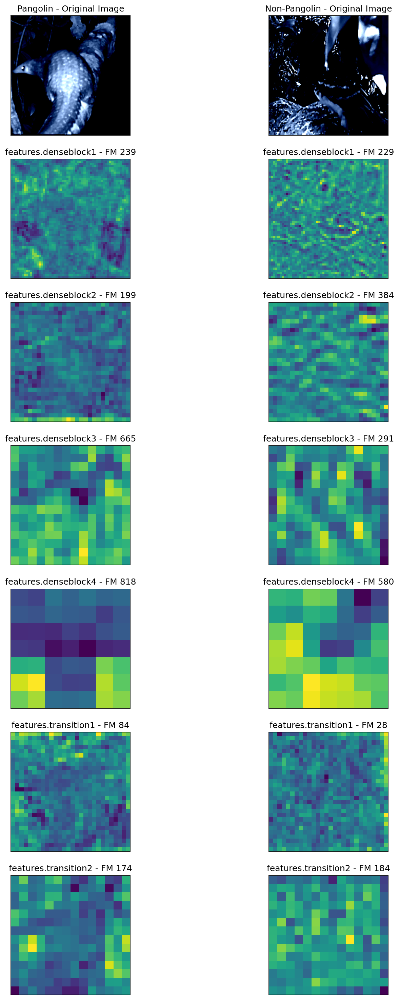

0.06197968125343323
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.0224, Validation Loss: 0.0575
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 164.62177300453186





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4842881..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4842881..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4842881..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].


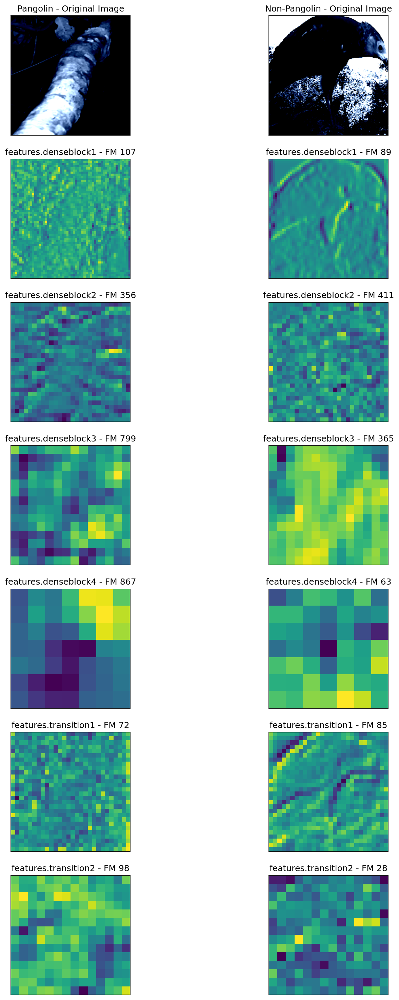

Epoch [15/15], Train Loss: 0.0210, Validation Loss: 0.0597
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 166.96329808235168



Test Metrics - Accuracy: 0.9618, Precision: 0.8936, Recall: 1.0000, F1: 0.9438, AUC: 0.9984
Test Per-Species Metrics:
Precision: 1.0000, Recall: 0.9438, F1: 0.9711
Species 1 - Accuracy: 0.9618, Precision: 0.8936, Recall: 1.0000, F1: 0.9438
Fold 2/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-

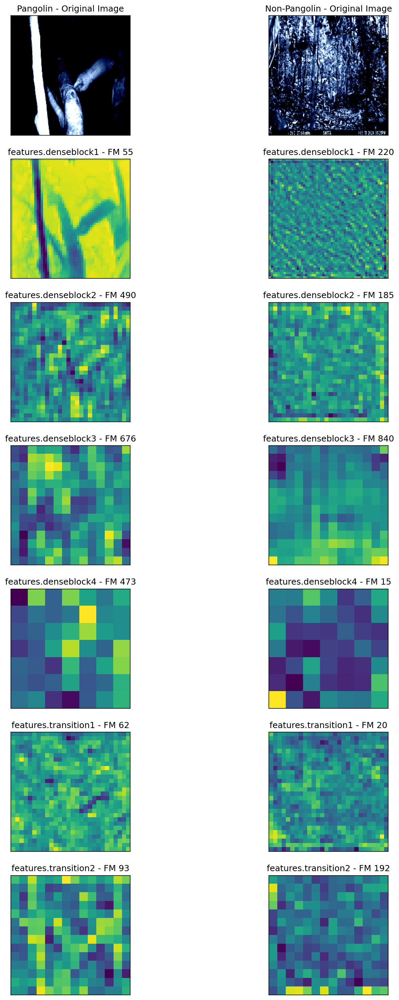

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6693, Validation Loss: 0.6164
Training Per-Species Metrics:
Precision: 0.6577, Recall: 0.7601, F1: 0.7052
Species 1 - Accuracy: 0.5650, Precision: 0.2143, Recall: 0.1419, F1: 0.1707
Training Overall Accuracy: 0.5650, Precision: 0.4360, Recall: 0.4510, F1: 0.4380
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 162.84579920768738





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

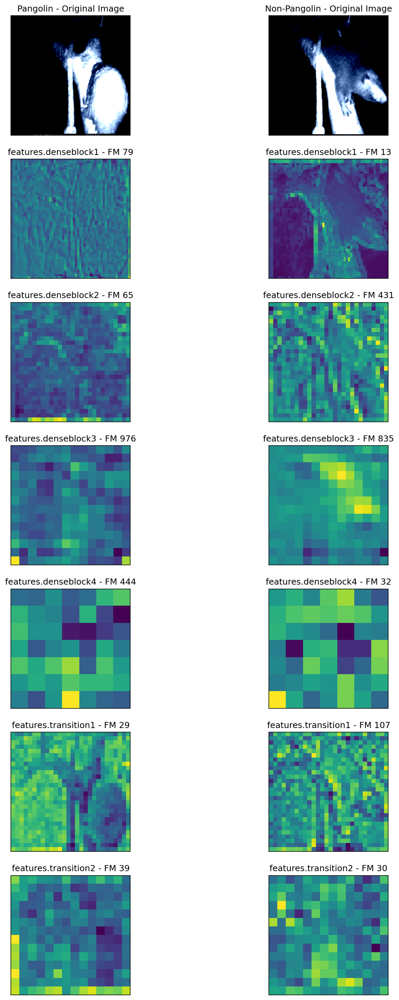

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.616445392370224
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5528, Validation Loss: 0.5206
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 162.9196228981018





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

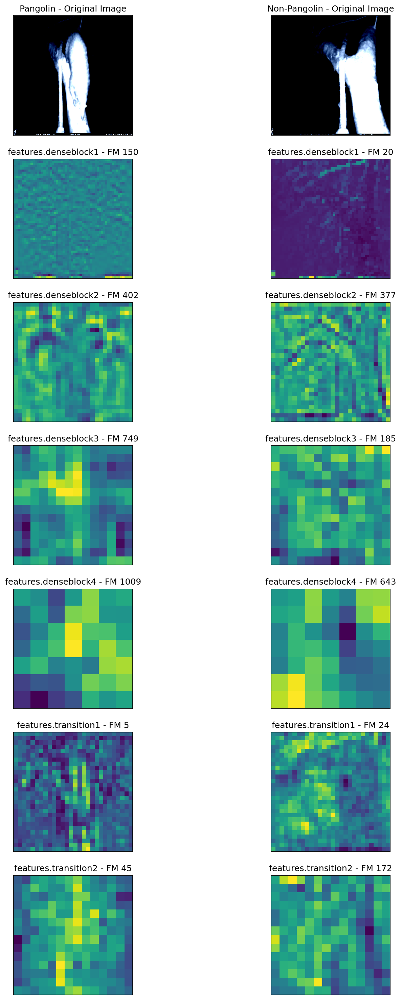

0.5205907225608826
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.4709, Validation Loss: 0.4246
Training Per-Species Metrics:
Precision: 0.7166, Recall: 0.9844, F1: 0.8294
Species 1 - Accuracy: 0.7228, Precision: 0.8214, Recall: 0.1554, F1: 0.2614
Training Overall Accuracy: 0.7228, Precision: 0.7690, Recall: 0.5699, F1: 0.5454
Validation Overall Accuracy: 0.7547, Precision: 0.8673, Recall: 0.6176, F1: 0.6140
Epoch time 164.74548029899597





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

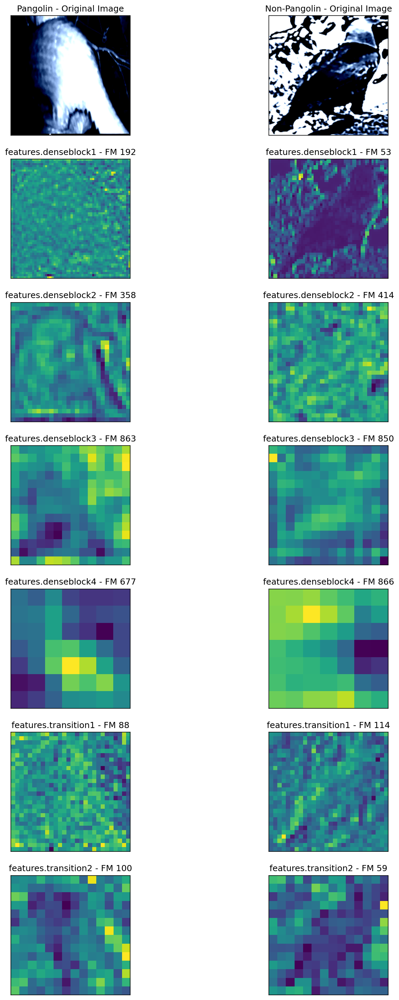

0.42458561062812805
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.3934, Validation Loss: 0.3300
Training Per-Species Metrics:
Precision: 0.8384, Recall: 0.9377, F1: 0.8853
Species 1 - Accuracy: 0.8337, Precision: 0.8182, Recall: 0.6081, F1: 0.6977
Training Overall Accuracy: 0.8337, Precision: 0.8283, Recall: 0.7729, F1: 0.7915
Validation Overall Accuracy: 0.8868, Precision: 0.9286, Recall: 0.8235, F1: 0.8544
Epoch time 167.54183292388916





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

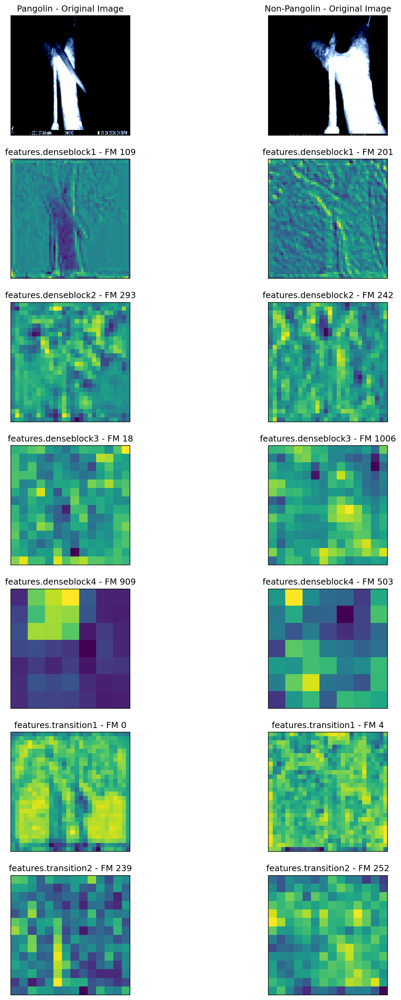

0.3299596905708313
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.3166, Validation Loss: 0.2593
Training Per-Species Metrics:
Precision: 0.8754, Recall: 0.9626, F1: 0.9169
Species 1 - Accuracy: 0.8806, Precision: 0.8966, Recall: 0.7027, F1: 0.7879
Training Overall Accuracy: 0.8806, Precision: 0.8860, Recall: 0.8327, F1: 0.8524
Validation Overall Accuracy: 0.9057, Precision: 0.9390, Recall: 0.8529, F1: 0.8813
Epoch time 164.32272100448608





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping inp

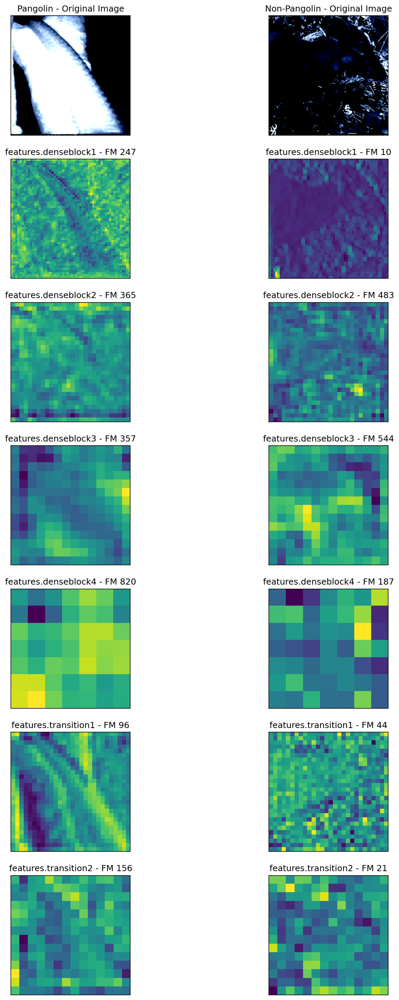

0.2592964768409729
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.2482, Validation Loss: 0.1933
Training Per-Species Metrics:
Precision: 0.9401, Recall: 0.9782, F1: 0.9588
Species 1 - Accuracy: 0.9424, Precision: 0.9481, Recall: 0.8649, F1: 0.9046
Training Overall Accuracy: 0.9424, Precision: 0.9441, Recall: 0.9215, F1: 0.9317
Validation Overall Accuracy: 0.9434, Precision: 0.9615, Recall: 0.9118, F1: 0.9316
Epoch time 165.64736199378967





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6897851..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6897851..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6897851..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6897851..2.5005665].
Cli

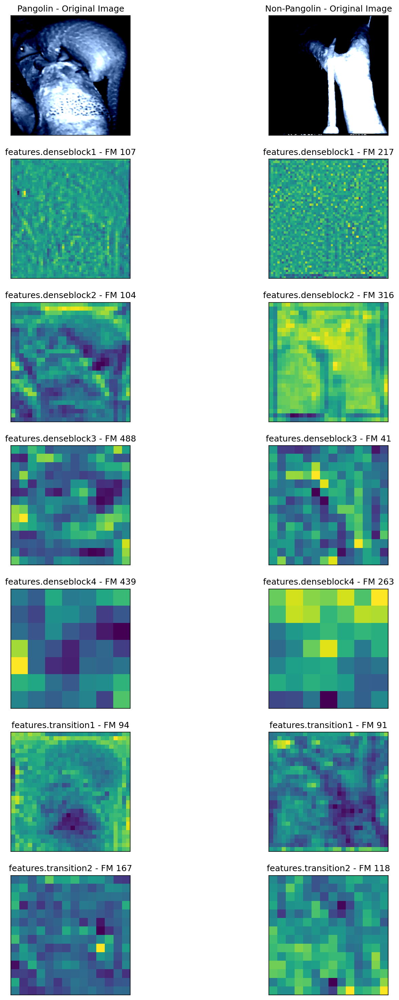

0.19331414252519608
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.2122, Validation Loss: 0.1273
Training Per-Species Metrics:
Precision: 0.9565, Recall: 0.9595, F1: 0.9580
Species 1 - Accuracy: 0.9424, Precision: 0.9116, Recall: 0.9054, F1: 0.9085
Training Overall Accuracy: 0.9424, Precision: 0.9340, Recall: 0.9325, F1: 0.9332
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 159.5419499874115





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clip

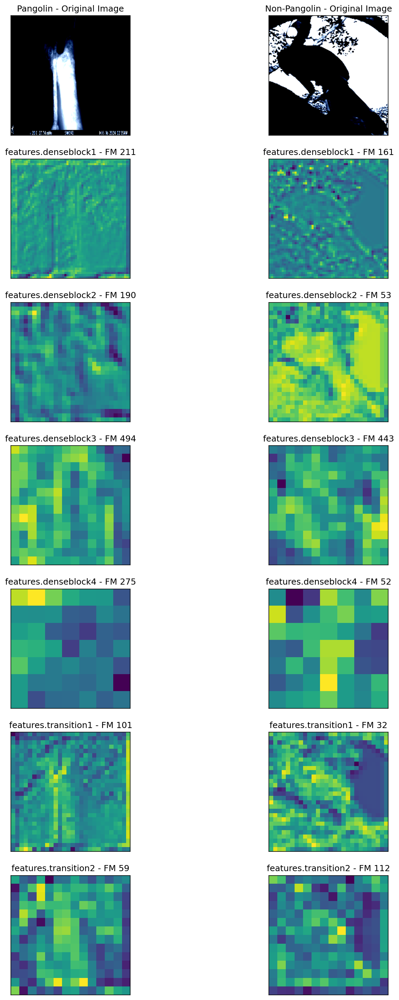

0.12733561918139458
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.1408, Validation Loss: 0.0923
Training Per-Species Metrics:
Precision: 0.9875, Recall: 0.9844, F1: 0.9860
Species 1 - Accuracy: 0.9808, Precision: 0.9664, Recall: 0.9730, F1: 0.9697
Training Overall Accuracy: 0.9808, Precision: 0.9770, Recall: 0.9787, F1: 0.9778
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 151.41562581062317





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

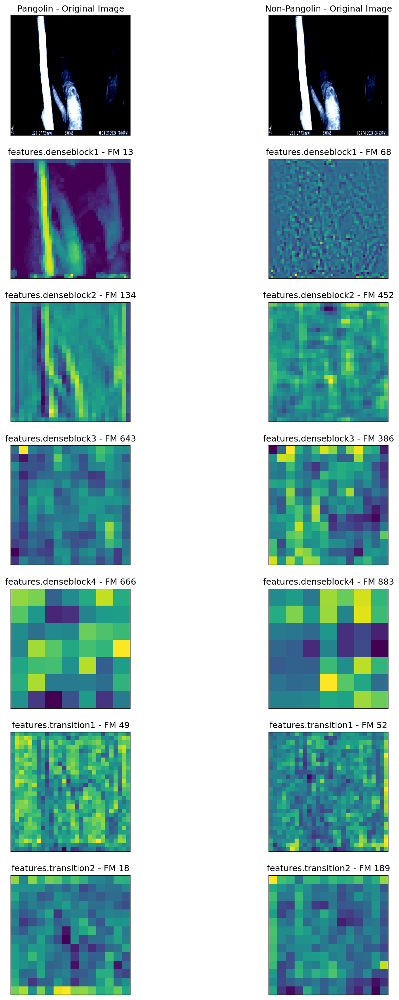

0.0922834500670433
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.1106, Validation Loss: 0.0688
Training Per-Species Metrics:
Precision: 0.9875, Recall: 0.9844, F1: 0.9860
Species 1 - Accuracy: 0.9808, Precision: 0.9664, Recall: 0.9730, F1: 0.9697
Training Overall Accuracy: 0.9808, Precision: 0.9770, Recall: 0.9787, F1: 0.9778
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 153.677405834198





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

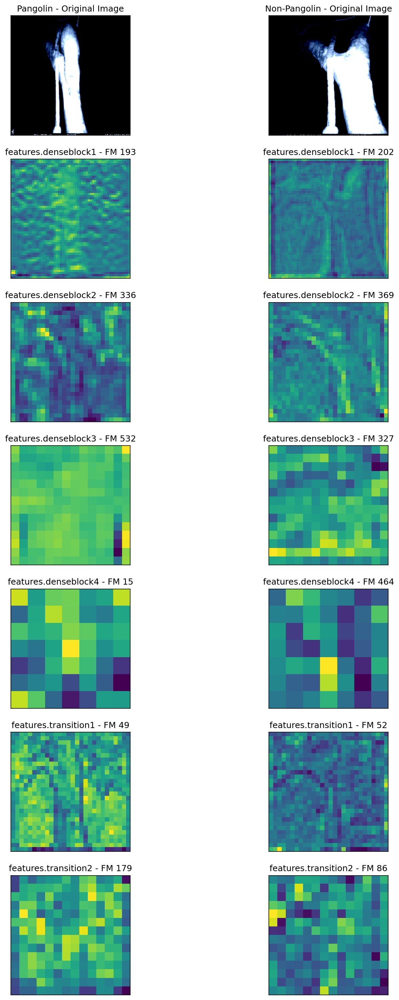

0.06875627674162388
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.0749, Validation Loss: 0.0469
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9938, F1: 0.9969
Species 1 - Accuracy: 0.9957, Precision: 0.9867, Recall: 1.0000, F1: 0.9933
Training Overall Accuracy: 0.9957, Precision: 0.9933, Recall: 0.9969, F1: 0.9951
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 151.22422623634338





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.929531

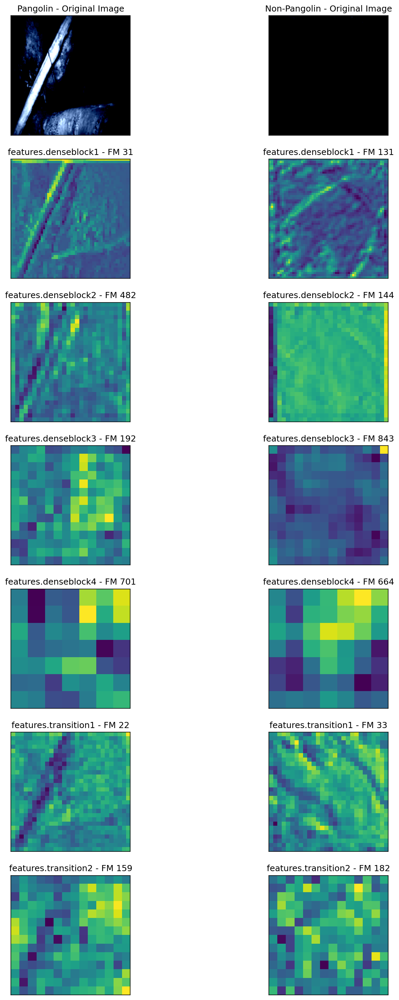

0.04694623872637749
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.0519, Validation Loss: 0.0366
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9969, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 0.9933, Recall: 1.0000, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9966, Recall: 0.9984, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 153.34180307388306





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..0.18248373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..0.18248373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..0.18248373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..

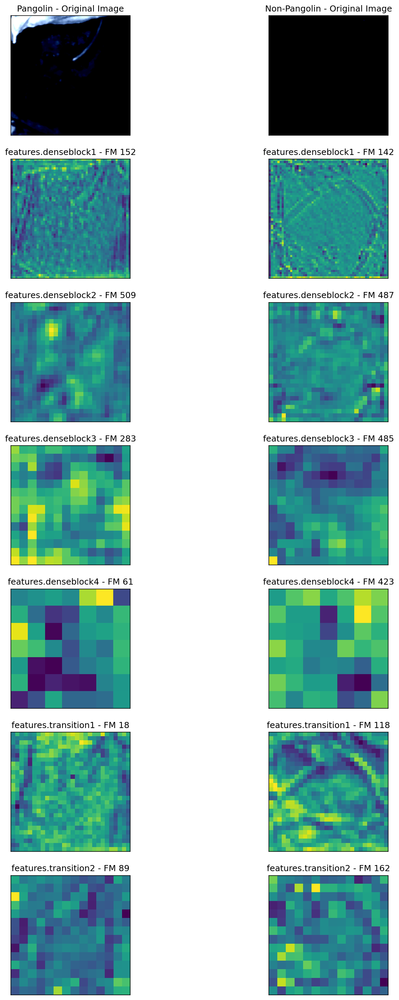

0.03656058758497238
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.0447, Validation Loss: 0.0281
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9969, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 0.9933, Recall: 1.0000, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9966, Recall: 0.9984, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 149.92203879356384





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

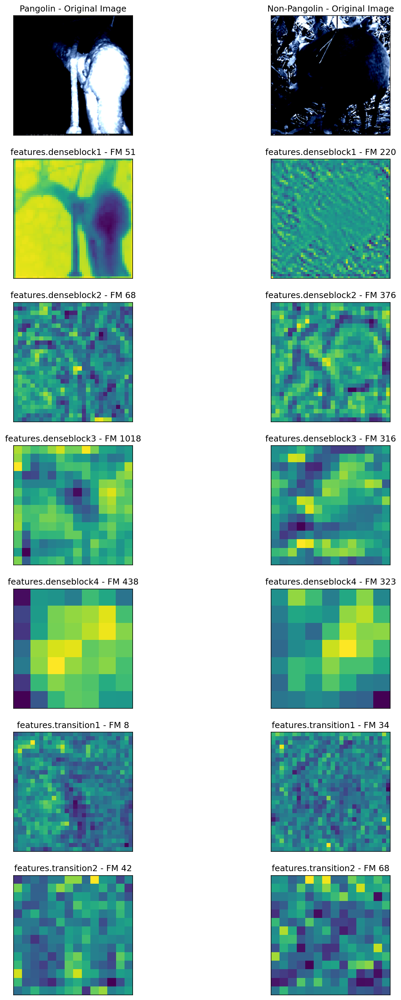

Epoch [13/15], Train Loss: 0.0408, Validation Loss: 0.0290
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 150.03923916816711





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

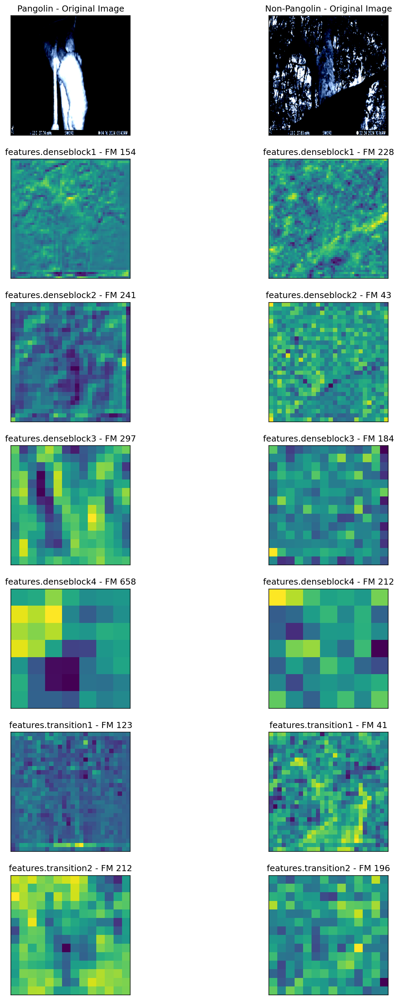

0.028121440671384335
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.0390, Validation Loss: 0.0189
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 150.5942931175232





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

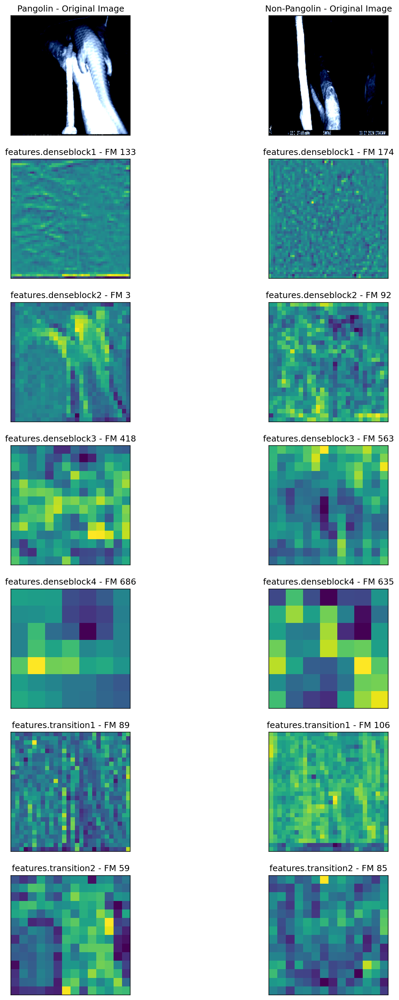

0.018940906040370464
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.0308, Validation Loss: 0.0171
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 151.30180621147156



Test Metrics - Accuracy: 0.9847, Precision: 0.9756, Recall: 0.9756, F1: 0.9756, AUC: 0.9986
Test Per-Species Metrics:
Precision: 0.9889, Recall: 0.9889, F1: 0.9889
Species 1 - Accuracy: 0.9847, Precision: 0.9756, Recall: 0.9756, F1: 0.9756
Fold 3/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got ra

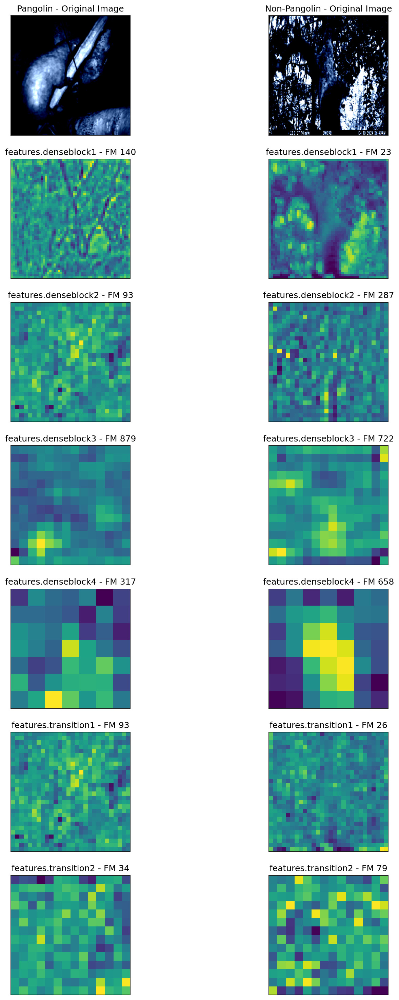

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6256, Validation Loss: 0.5970
Training Per-Species Metrics:
Precision: 0.6831, Recall: 0.9938, F1: 0.8096
Species 1 - Accuracy: 0.6802, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6802, Precision: 0.3415, Recall: 0.4969, F1: 0.4048
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.96758699417114





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

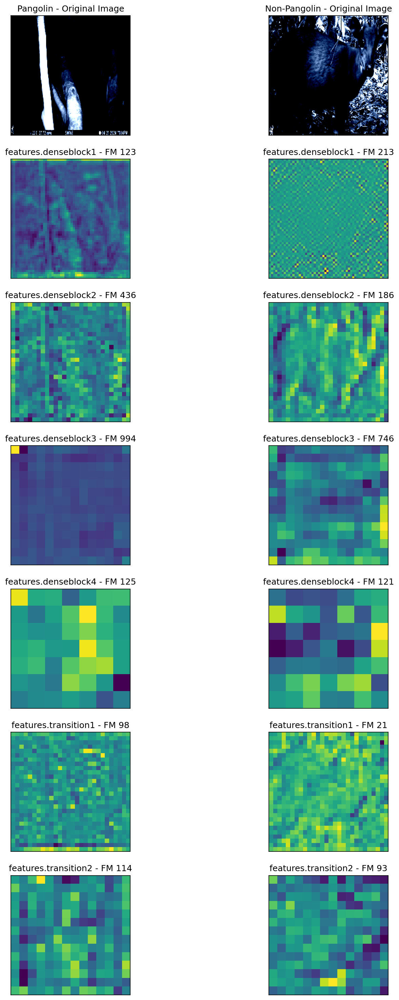

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.596964031457901
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5196, Validation Loss: 0.4891
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.81243991851807





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Cli

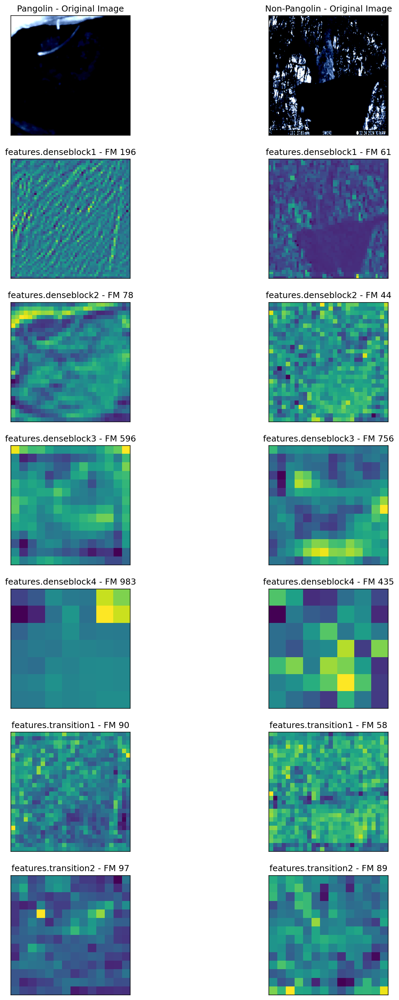

0.48914267122745514
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.4273, Validation Loss: 0.3909
Training Per-Species Metrics:
Precision: 0.7483, Recall: 1.0000, F1: 0.8560
Species 1 - Accuracy: 0.7697, Precision: 1.0000, Recall: 0.2703, F1: 0.4255
Training Overall Accuracy: 0.7697, Precision: 0.8741, Recall: 0.6351, F1: 0.6408
Validation Overall Accuracy: 0.8868, Precision: 0.9286, Recall: 0.8235, F1: 0.8544
Epoch time 151.6448519229889





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..

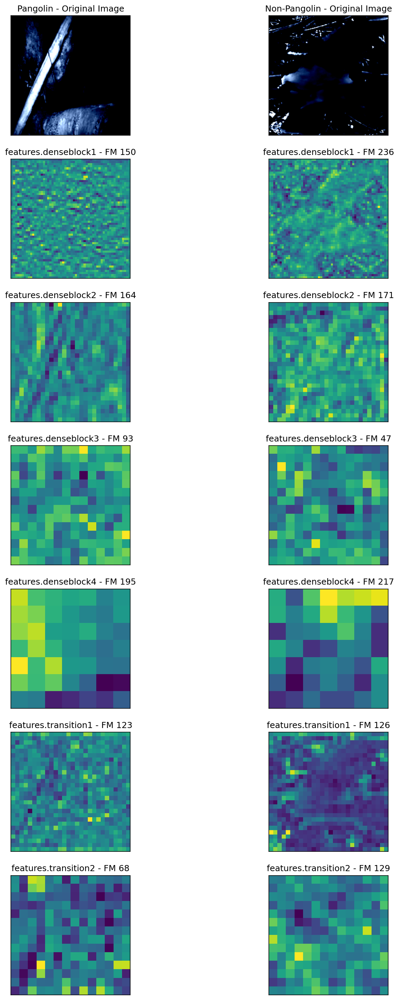

0.3909481316804886
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.3401, Validation Loss: 0.2937
Training Per-Species Metrics:
Precision: 0.8852, Recall: 0.9844, F1: 0.9322
Species 1 - Accuracy: 0.9019, Precision: 0.9554, Recall: 0.7230, F1: 0.8231
Training Overall Accuracy: 0.9019, Precision: 0.9203, Recall: 0.8537, F1: 0.8776
Validation Overall Accuracy: 0.9623, Precision: 0.9737, Recall: 0.9412, F1: 0.9552
Epoch time 149.79734230041504





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clippin

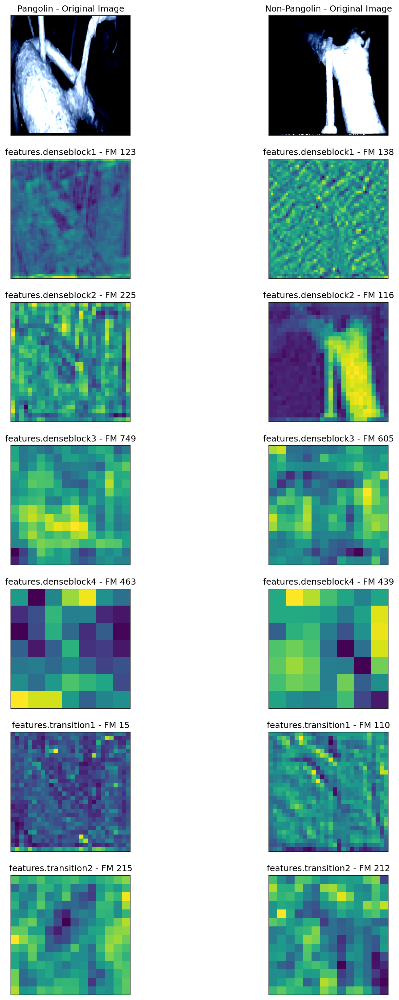

0.2937372401356697
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.2712, Validation Loss: 0.2312
Training Per-Species Metrics:
Precision: 0.9405, Recall: 0.9844, F1: 0.9619
Species 1 - Accuracy: 0.9467, Precision: 0.9624, Recall: 0.8649, F1: 0.9110
Training Overall Accuracy: 0.9467, Precision: 0.9514, Recall: 0.9246, F1: 0.9365
Validation Overall Accuracy: 0.9811, Precision: 0.9865, Recall: 0.9706, F1: 0.9780
Epoch time 148.34700798988342





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

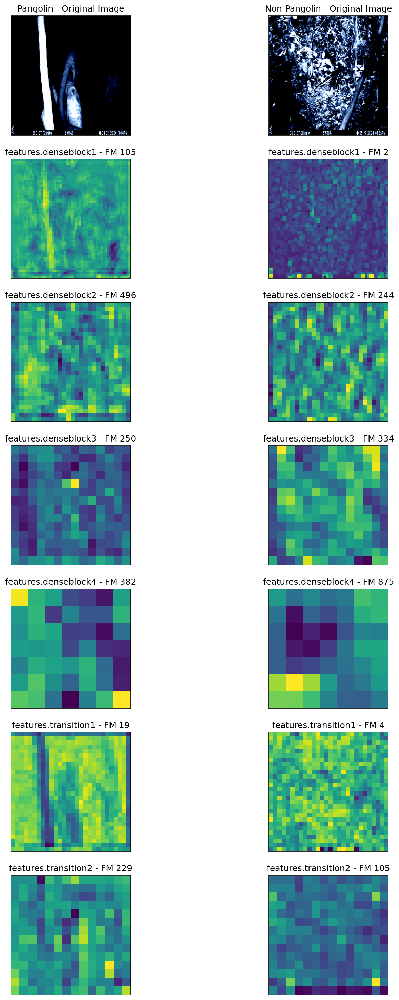

0.23122631758451462
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.2087, Validation Loss: 0.1780
Training Per-Species Metrics:
Precision: 0.9812, Recall: 0.9751, F1: 0.9781
Species 1 - Accuracy: 0.9701, Precision: 0.9467, Recall: 0.9595, F1: 0.9530
Training Overall Accuracy: 0.9701, Precision: 0.9639, Recall: 0.9673, F1: 0.9656
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 148.93074798583984





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

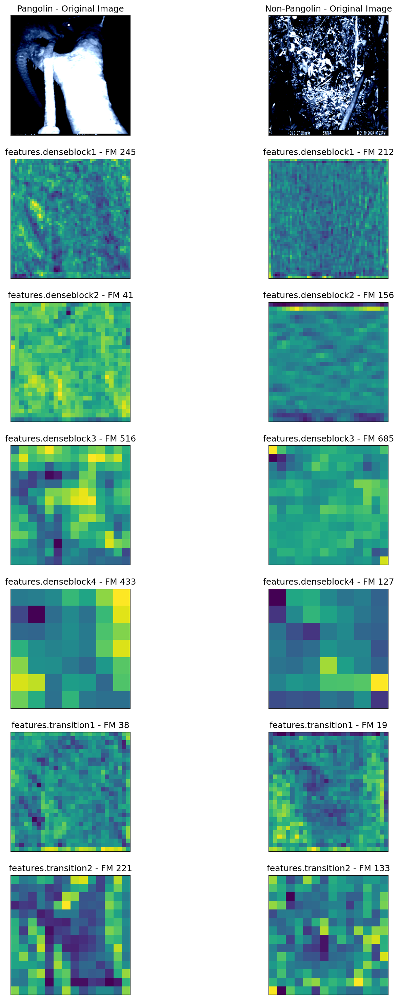

0.17797981947660446
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.1496, Validation Loss: 0.1347
Training Per-Species Metrics:
Precision: 0.9875, Recall: 0.9844, F1: 0.9860
Species 1 - Accuracy: 0.9808, Precision: 0.9664, Recall: 0.9730, F1: 0.9697
Training Overall Accuracy: 0.9808, Precision: 0.9770, Recall: 0.9787, F1: 0.9778
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 148.60419821739197





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

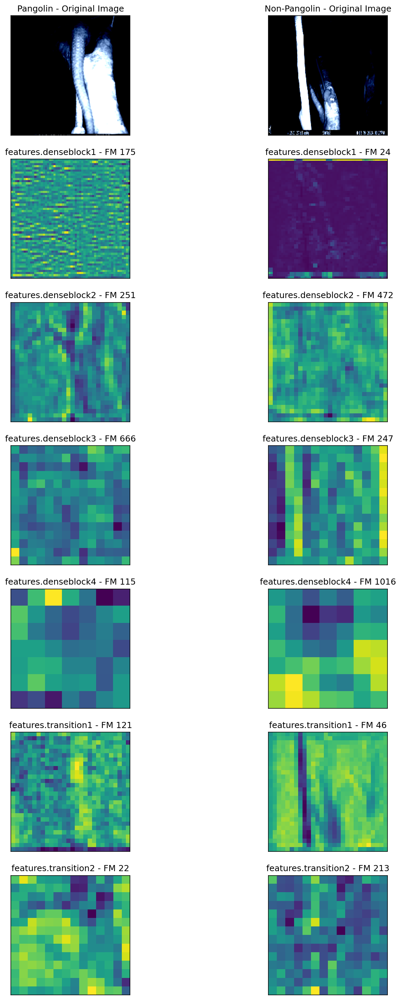

0.13466961681842804
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.1253, Validation Loss: 0.1091
Training Per-Species Metrics:
Precision: 0.9845, Recall: 0.9875, F1: 0.9860
Species 1 - Accuracy: 0.9808, Precision: 0.9728, Recall: 0.9662, F1: 0.9695
Training Overall Accuracy: 0.9808, Precision: 0.9786, Recall: 0.9769, F1: 0.9777
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 148.35932731628418





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

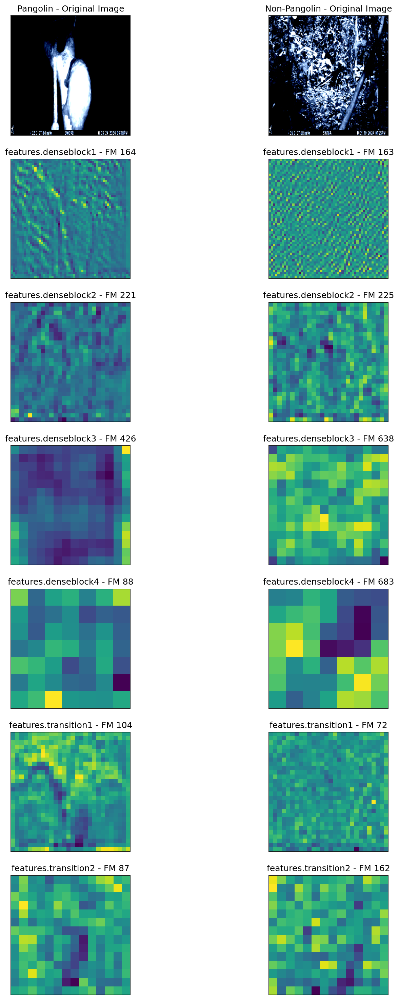

0.1090981550514698
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.0816, Validation Loss: 0.0863
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 148.25673818588257





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.1519828].
Cli

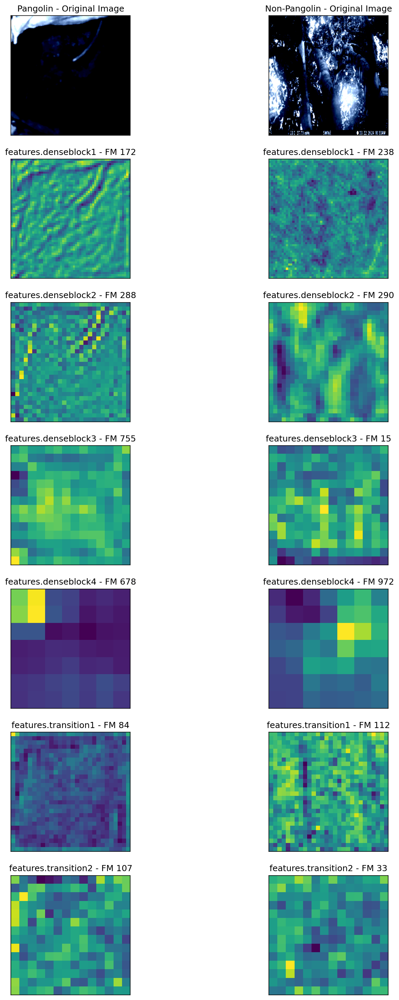

0.0862588919699192
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.0587, Validation Loss: 0.0691
Training Per-Species Metrics:
Precision: 0.9938, Recall: 0.9969, F1: 0.9953
Species 1 - Accuracy: 0.9936, Precision: 0.9932, Recall: 0.9865, F1: 0.9898
Training Overall Accuracy: 0.9936, Precision: 0.9935, Recall: 0.9917, F1: 0.9926
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 148.24671387672424





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clippin

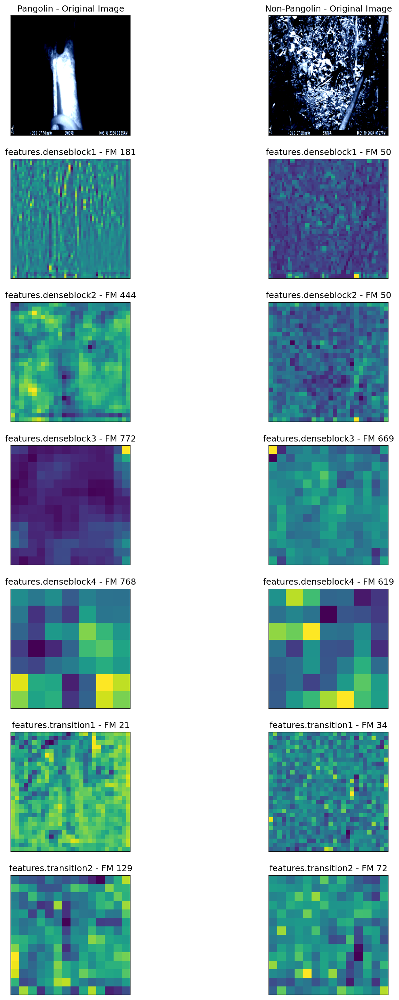

0.06911510415375233
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.0421, Validation Loss: 0.0541
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 147.42260789871216





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

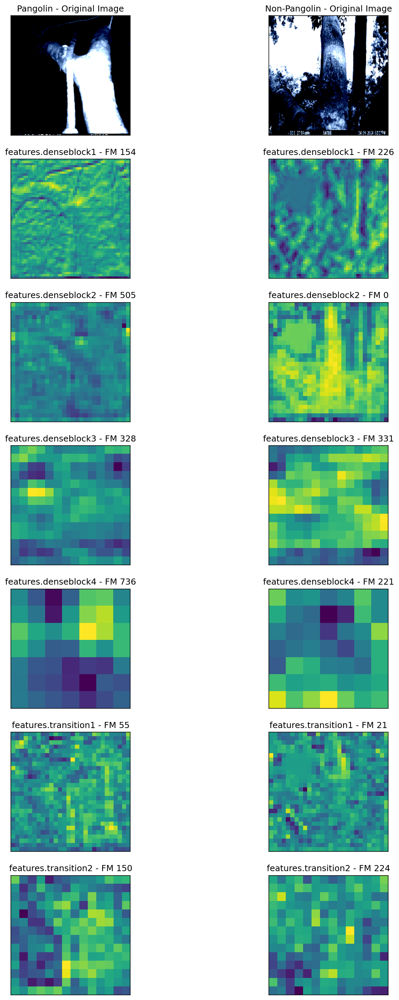

0.054124887101352215
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.0312, Validation Loss: 0.0427
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 147.4668140411377





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.35677567].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.35677567].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..0.35677567].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.64].
Cl

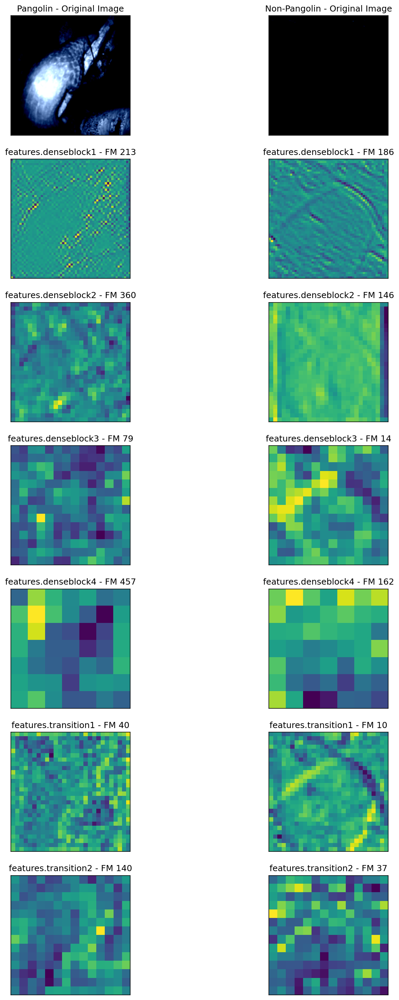

0.042741838842630386
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.0268, Validation Loss: 0.0353
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 147.52586698532104





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

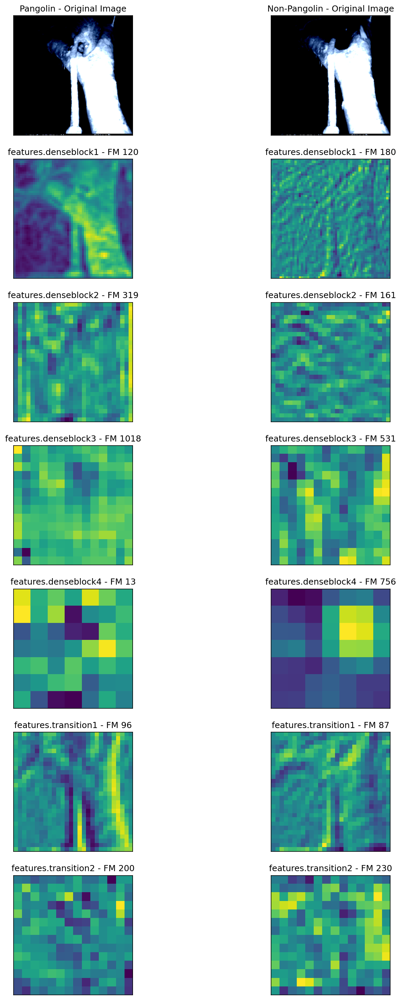

0.03533163480460644
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.0210, Validation Loss: 0.0298
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 147.9440152645111





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

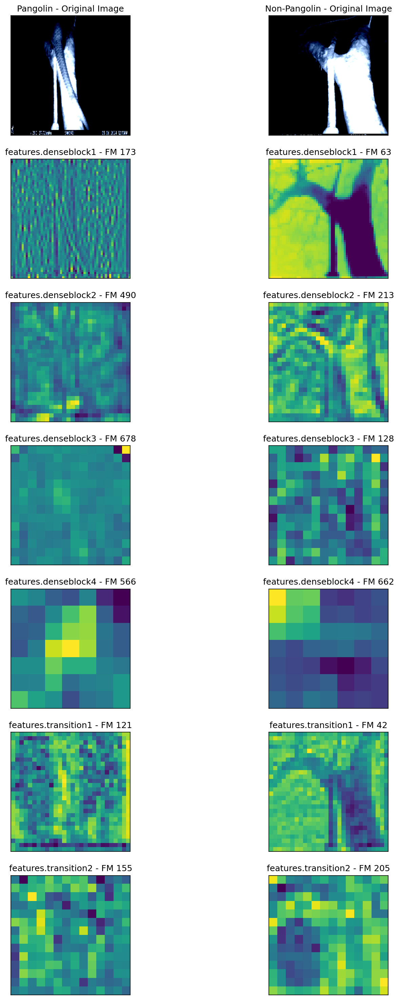

Epoch [15/15], Train Loss: 0.0275, Validation Loss: 0.0315
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9984, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 147.91862392425537



Test Metrics - Accuracy: 0.9847, Precision: 0.9535, Recall: 1.0000, F1: 0.9762, AUC: 1.0000
Test Per-Species Metrics:
Precision: 1.0000, Recall: 0.9778, F1: 0.9888
Species 1 - Accuracy: 0.9847, Precision: 0.9535, Recall: 1.0000, F1: 0.9762
Fold 4/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [

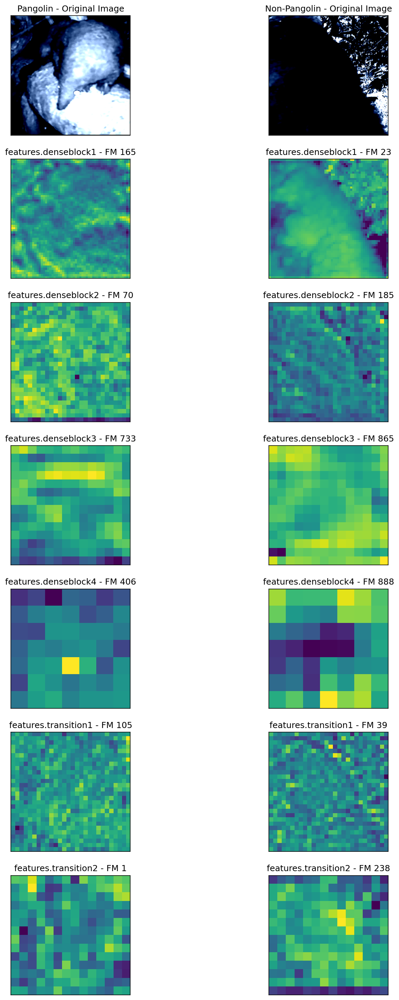

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6281, Validation Loss: 0.6002
Training Per-Species Metrics:
Precision: 0.6847, Recall: 0.9845, F1: 0.8076
Species 1 - Accuracy: 0.6787, Precision: 0.2857, Recall: 0.0135, F1: 0.0258
Training Overall Accuracy: 0.6787, Precision: 0.4852, Recall: 0.4990, F1: 0.4167
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.11147618293762





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

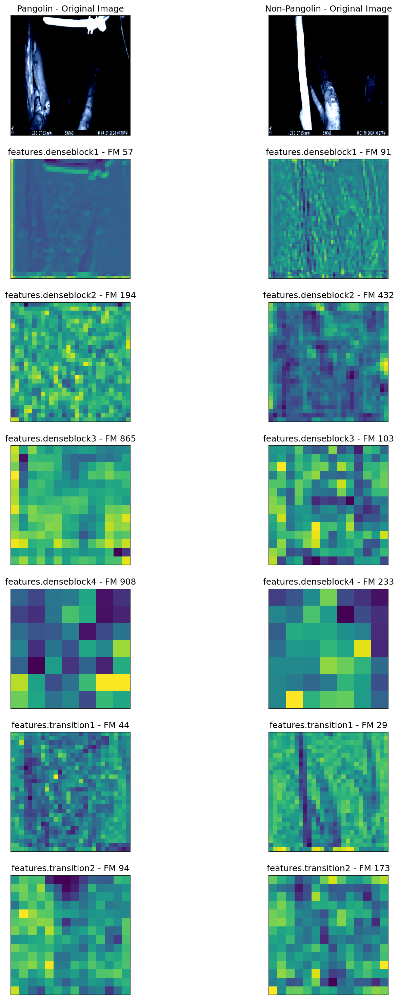

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6002451479434967
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5314, Validation Loss: 0.5182
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 147.81150817871094





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

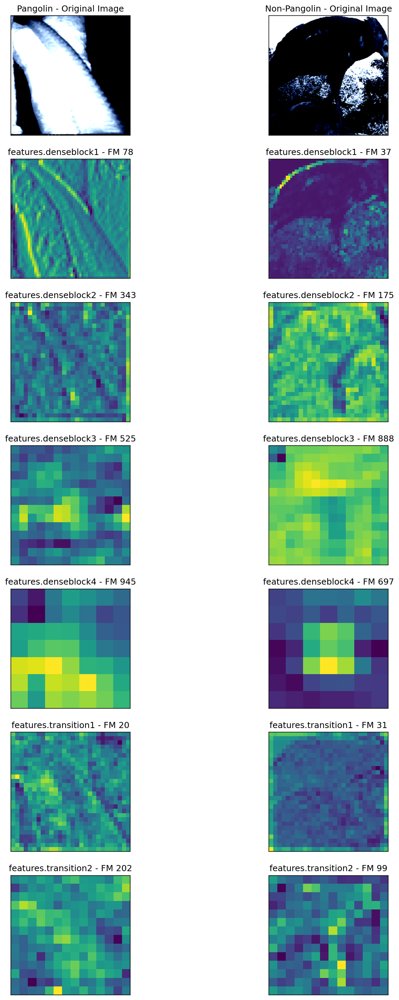

0.5182096660137177
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.4374, Validation Loss: 0.4374
Training Per-Species Metrics:
Precision: 0.7329, Recall: 0.9969, F1: 0.8447
Species 1 - Accuracy: 0.7489, Precision: 0.9688, Recall: 0.2095, F1: 0.3444
Training Overall Accuracy: 0.7489, Precision: 0.8508, Recall: 0.6032, F1: 0.5946
Validation Overall Accuracy: 0.8113, Precision: 0.8139, Recall: 0.7369, F1: 0.7573
Epoch time 148.3585910797119





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clippin

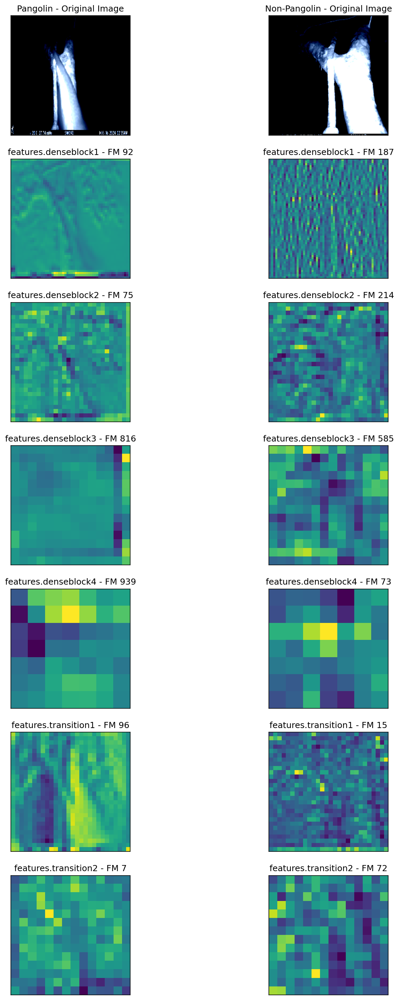

0.4374378174543381
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.3480, Validation Loss: 0.3508
Training Per-Species Metrics:
Precision: 0.8564, Recall: 0.9814, F1: 0.9146
Species 1 - Accuracy: 0.8745, Precision: 0.9406, Recall: 0.6419, F1: 0.7631
Training Overall Accuracy: 0.8745, Precision: 0.8985, Recall: 0.8116, F1: 0.8388
Validation Overall Accuracy: 0.8679, Precision: 0.8522, Recall: 0.8407, F1: 0.8460
Epoch time 149.20782017707825





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping

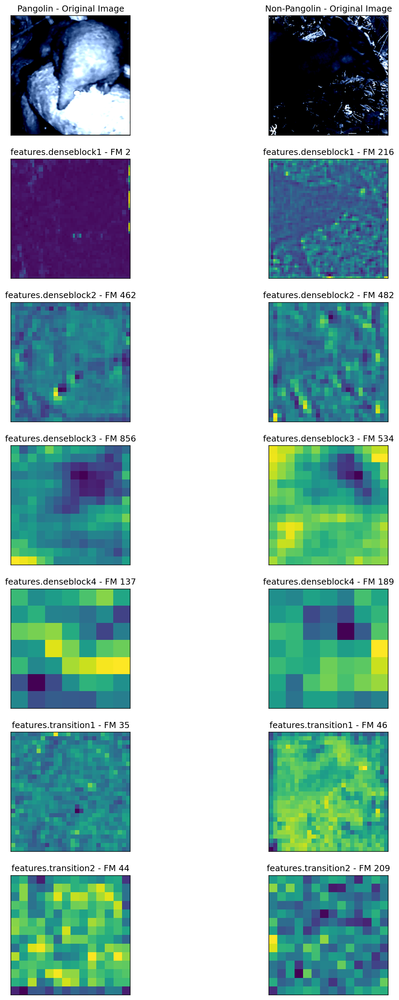

0.35081152617931366
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.2780, Validation Loss: 0.2971
Training Per-Species Metrics:
Precision: 0.9217, Recall: 0.9876, F1: 0.9535
Species 1 - Accuracy: 0.9340, Precision: 0.9680, Recall: 0.8176, F1: 0.8864
Training Overall Accuracy: 0.9340, Precision: 0.9449, Recall: 0.9026, F1: 0.9200
Validation Overall Accuracy: 0.9057, Precision: 0.8881, Recall: 0.8995, F1: 0.8934
Epoch time 148.98072600364685





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping in

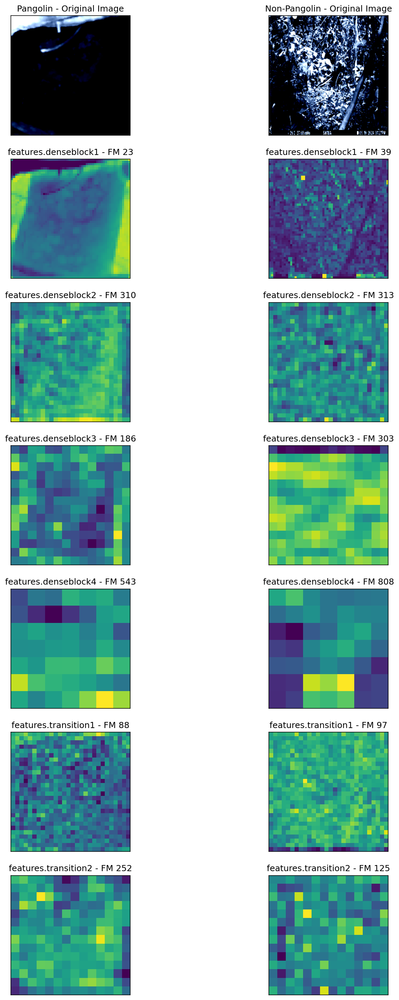

0.29706941545009613
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.2121, Validation Loss: 0.2514
Training Per-Species Metrics:
Precision: 0.9688, Recall: 0.9658, F1: 0.9673
Species 1 - Accuracy: 0.9553, Precision: 0.9262, Recall: 0.9324, F1: 0.9293
Training Overall Accuracy: 0.9553, Precision: 0.9475, Recall: 0.9491, F1: 0.9483
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 174.64019918441772





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.64].
Clipping

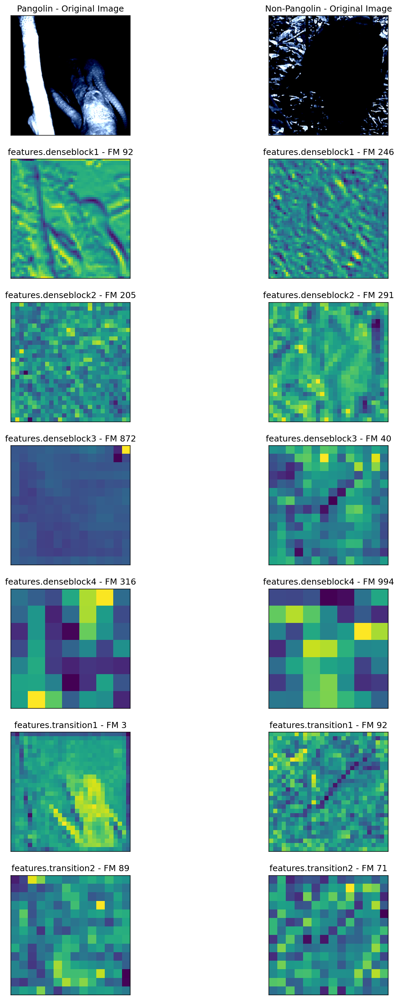

0.2514203116297722
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.1532, Validation Loss: 0.2328
Training Per-Species Metrics:
Precision: 0.9906, Recall: 0.9814, F1: 0.9860
Species 1 - Accuracy: 0.9809, Precision: 0.9603, Recall: 0.9797, F1: 0.9699
Training Overall Accuracy: 0.9809, Precision: 0.9754, Recall: 0.9805, F1: 0.9779
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 174.52232217788696





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clippin

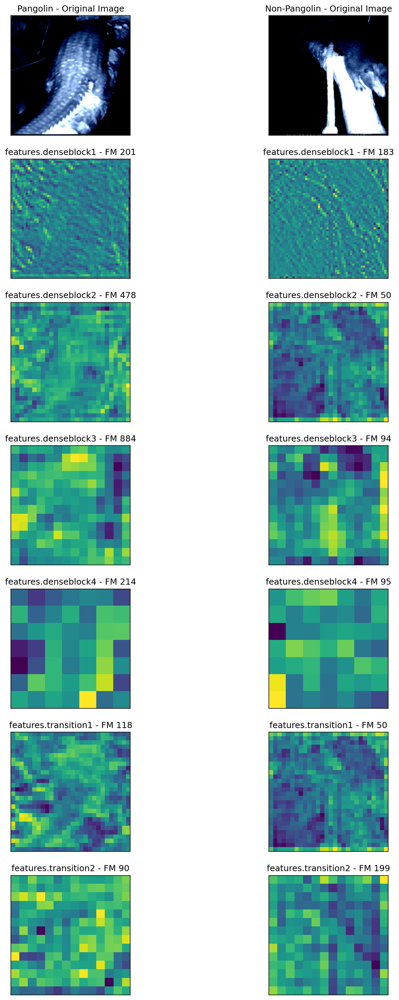

0.23278696835041046
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.1087, Validation Loss: 0.2092
Training Per-Species Metrics:
Precision: 0.9938, Recall: 0.9938, F1: 0.9938
Species 1 - Accuracy: 0.9915, Precision: 0.9865, Recall: 0.9865, F1: 0.9865
Training Overall Accuracy: 0.9915, Precision: 0.9901, Recall: 0.9901, F1: 0.9901
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 172.18419098854065





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

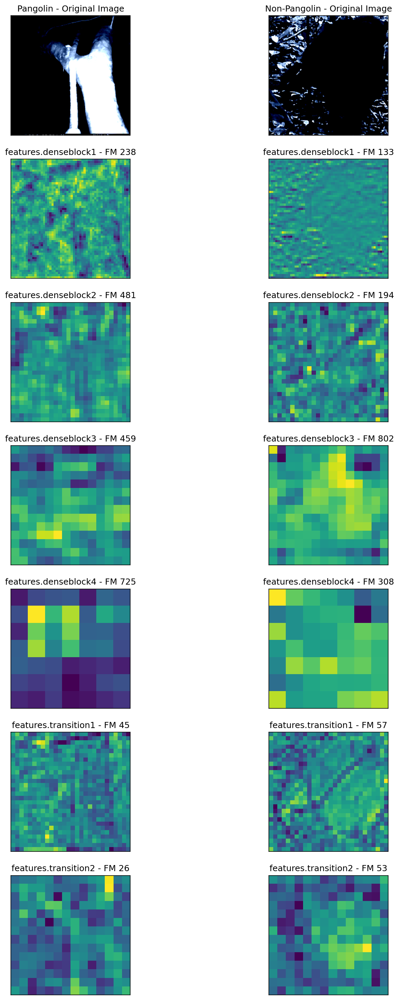

0.20923172682523727
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.0759, Validation Loss: 0.1786
Training Per-Species Metrics:
Precision: 0.9969, Recall: 0.9938, F1: 0.9953
Species 1 - Accuracy: 0.9936, Precision: 0.9866, Recall: 0.9932, F1: 0.9899
Training Overall Accuracy: 0.9936, Precision: 0.9917, Recall: 0.9935, F1: 0.9926
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 174.58631420135498





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

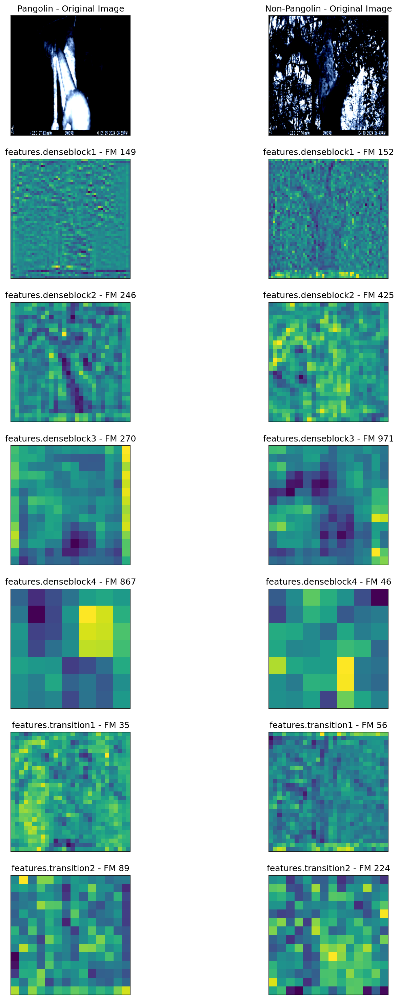

Epoch [10/15], Train Loss: 0.0596, Validation Loss: 0.1806
Training Per-Species Metrics:
Precision: 0.9969, Recall: 0.9969, F1: 0.9969
Species 1 - Accuracy: 0.9957, Precision: 0.9932, Recall: 0.9932, F1: 0.9932
Training Overall Accuracy: 0.9957, Precision: 0.9951, Recall: 0.9951, F1: 0.9951
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 161.91156101226807





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

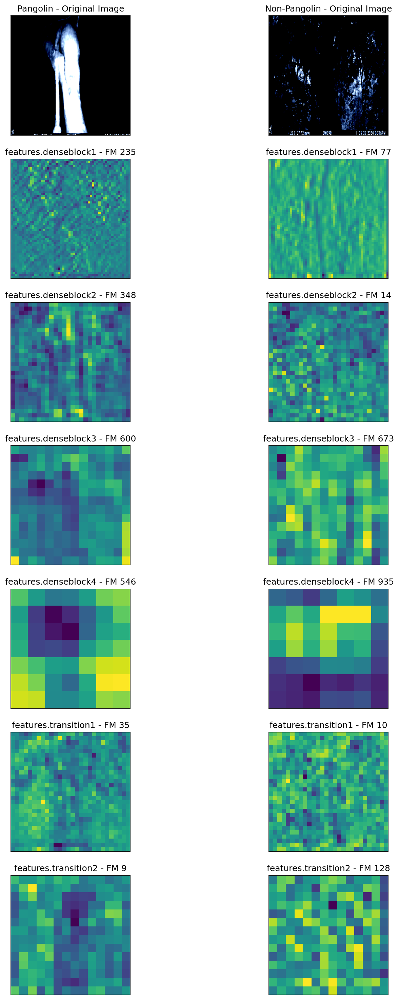

0.17862913385033607
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.0489, Validation Loss: 0.1749
Training Per-Species Metrics:
Precision: 1.0000, Recall: 0.9969, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 0.9933, Recall: 1.0000, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9966, Recall: 0.9984, F1: 0.9975
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 149.51661491394043





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

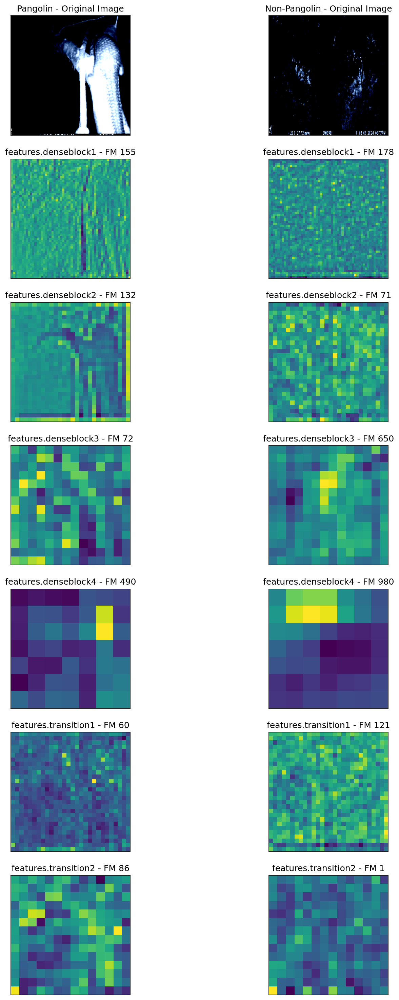

Epoch [12/15], Train Loss: 0.0307, Validation Loss: 0.1855
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 148.71037602424622





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5356624..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5356624..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5356624..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

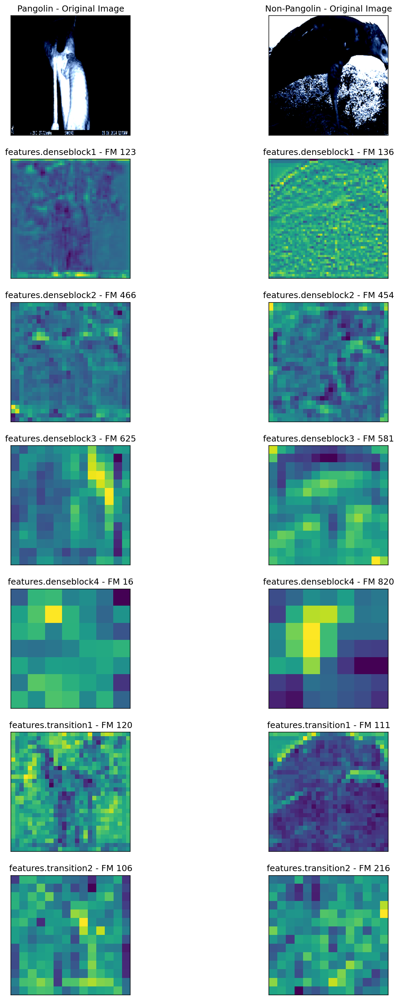

0.17486369237303734
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.0299, Validation Loss: 0.1633
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 151.14893579483032





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.11

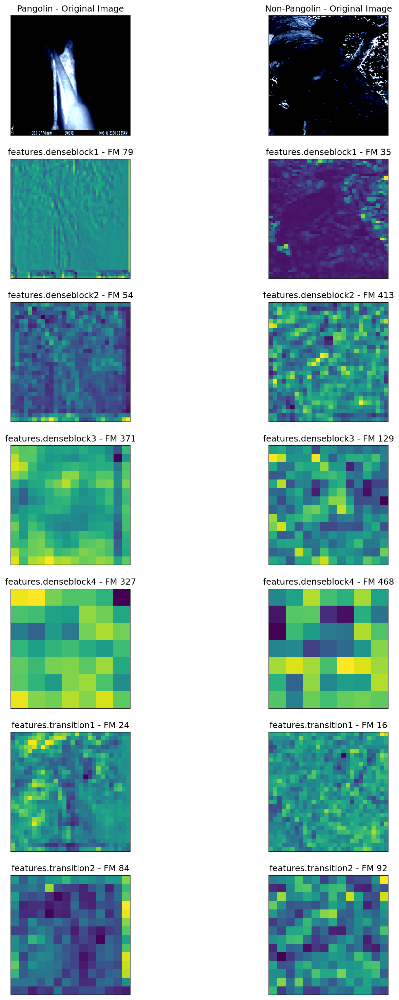

0.16326126642525196
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.0184, Validation Loss: 0.1588
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 151.70287585258484





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the 

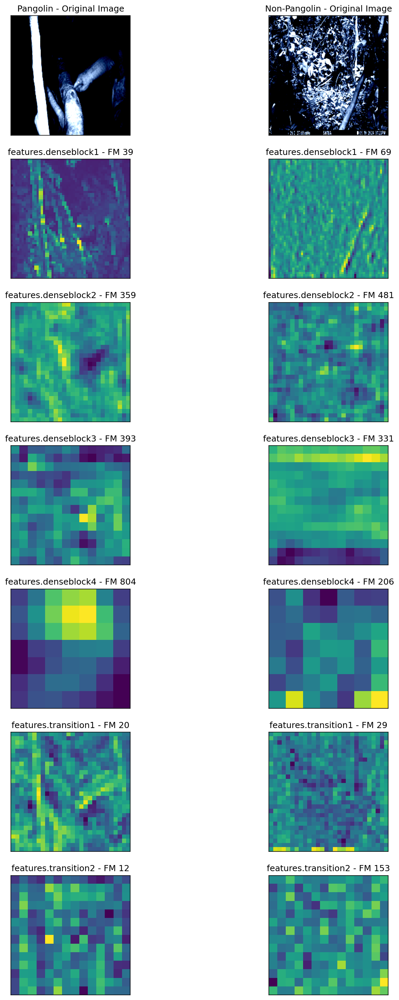

Epoch [15/15], Train Loss: 0.0157, Validation Loss: 0.1773
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 155.8641152381897



Test Metrics - Accuracy: 0.9538, Precision: 0.9730, Recall: 0.8780, F1: 0.9231, AUC: 0.9973
Test Per-Species Metrics:
Precision: 0.9462, Recall: 0.9888, F1: 0.9670
Species 1 - Accuracy: 0.9538, Precision: 0.9730, Recall: 0.8780, F1: 0.9231
Fold 5/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-

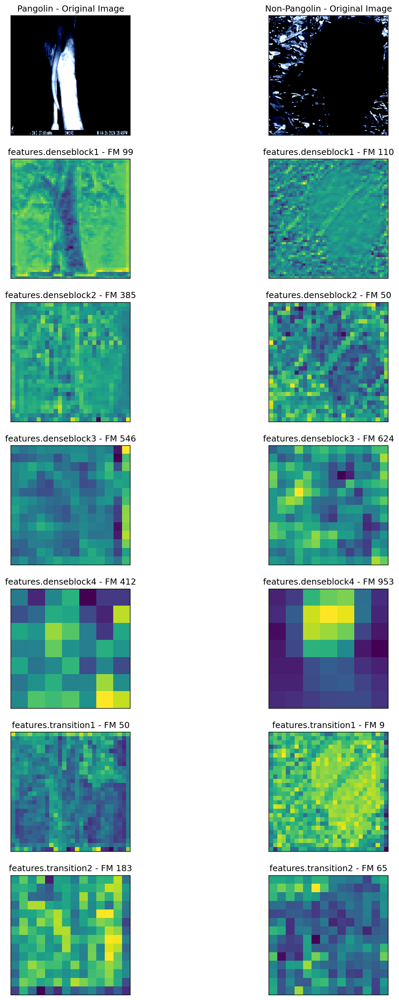

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6862, Validation Loss: 0.5946
Training Per-Species Metrics:
Precision: 0.6867, Recall: 0.5311, F1: 0.5989
Species 1 - Accuracy: 0.5128, Precision: 0.3167, Recall: 0.4730, F1: 0.3794
Training Overall Accuracy: 0.5128, Precision: 0.5017, Recall: 0.5020, F1: 0.4892
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 167.41326808929443





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2445416..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2445416..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2445416..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

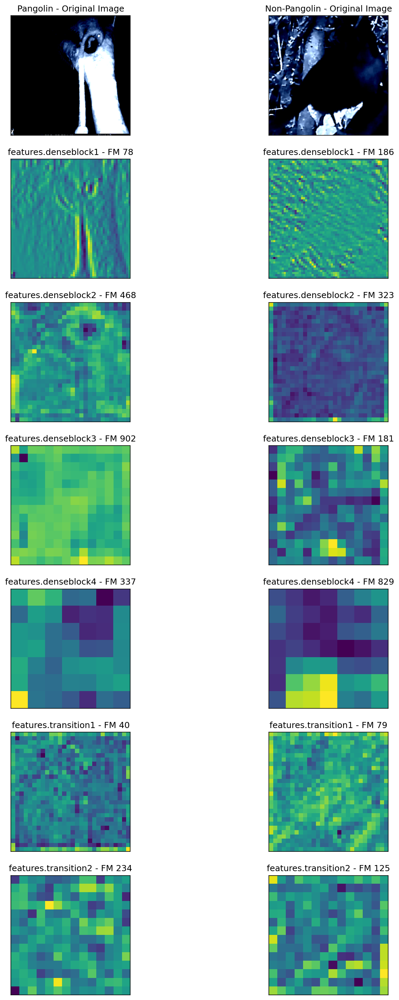

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5945828557014465
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5642, Validation Loss: 0.5355
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 160.0372450351715





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

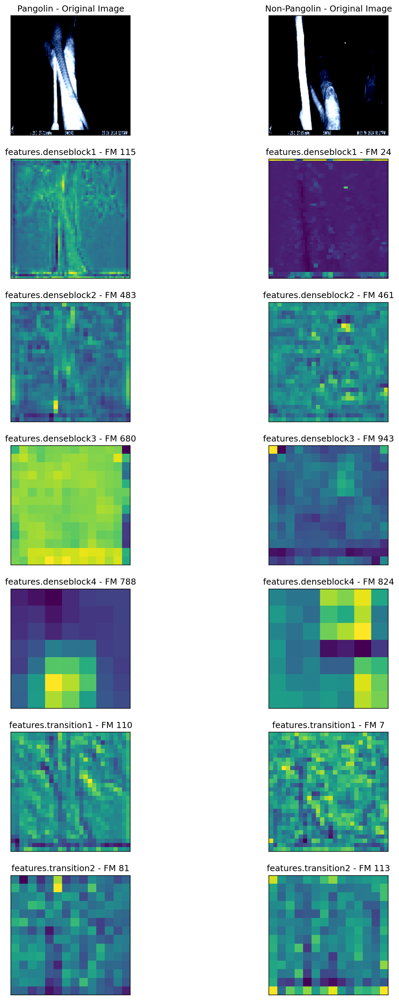

0.5354881286621094
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.4624, Validation Loss: 0.4616
Training Per-Species Metrics:
Precision: 0.7165, Recall: 0.9969, F1: 0.8338
Species 1 - Accuracy: 0.7277, Precision: 0.9545, Recall: 0.1419, F1: 0.2471
Training Overall Accuracy: 0.7277, Precision: 0.8355, Recall: 0.5694, F1: 0.5404
Validation Overall Accuracy: 0.7925, Precision: 0.8264, Recall: 0.6920, F1: 0.7121
Epoch time 154.12112188339233





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

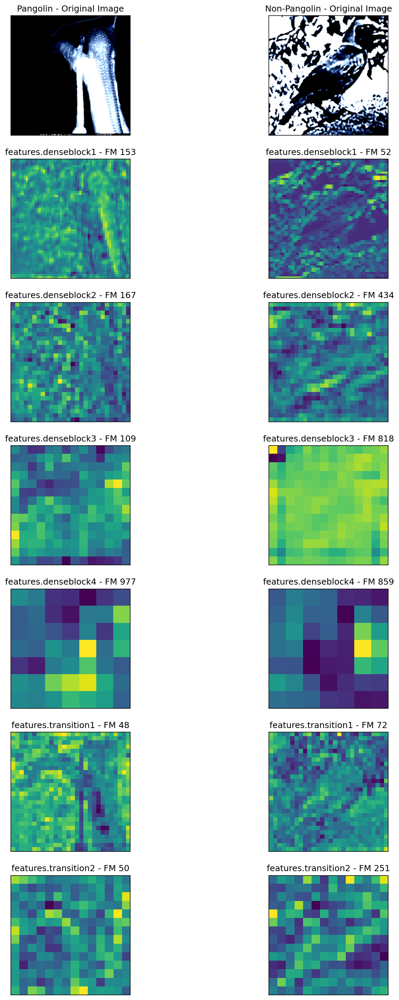

0.46156102418899536
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.3853, Validation Loss: 0.3806
Training Per-Species Metrics:
Precision: 0.8268, Recall: 0.9783, F1: 0.8962
Species 1 - Accuracy: 0.8447, Precision: 0.9213, Recall: 0.5541, F1: 0.6920
Training Overall Accuracy: 0.8447, Precision: 0.8741, Recall: 0.7662, F1: 0.7941
Validation Overall Accuracy: 0.8113, Precision: 0.8139, Recall: 0.7369, F1: 0.7573
Epoch time 151.94793605804443





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

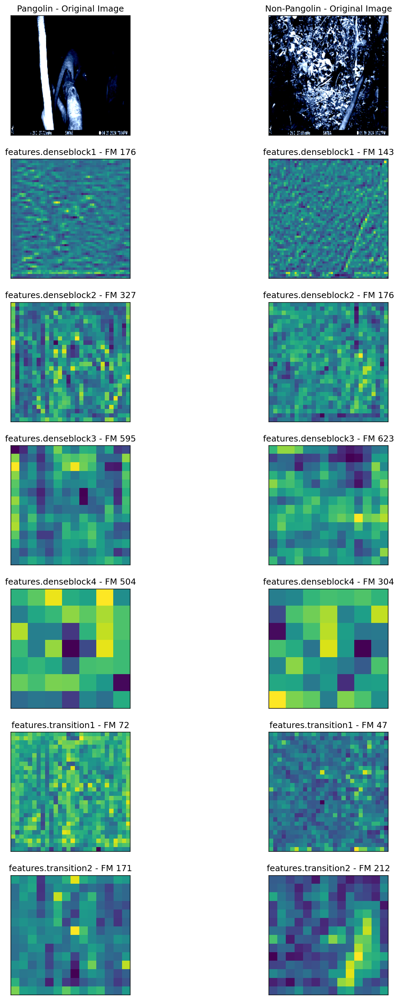

0.38061289489269257
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.3093, Validation Loss: 0.3049
Training Per-Species Metrics:
Precision: 0.9067, Recall: 0.9658, F1: 0.9353
Species 1 - Accuracy: 0.9085, Precision: 0.9134, Recall: 0.7838, F1: 0.8436
Training Overall Accuracy: 0.9085, Precision: 0.9100, Recall: 0.8748, F1: 0.8895
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 152.72824788093567





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

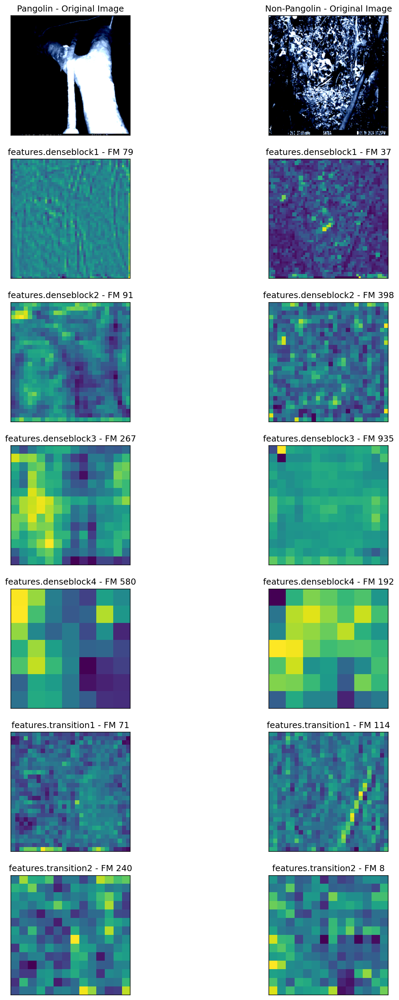

0.3049115836620331
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.2297, Validation Loss: 0.2254
Training Per-Species Metrics:
Precision: 0.9692, Recall: 0.9783, F1: 0.9737
Species 1 - Accuracy: 0.9638, Precision: 0.9517, Recall: 0.9324, F1: 0.9420
Training Overall Accuracy: 0.9638, Precision: 0.9605, Recall: 0.9553, F1: 0.9579
Validation Overall Accuracy: 0.9434, Precision: 0.9302, Recall: 0.9428, F1: 0.9360
Epoch time 145.6282811164856





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

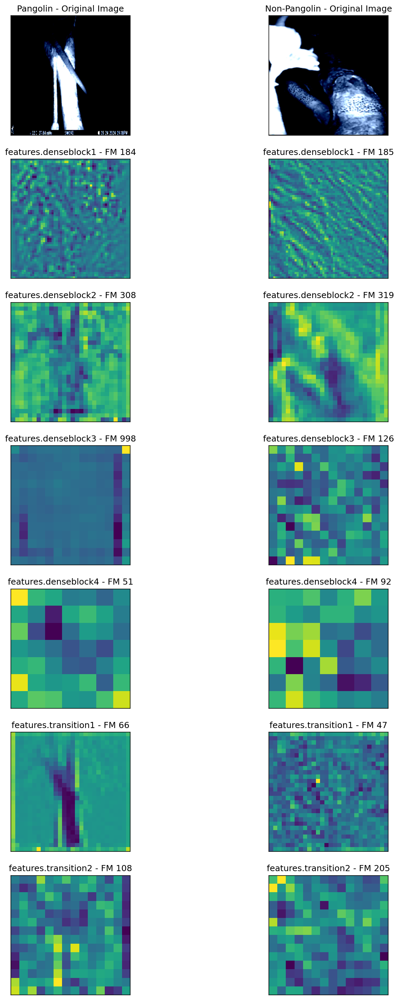

0.22535403817892075
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.1701, Validation Loss: 0.1914
Training Per-Species Metrics:
Precision: 0.9812, Recall: 0.9720, F1: 0.9766
Species 1 - Accuracy: 0.9681, Precision: 0.9404, Recall: 0.9595, F1: 0.9498
Training Overall Accuracy: 0.9681, Precision: 0.9608, Recall: 0.9658, F1: 0.9632
Validation Overall Accuracy: 0.9245, Precision: 0.9063, Recall: 0.9289, F1: 0.9159
Epoch time 148.71661901474





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Cli

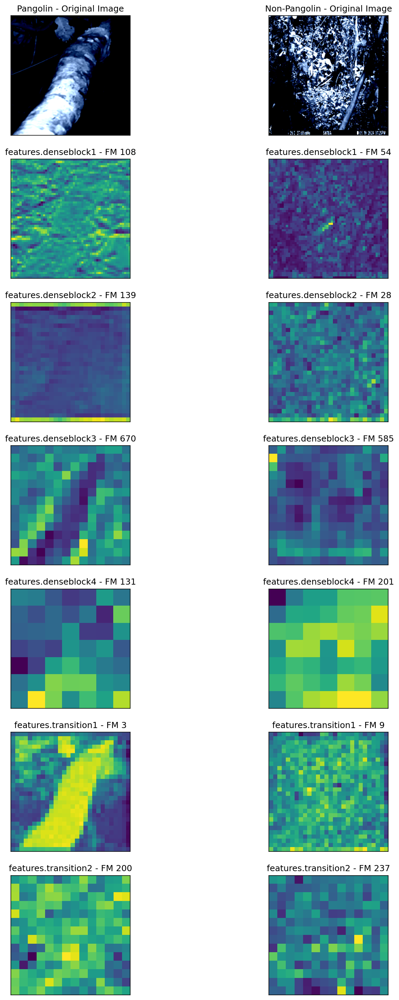

0.19144989550113678
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.1238, Validation Loss: 0.1575
Training Per-Species Metrics:
Precision: 0.9815, Recall: 0.9876, F1: 0.9845
Species 1 - Accuracy: 0.9787, Precision: 0.9726, Recall: 0.9595, F1: 0.9660
Training Overall Accuracy: 0.9787, Precision: 0.9770, Recall: 0.9735, F1: 0.9753
Validation Overall Accuracy: 0.9623, Precision: 0.9474, Recall: 0.9722, F1: 0.9579
Epoch time 150.0355110168457





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

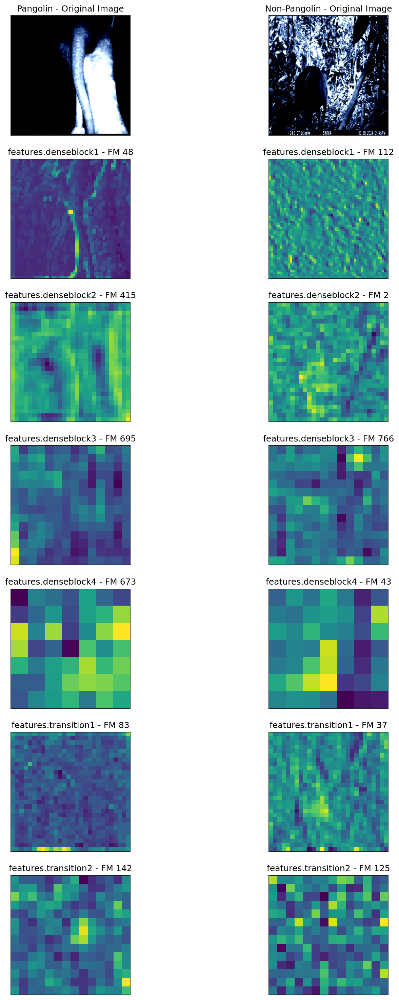

0.15745999664068222
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.0959, Validation Loss: 0.1298
Training Per-Species Metrics:
Precision: 0.9938, Recall: 0.9876, F1: 0.9907
Species 1 - Accuracy: 0.9872, Precision: 0.9733, Recall: 0.9865, F1: 0.9799
Training Overall Accuracy: 0.9872, Precision: 0.9835, Recall: 0.9870, F1: 0.9853
Validation Overall Accuracy: 0.9245, Precision: 0.9272, Recall: 0.8979, F1: 0.9105
Epoch time 154.00556588172913





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5005665].
Cli

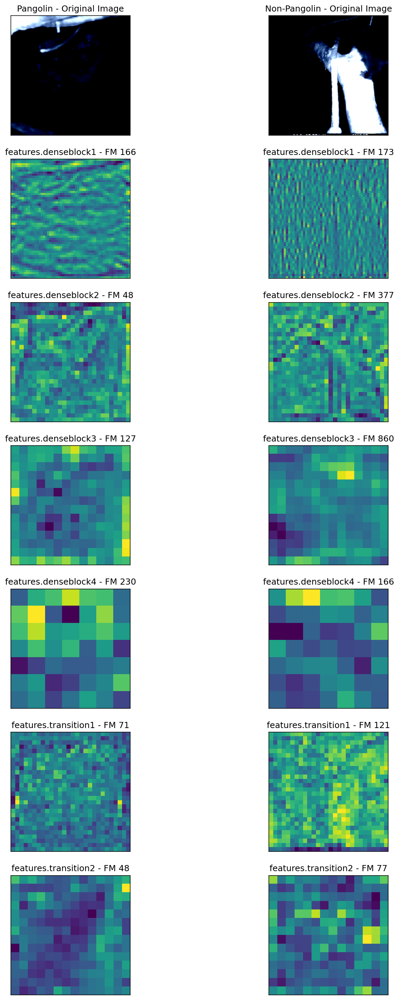

0.12976797297596931
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.0691, Validation Loss: 0.0879
Training Per-Species Metrics:
Precision: 0.9938, Recall: 0.9969, F1: 0.9953
Species 1 - Accuracy: 0.9936, Precision: 0.9932, Recall: 0.9865, F1: 0.9898
Training Overall Accuracy: 0.9936, Precision: 0.9935, Recall: 0.9917, F1: 0.9926
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 157.47328782081604





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.1519828].
Cli

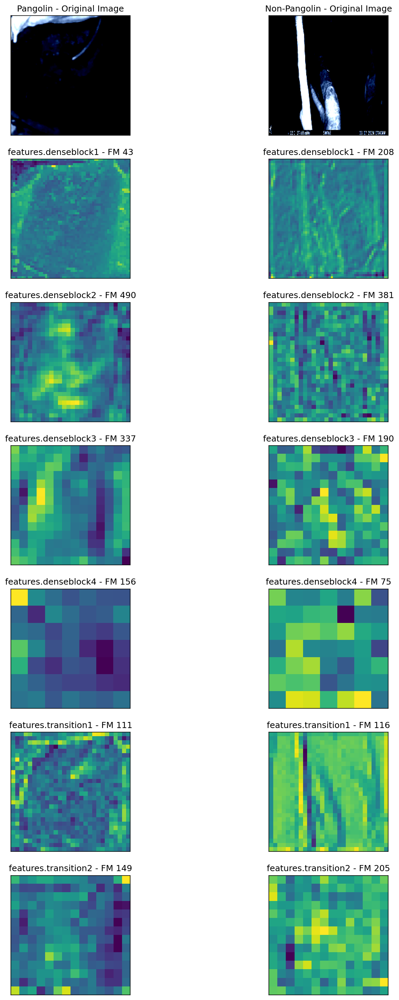

0.08787860721349716
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.0520, Validation Loss: 0.0691
Training Per-Species Metrics:
Precision: 0.9908, Recall: 1.0000, F1: 0.9954
Species 1 - Accuracy: 0.9936, Precision: 1.0000, Recall: 0.9797, F1: 0.9898
Training Overall Accuracy: 0.9936, Precision: 0.9954, Recall: 0.9899, F1: 0.9926
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 163.0387909412384





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data 

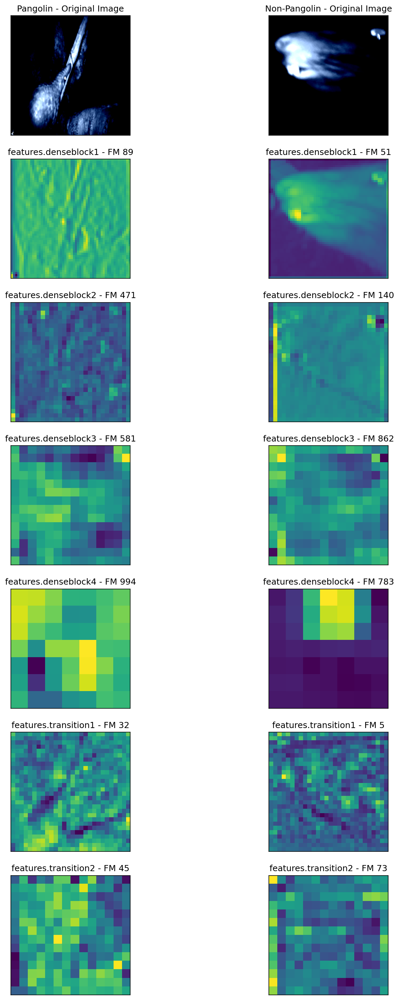

Epoch [12/15], Train Loss: 0.0347, Validation Loss: 0.0736
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 162.6641809940338





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Cli

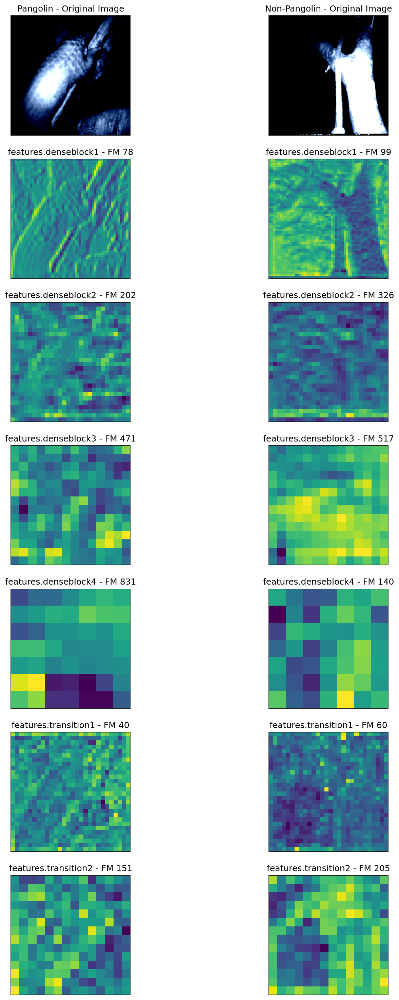

Epoch [13/15], Train Loss: 0.0353, Validation Loss: 0.0820
Training Per-Species Metrics:
Precision: 0.9908, Recall: 1.0000, F1: 0.9954
Species 1 - Accuracy: 0.9936, Precision: 1.0000, Recall: 0.9797, F1: 0.9898
Training Overall Accuracy: 0.9936, Precision: 0.9954, Recall: 0.9899, F1: 0.9926
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 156.53304600715637





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

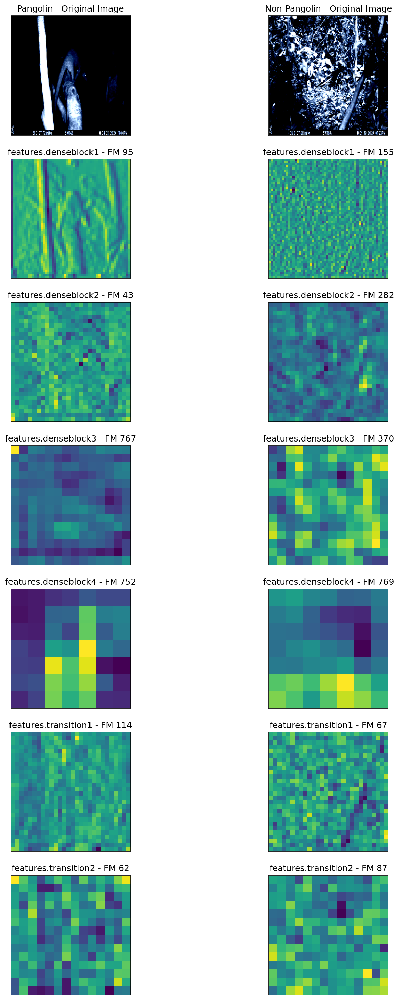

0.06905072554945946
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.0275, Validation Loss: 0.0682
Training Per-Species Metrics:
Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Species 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Training Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 163.17311596870422





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

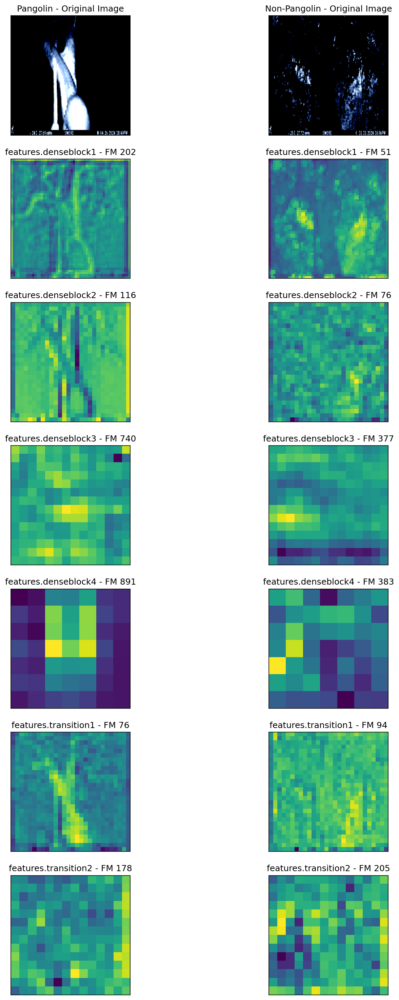

0.0682438425719738
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.0233, Validation Loss: 0.0554
Training Per-Species Metrics:
Precision: 0.9969, Recall: 1.0000, F1: 0.9984
Species 1 - Accuracy: 0.9979, Precision: 1.0000, Recall: 0.9932, F1: 0.9966
Training Overall Accuracy: 0.9979, Precision: 0.9985, Recall: 0.9966, F1: 0.9975
Validation Overall Accuracy: 0.9811, Precision: 0.9722, Recall: 0.9861, F1: 0.9787
Epoch time 164.0635588169098



Test Metrics - Accuracy: 0.9769, Precision: 0.9318, Recall: 1.0000, F1: 0.9647, AUC: 1.0000
Test Per-Species Metrics:
Precision: 1.0000, Recall: 0.9663, F1: 0.9829
Species 1 - Accuracy: 0.9769, Precision: 0.9318, Recall: 1.0000, F1: 0.9647


In [32]:
from torch.utils.data import DataLoader 
from PIL import Image
import sklearn
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import torch
import torch.optim as optim
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import torch.optim as optim
from torch import nn  # import neural network from PyTorch
import torchvision.models as models  # import models submodule (includes pre-trained models used for computer vision)
from torchmetrics.classification import MulticlassAccuracy
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
import math
from torchmetrics.classification import BinaryAccuracy




import time  # Import the time module for tracking training time

# Store feature maps for each layer
feature_maps = {}

# Define the hook function to save feature maps
def hook_fn(module, input, output, layer_name):
    feature_maps[layer_name] = output.detach()


# Define a function that trains and evaluates the model for a specified number of epochs
def train_and_evaluate(model, train_loader, val_loader, criterion, optimizer, num_epochs):
    train_losses, val_losses = [], []
    train_metrics, val_metrics = [], []  # To store metrics like accuracy, precision, etc. for each epoch
    per_species_train_metrics = {  # Store per-species metrics for training
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    per_species_val_metrics = {  # Store per-species metrics for validation
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    train_times = []  # List to store the time for each epoch

    model_save_path = []  # To store the best model based on validation loss
    # Specify the layers you want to visualize
    layers_to_visualize = ['features.denseblock1', 'features.denseblock2', 'features.denseblock3', 'features.denseblock4', 'features.transition1', 'features.transition2']

    # Register hooks for each layer
    hooks = []
    for layer_name in layers_to_visualize:
        layer = dict([*model.named_modules()])[layer_name]  # Get the layer by name
        hook = layer.register_forward_hook(lambda module, input, output, name=layer_name: hook_fn(module, input, output, name))
        hooks.append(hook)


    for epoch in range(num_epochs):
        start_time = time.time()  # Start the timer at the beginning of the epoch

        model.train()  # Set the model to train mode
        train_loss, train_preds, train_labels = 0, [], []
        train_probs = []
        train_outputs = []
        train_auc = 0

        # Training loop:
        for batch in train_loader:
            images = batch['image']
            labels = batch['label'] # CHANGED
            labels = labels.unsqueeze(1).float()
            #labels = torch.argmax(labels, dim=1)  # Convert to 1D tensor of class indices
            #print(f"Unique labels in train batch: {torch.unique(labels)}")

            optimizer.zero_grad()
            outputs = model(images)  # Obtains predictions
            loss = criterion(outputs, labels)  # Computes the loss
            loss.backward()  # Backprop to compute the gradients
            optimizer.step()  # Updates the model weights based on gradients

            # Save train loss
            train_loss += loss.item()  # Accumulates the loss for the batch
            preds = (outputs > 0.5).int()  # binary predictions: 0 or 1
            train_preds.extend(preds.cpu().numpy())
            #train_preds.extend(torch.argmax(outputs, dim=1).cpu().numpy())  CHANGED
            train_labels.extend(labels.cpu().numpy())  # Stores the true labels for the batch

            # Add AUC calculation for training
            #train_outputs.extend(outputs.cpu().detach().numpy())  # Get probabilities for each class
            #train_auc = roc_auc_score(train_labels, train_outputs.cpu().detach().numpy(), average='macro', multi_class='ovr')
            #train_probs.extend(torch.softmax(outputs, dim=1).cpu().detach().numpy()) CHANGED
            train_probs.extend(outputs.cpu().detach().numpy())
        
        # Visualization after each epoch
        # Find indices of one pangolin and one non-pangolin
        pangolin_idx = (labels == 1).nonzero(as_tuple=True)[0][0].item()  # First pangolin
        non_pangolin_idx = (labels == 0).nonzero(as_tuple=True)[0][0].item()  # First non-pangolin
        fig, axes = plt.subplots(len(layers_to_visualize) + 1, 2, figsize=(12, 25), dpi=150)  # Increased DPI for better resolution

        for i, layer_name in enumerate(layers_to_visualize):
            # Display Pangolin original image
            axes[0][0].imshow(images[pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][0].set_xticks([]); axes[0][0].set_yticks([])
            axes[0][0].set_title("Pangolin - Original Image")

            # Display Non-Pangolin original image
            axes[0][1].imshow(images[non_pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][1].set_xticks([]); axes[0][1].set_yticks([])
            axes[0][1].set_title("Non-Pangolin - Original Image")

            # Display feature maps for Pangolin image
            fmap_pangolin = feature_maps[layer_name][pangolin_idx]  # Feature map for Pangolin image
            fmap_pangolin = (fmap_pangolin - fmap_pangolin.min()) / (fmap_pangolin.max() - fmap_pangolin.min())  # Normalize
            num_channels = fmap_pangolin.shape[0]
            
            random_channel_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for pangolin
            feature_map_pangolin = fmap_pangolin[random_channel_pangolin].cpu().numpy()

            axes[i + 1][0].imshow(feature_map_pangolin, cmap='viridis')
            axes[i + 1][0].set_xticks([]); axes[i + 1][0].set_yticks([])
            axes[i + 1][0].set_title(f"{layer_name} - FM {random_channel_pangolin}")

            # Display feature maps for Non-Pangolin image
            fmap_non_pangolin = feature_maps[layer_name][non_pangolin_idx]  # Feature map for Non-Pangolin image
            fmap_non_pangolin = (fmap_non_pangolin - fmap_non_pangolin.min()) / (fmap_non_pangolin.max() - fmap_non_pangolin.min())  # Normalize
            random_channel_non_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for non-pangolin
            feature_map_non_pangolin = fmap_non_pangolin[random_channel_non_pangolin].cpu().numpy()

            axes[i + 1][1].imshow(feature_map_non_pangolin, cmap='viridis')
            axes[i + 1][1].set_xticks([]); axes[i + 1][1].set_yticks([])
            axes[i + 1][1].set_title(f"{layer_name} - FM {random_channel_non_pangolin}")




        plt.show()


        train_outputs = np.array(train_probs)
        train_labels = np.array(train_labels)
        
        #train_auc = roc_auc_score(train_labels, train_outputs[:, 1], average='macro', multi_class='ovr')
        train_auc = roc_auc_score(train_labels, train_probs)


        train_loss /= len(train_loader)  # Computes the average training loss for the epoch
        train_losses.append(train_loss)  # Stores the average training loss for this epoch

        # Calculate per-species metrics for training
        train_labels_tensor = torch.tensor(train_labels)
        train_preds_tensor = torch.tensor(train_preds)

        accuracy_metric = BinaryAccuracy()
        accuracy_metric.update(train_preds_tensor, train_labels_tensor)
        binary_accuracy = accuracy_metric.compute().item()
        species_train_accuracy = [1 - binary_accuracy, binary_accuracy]

        species_train_precision = precision_score(train_labels, train_preds, average=None)  # Per-class precision
        species_train_recall = recall_score(train_labels, train_preds, average=None)  # Per-class recall
        species_train_f1 = f1_score(train_labels, train_preds, average=None)  # Per-class F1 score
        
        # Calculate per-species AUC for training
        species_train_auc = []
        for i in range(len(species_train_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            auc = roc_auc_score(train_labels, train_probs)
            species_train_auc.append(auc)

        per_species_train_metrics['accuracy'].append(species_train_accuracy)
        per_species_train_metrics['precision'].append(species_train_precision)
        per_species_train_metrics['recall'].append(species_train_recall)
        per_species_train_metrics['f1'].append(species_train_f1)
        per_species_train_metrics['auc'].append(species_train_auc)  # Append AUC values for training

        # Calculate overall metrics for training
        train_accuracy = accuracy_score(train_labels, train_preds)  # Overall accuracy
        train_precision = precision_score(train_labels, train_preds, average='macro')  # Overall precision (macro-average)
        train_recall = recall_score(train_labels, train_preds, average='macro')  # Overall recall (macro-average)
        train_f1 = f1_score(train_labels, train_preds, average='macro')  # Overall F1 score (macro-average)

        train_metrics.append({
            'accuracy': train_accuracy,
            'precision': train_precision,
            'recall': train_recall,
            'f1': train_f1,
            'auc': train_auc
        })

        # Validation Loop:
        model.eval()  # Set the model to evaluation mode
        val_loss, val_preds, val_labels = 0, [], []
        val_probs = []
        val_auc = 0
        with torch.no_grad():
            for batch in val_loader:
                images = batch['image']
                labels = batch['label'].unsqueeze(1).float()

                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                # Binary prediction: 1 if output > 0.5, else 0
                preds = (outputs > 0.5).int()
                val_preds.extend(preds.cpu().numpy())
                val_labels.extend(labels.cpu().numpy())

                # For AUC, store sigmoid probabilities
                val_probs.extend(outputs.cpu().detach().numpy())

        val_loss /= len(val_loader)  # Computes the average validation loss for this epoch
        

        # Calculate per-species metrics for validation
        species_val_precision = precision_score(val_labels, val_preds, average=None)  # Per-class precision
        species_val_recall = recall_score(val_labels, val_preds, average=None)  # Per-class recall
        species_val_f1 = f1_score(val_labels, val_preds, average=None)  # Per-class F1 score

        
        val_labels_tensor = torch.tensor(val_labels)  # Make sure to convert them to torch tensors
        val_preds_tensor = torch.tensor(val_preds)

        accuracy_metric = MulticlassAccuracy(num_classes=2, average=None)
        accuracy_metric.update(val_preds_tensor, val_labels_tensor)
        species_val_accuracy = accuracy_metric.compute().tolist()

        val_auc = roc_auc_score(np.array(val_labels).flatten(), np.array(val_probs).flatten())


        # Calculate per-species AUC for validation
        species_val_auc = []
        #for i in range(len(species_val_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            #auc = roc_auc_score([1 if label == i else 0 for label in val_labels], [prob[i] for prob in val_probs])
            #species_val_auc.append(auc)

        per_species_val_metrics['accuracy'].append(species_val_accuracy)
        per_species_val_metrics['precision'].append(species_val_precision)
        per_species_val_metrics['recall'].append(species_val_recall)
        per_species_val_metrics['f1'].append(species_val_f1)
        per_species_val_metrics['auc'].append(species_val_auc)



        # Calculate overall metrics for validation
        val_accuracy = accuracy_score(val_labels, val_preds)  # Overall accuracy
        val_precision = precision_score(val_labels, val_preds, average='macro')  # Overall precision (macro-average)
        val_recall = recall_score(val_labels, val_preds, average='macro')  # Overall recall (macro-average)
        val_f1 = f1_score(val_labels, val_preds, average='macro')  # Overall F1 score (macro-average)

        val_metrics.append({
            'accuracy': val_accuracy,
            'precision': val_precision,
            'recall': val_recall,
            'f1': val_f1,
            'auc': val_auc
        })

        # Save the model with the lowest validation loss
        
        if epoch == 0 or val_loss < min(val_losses):
            if epoch != 0: 
                print(min(val_losses))
            print("Saving for this epoch", epoch)
            model_save_path = model.state_dict()
        val_losses.append(val_loss)  # Stores the average validation loss for this epoch


        # Print per-species metrics and overall metrics
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")
        
        # Print per-species metrics for training
       # Print per-species metrics for training
        print("Training Per-Species Metrics:")
    
        for idx in range(len(species_train_accuracy)):
            #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            # Check if idx is within the bounds of other metrics
            if idx == 1:
                print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #if idx < len(species_train_precision) and idx < len(species_train_recall) and idx < len(species_train_f1):
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                

        # Print overall metrics for training
        print(f"Training Overall Accuracy: {train_accuracy:.4f}, Precision: {train_precision:.4f}, Recall: {train_recall:.4f}, F1: {train_f1:.4f}")

       # Print per-species metrics for validation
        #print("Validation Per-Species Metrics:")
        #for idx in range(len(species_val_accuracy)):
            # Check if idx is within the bounds of other metrics
            #if idx < len(species_val_precision) and idx < len(species_val_recall) and idx < len(species_val_f1):
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: {species_val_precision[idx]:.4f}, Recall: {species_val_recall[idx]:.4f}, F1: {species_val_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                
        # Print overall metrics for validation
        print(f"Validation Overall Accuracy: {val_accuracy:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1: {val_f1:.4f}")

        # Calculate training time for this epoch
        end_time = time.time()
        epoch_time = end_time - start_time
        print("Epoch time", epoch_time)
        train_times.append(epoch_time)
        print("\n\n")

    return model_save_path, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times

###### KFOLD CROSS VALIDATION ########
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility
all_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': []
}

all_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_per_species_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [], 
    'auc': []
}
all_train_times = []
all_train_losses = []
all_validation_loss = []


#y_train = y_train.argmax(axis=1)
#for fold, (train_index, test_index) in enumerate(kf.split(combined_df)):
for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set
    
    # Further split the training data into training and validation (90/10 split)
        #train_data, val_data = train_data[:int(0.9 * len(train_data))], train_data[int(0.9 * len(train_data)):]
        #train_labels, val_labels = train_labels[:int(0.9 * len(train_labels))], train_labels[int(0.9 * len(train_labels)):]
   # Perform stratified split while maintaining original proportions
    train_data, val_data, train_labels, val_labels = train_test_split(
        train_data, train_labels,  # Original training data and labels
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )


    # Filter out .DS_Store files from train, validation, and test data
    train_data = train_data[~train_data['filepath'].str.endswith('.DS_Store')]
    val_data = val_data[~val_data['filepath'].str.endswith('.DS_Store')]
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]



    # Create Dataloader for this fold
    train_dataset = ImagesDataset(train_data, train_labels)  # Ensure transform is defined
    val_dataset = ImagesDataset(val_data, val_labels)
    test_dataset = ImagesDataset(test_data, test_labels)

    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    
    

    model = models.densenet121(pretrained=True)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )

    criterion = nn.BCELoss() # for binary classification
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    # model.parameters() - weights and biases that optimizer updates during training

    best_model, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times = train_and_evaluate(
        model, train_loader, val_loader, criterion, optimizer, num_epochs=15
    )

    torch.save(best_model, f"best_model_fold_{fold+1}.pth")


    all_val_metrics['accuracy'].append(val_metrics[-1]['accuracy'])
    all_val_metrics['precision'].append(val_metrics[-1]['precision'])
    all_val_metrics['recall'].append(val_metrics[-1]['recall'])
    all_val_metrics['f1'].append(val_metrics[-1]['f1'])

    all_train_metrics['accuracy'].append(train_metrics[-1]['accuracy'])
    all_train_metrics['precision'].append(train_metrics[-1]['precision'])
    all_train_metrics['recall'].append(train_metrics[-1]['recall'])
    all_train_metrics['f1'].append(train_metrics[-1]['f1'])
    all_train_metrics['auc'].append(train_metrics[-1]['auc'])

    # Store per-species metrics and training time for this fold
    all_per_species_train_metrics['accuracy'].append(per_species_train_metrics['accuracy'])
    all_per_species_train_metrics['precision'].append(per_species_train_metrics['precision'])
    all_per_species_train_metrics['recall'].append(per_species_train_metrics['recall'])
    all_per_species_train_metrics['f1'].append(per_species_train_metrics['f1'])
    all_per_species_train_metrics['auc'].append(per_species_train_metrics['auc'])

    all_per_species_val_metrics['accuracy'].append(per_species_val_metrics['accuracy'])
    all_per_species_val_metrics['precision'].append(per_species_val_metrics['precision'])
    all_per_species_val_metrics['recall'].append(per_species_val_metrics['recall'])
    all_per_species_val_metrics['f1'].append(per_species_val_metrics['f1'])

    all_train_times.append(train_times)
    all_train_losses.append(train_losses)
    all_validation_loss.append(val_losses)

    # Evaluate on the test set
    model.load_state_dict(best_model)  # Load the best model saved during training
    model.eval()  # Set the model to evaluation mode

    # Initialize variables to calculate metrics
    test_preds, test_labels = [], []
    test_probs = []
    test_auc = 0
    test_outputs = []

    per_species_test_metrics = {
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }

    # Iterate over the test set to get predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    test_labels = np.array(test_labels)

    # Calculate AUC using probabilities for the positive class
    test_auc = roc_auc_score(test_labels, test_probs)

    # Compute overall test metrics
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_precision = precision_score(test_labels, test_preds)
    test_recall = recall_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds)

    # Print overall test metrics
    print(f"Test Metrics - Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1: {test_f1:.4f}, AUC: {test_auc:.4f}")


    species_test_precision = precision_score(test_labels, test_preds, average=None)  # Per-class precision
    species_test_recall = recall_score(test_labels, test_preds, average=None)  # Per-class recall
    species_test_f1 = f1_score(test_labels, test_preds, average=None)  # Per-class F1 score

    # Store per-species test metrics (though only class 1 is meaningful here)
    per_species_test_metrics['accuracy'].append([1-test_accuracy, test_accuracy])  # Accuracy for the entire test set
    per_species_test_metrics['precision'].append(species_test_precision)
    per_species_test_metrics['recall'].append(species_test_recall)
    per_species_test_metrics['f1'].append(species_test_f1)

    # Calculate AUC for class 1 (positive class)
    species_test_auc = roc_auc_score(test_labels, test_probs)

    per_species_test_metrics['auc'].append(species_test_auc)

    # Print per-species test metrics
    print("Test Per-Species Metrics:")
    for idx in range(2):
            if idx == 1:
                print(f"Species {idx} - Accuracy: {test_accuracy:.4f}, "
                    f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
   
    # Save test metrics for each fold
    all_test_metrics['accuracy'].append(test_accuracy)
    all_test_metrics['precision'].append(test_precision)
    all_test_metrics['recall'].append(test_recall)
    all_test_metrics['f1'].append(test_f1)
    all_test_metrics['auc'].append(test_auc)

    all_per_species_test_metrics['accuracy'].append(per_species_test_metrics['accuracy'][-1])
    all_per_species_test_metrics['precision'].append(per_species_test_metrics['precision'][-1])
    all_per_species_test_metrics['recall'].append(per_species_test_metrics['recall'][-1])   
    all_per_species_test_metrics['f1'].append(per_species_test_metrics['f1'][-1])
    all_per_species_test_metrics['auc'].append(per_species_test_metrics['auc'][-1])



## Graph Different Metrics 

### Confusion Matrices for Each Test Run (1 per fold)

Processing Confusion Matrix for Fold 1


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


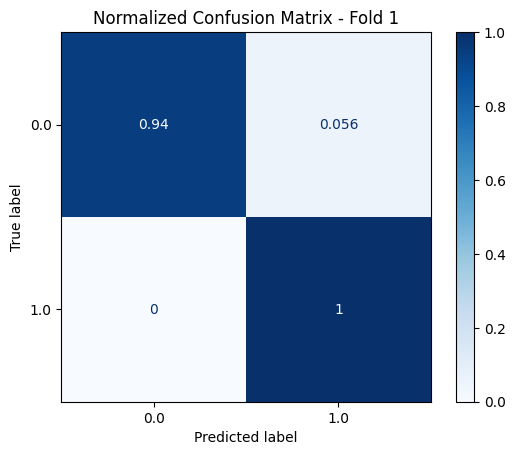

Processing Confusion Matrix for Fold 2


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


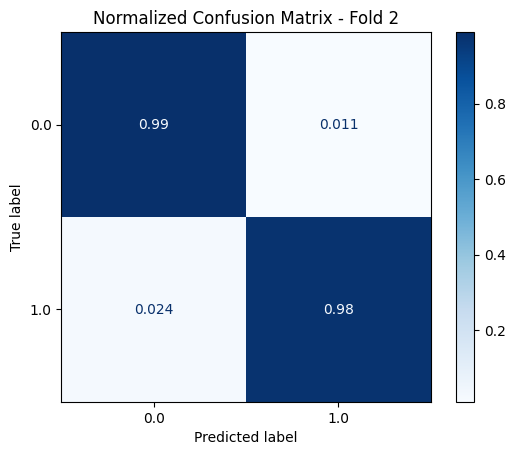

Processing Confusion Matrix for Fold 3


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


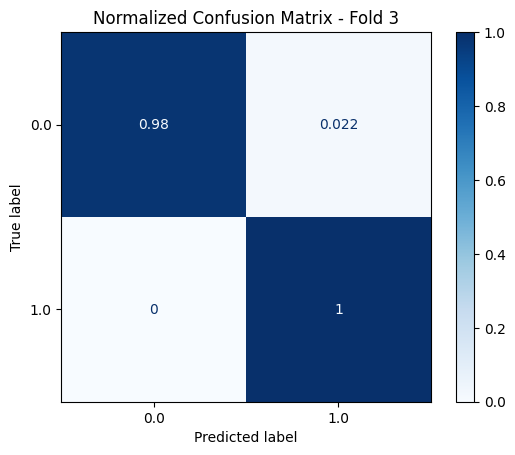

Processing Confusion Matrix for Fold 4


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


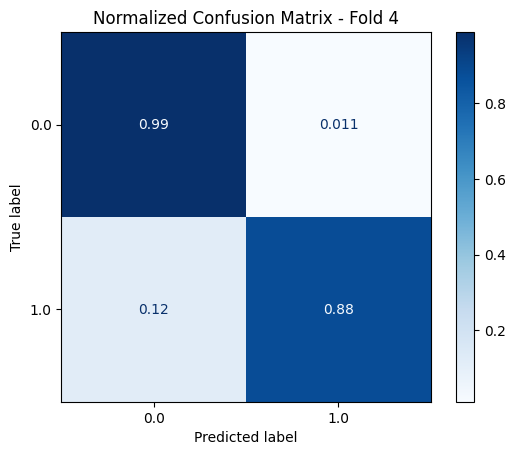

Processing Confusion Matrix for Fold 5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


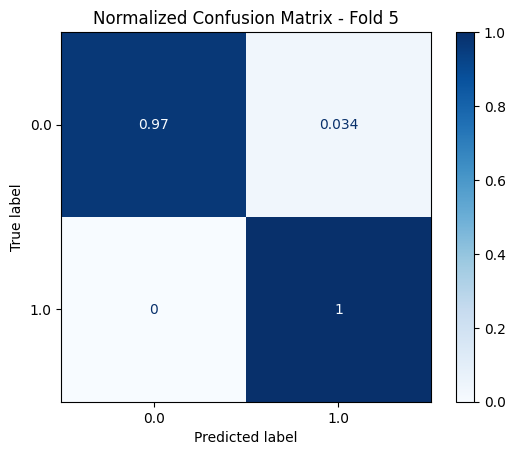

In [33]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=True)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()



        


### Line Charts for Train Times (1 per Fold)

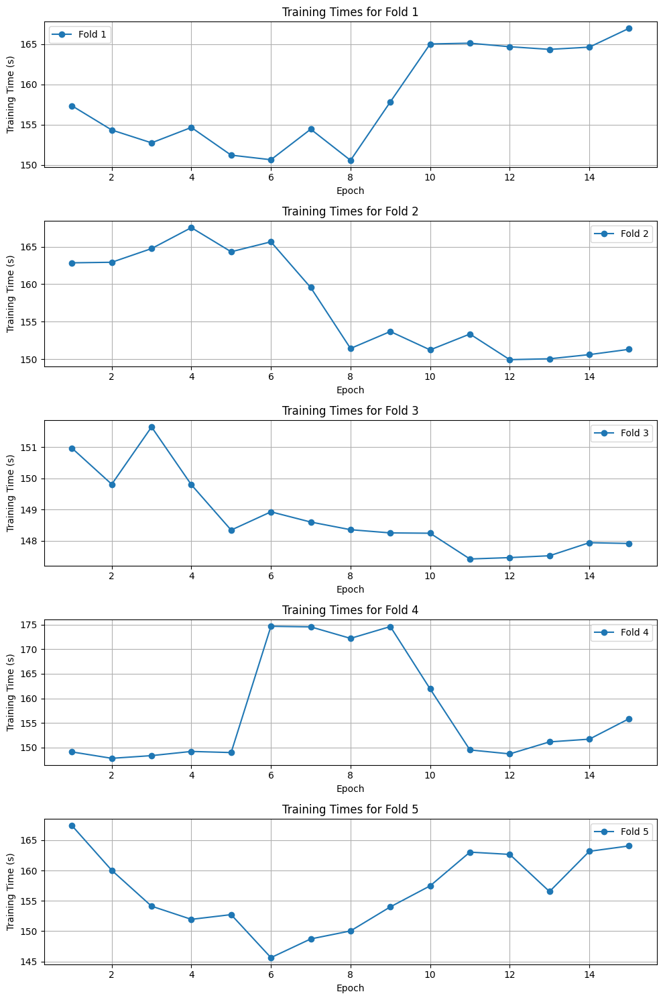

In [34]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training times
for i, fold in enumerate(all_train_times):
    axes[i].plot(range(1, 16), fold, marker='o', label=f'Fold {i+1}')
    axes[i].set_title(f'Training Times for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Training Time (s)')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

## Graph Train Loss for Each Fold

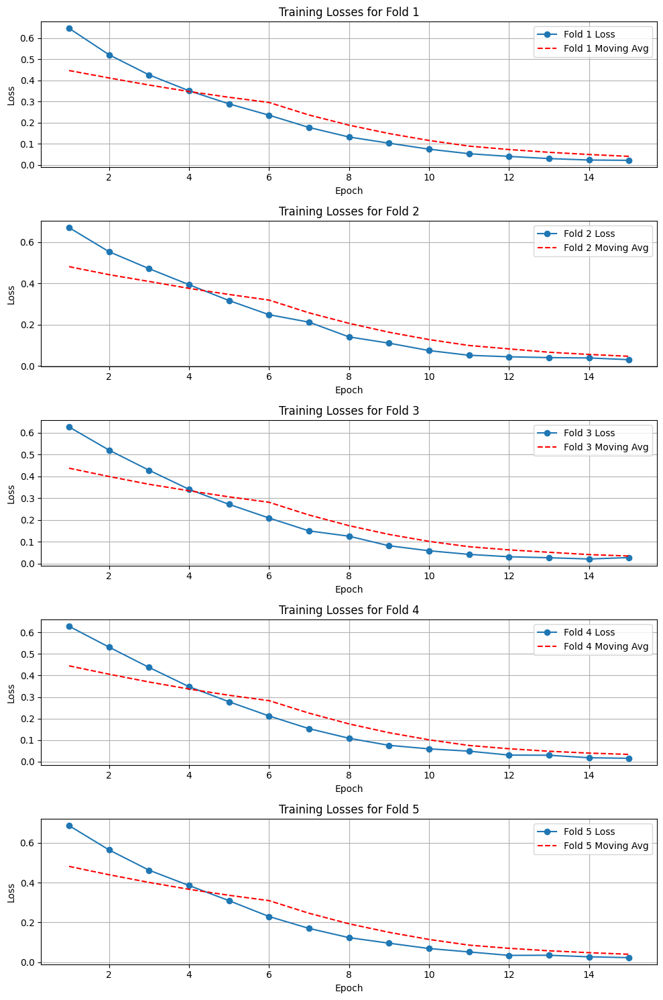

In [35]:

# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_train_losses):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Graph Validation Loss for Each Fold

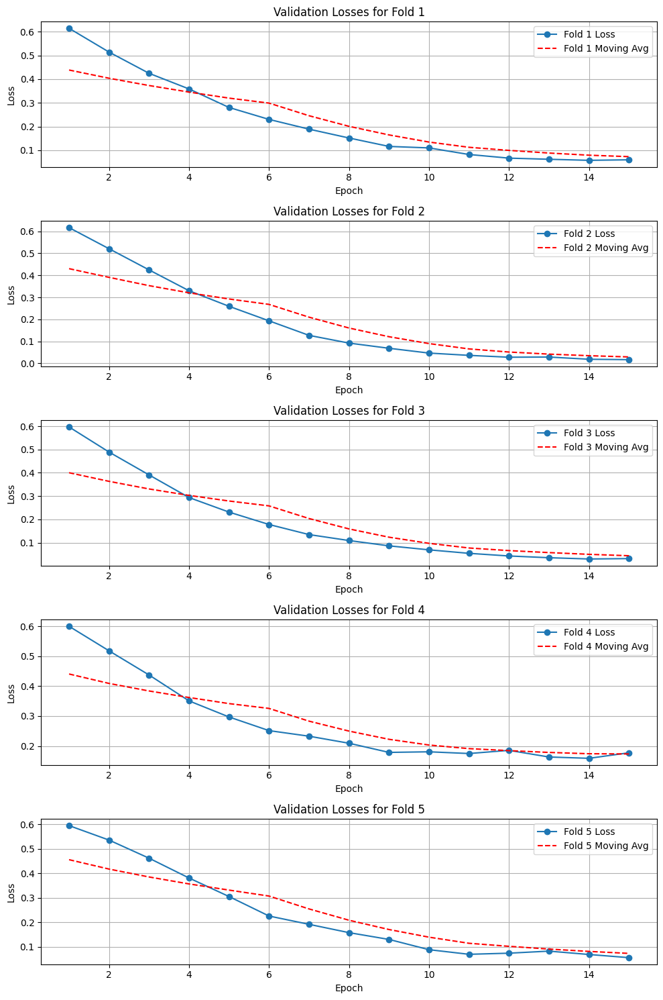

In [36]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_validation_loss):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

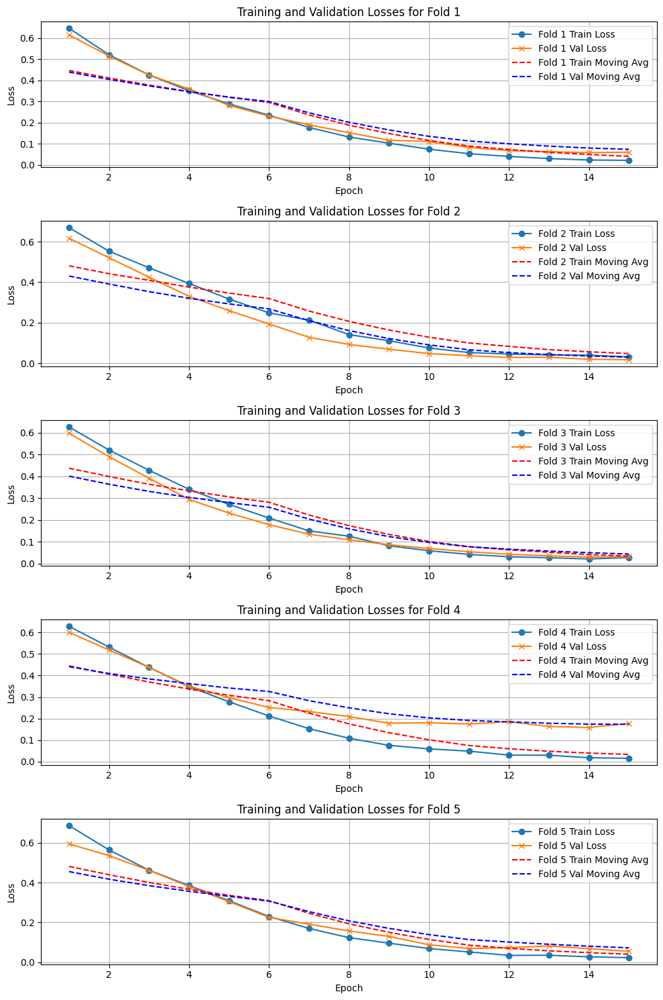

In [37]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot both training and validation losses with moving averages
for i, (train_loss, val_loss) in enumerate(zip(all_train_losses, all_validation_loss)):
    # Convert the training and validation loss values to pandas Series for rolling mean
    train_loss_series = pd.Series(train_loss).astype(float)
    val_loss_series = pd.Series(val_loss).astype(float)
    
    # Calculate the rolling average with a window size of 10
    train_rolling_avg = train_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    val_rolling_avg = val_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original training and validation losses
    axes[i].plot(range(1, len(train_loss) + 1), train_loss, marker='o', label=f'Fold {i+1} Train Loss')
    axes[i].plot(range(1, len(val_loss) + 1), val_loss, marker='x', label=f'Fold {i+1} Val Loss')
    
    # Plot the moving averages
    axes[i].plot(range(1, len(train_loss) + 1), train_rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Train Moving Avg')
    axes[i].plot(range(1, len(val_loss) + 1), val_rolling_avg, linestyle='--', color='blue', label=f'Fold {i+1} Val Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training and Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Bar Charts for Each Metric for Test Per Species

{'accuracy': [[0.03816793893129766, 0.9618320610687023], [0.01526717557251911, 0.9847328244274809], [0.01526717557251911, 0.9847328244274809], [0.0461538461538461, 0.9538461538461539], [0.023076923076923106, 0.9769230769230769]], 'precision': [array([1.        , 0.89361702]), array([0.98888889, 0.97560976]), array([1.        , 0.95348837]), array([0.94623656, 0.97297297]), array([1.        , 0.93181818])], 'recall': [array([0.94382022, 1.        ]), array([0.98888889, 0.97560976]), array([0.97777778, 1.        ]), array([0.98876404, 0.87804878]), array([0.96629213, 1.        ])], 'f1': [array([0.97109827, 0.94382022]), array([0.98888889, 0.97560976]), array([0.98876404, 0.97619048]), array([0.96703297, 0.92307692]), array([0.98285714, 0.96470588])], 'auc': [np.float64(0.9983948635634029), np.float64(0.9986449864498645), np.float64(1.0), np.float64(0.9972595231570294), np.float64(1.0)]}


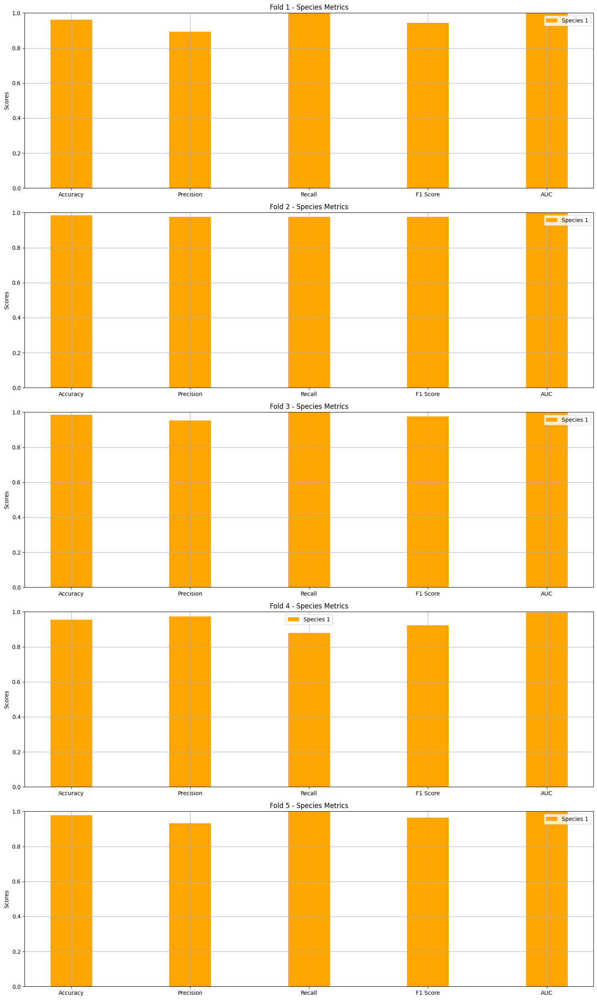


Fold 1 Metrics:
Accuracy: 0.9618, Precision: 0.8936, Recall: 1.0000, F1 Score: 0.9438, AUC: 0.9984

Fold 2 Metrics:
Accuracy: 0.9847, Precision: 0.9756, Recall: 0.9756, F1 Score: 0.9756, AUC: 0.9986

Fold 3 Metrics:
Accuracy: 0.9847, Precision: 0.9535, Recall: 1.0000, F1 Score: 0.9762, AUC: 1.0000

Fold 4 Metrics:
Accuracy: 0.9538, Precision: 0.9730, Recall: 0.8780, F1 Score: 0.9231, AUC: 0.9973

Fold 5 Metrics:
Accuracy: 0.9769, Precision: 0.9318, Recall: 1.0000, F1 Score: 0.9647, AUC: 1.0000


In [38]:
import matplotlib.pyplot as plt
import numpy as np

print(all_per_species_test_metrics)

# Number of metrics per fold (Accuracy, Precision, Recall, F1, AUC)
num_metrics = 5

# X positions for each metric group
x = np.arange(num_metrics)  # No need for species-based indexing

# Bar width
width = 0.35

# Create subplots for each fold (one bar chart with all metrics)
fig, axes = plt.subplots(5, figsize=(15, 5 * 5))

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Iterate over each fold to create the bar charts
for fold in range(5):
    # Extract per-species metrics for this fold
    species_1_accuracy = all_per_species_test_metrics['accuracy'][fold][1]
    species_1_precision = all_per_species_test_metrics['precision'][fold][1]
    species_1_recall = all_per_species_test_metrics['recall'][fold][1]
    species_1_f1 = all_per_species_test_metrics['f1'][fold][1]
    species_1_auc = all_test_metrics['auc'][fold]

    # Create the bars for this fold (only Species 1)
    axes[fold].bar(x, [species_1_accuracy, species_1_precision, species_1_recall, species_1_f1, species_1_auc],
                   width, label='Species 1', color='orange')

    axes[fold].set_title(f"Fold {fold + 1} - Species Metrics")
    axes[fold].set_xticks(x)
    axes[fold].set_xticklabels(metric_labels)
    axes[fold].set_ylabel('Scores')
    axes[fold].set_ylim(0, 1)  # Ensuring y-axis ranges from 0 to 1 for metric comparison
    axes[fold].legend()
    axes[fold].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

# Print only Species 1 metrics per fold
for fold in range(5):
    print(f"\nFold {fold + 1} Metrics:")
    print(f"Accuracy: {all_per_species_test_metrics['accuracy'][fold][1]:.4f}, "
          f"Precision: {all_per_species_test_metrics['precision'][fold][1]:.4f}, "
          f"Recall: {all_per_species_test_metrics['recall'][fold][1]:.4f}, "
          f"F1 Score: {all_per_species_test_metrics['f1'][fold][1]:.4f}, "
          f"AUC: {all_test_metrics['auc'][fold]:.4f}")


### Average Over All Test Metrics Per Species

/var/folders/tw/djq1qjxx4_v0lvns6wbl3cxm0000gn/T/ipykernel_43619/1178646722.py:30: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


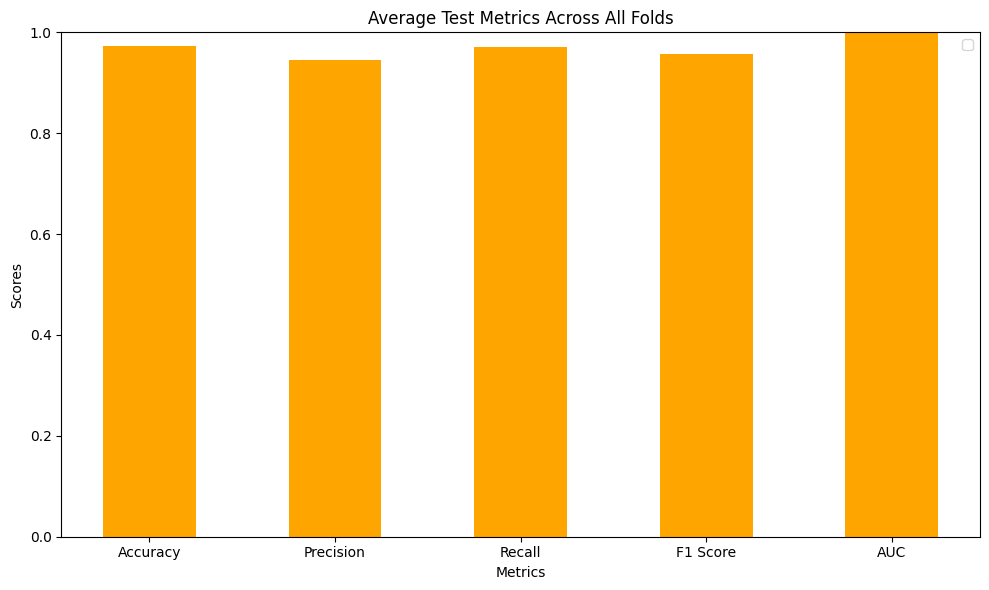

Average Test Metrics Across All Folds:
Accuracy: 0.9724, Precision: 0.9455, Recall: 0.9707, F1 Score: 0.9567, AUC: 0.9989


In [45]:
import matplotlib.pyplot as plt
import numpy as np

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Calculate the average values for each metric across all folds (only Species 1)
avg_accuracy_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['accuracy']])
avg_precision_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['precision']])
avg_recall_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['recall']])
avg_f1_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['f1']])
avg_auc_species_1 = np.mean(all_test_metrics['auc'])

# Create a bar chart for Species 1
x = np.arange(len(metric_labels))  # X positions for each metric
width = 0.5  # Adjusted bar width since we're only plotting one species

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(x, [avg_accuracy_species_1, avg_precision_species_1, avg_recall_species_1, avg_f1_species_1, avg_auc_species_1],
       width, color='orange')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average test metrics (only Species 1)
print("Average Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy_species_1:.4f}, Precision: {avg_precision_species_1:.4f}, "
      f"Recall: {avg_recall_species_1:.4f}, F1 Score: {avg_f1_species_1:.4f}, AUC: {avg_auc_species_1:.4f}")


### Average Overall Across All Folds for Test Metrics

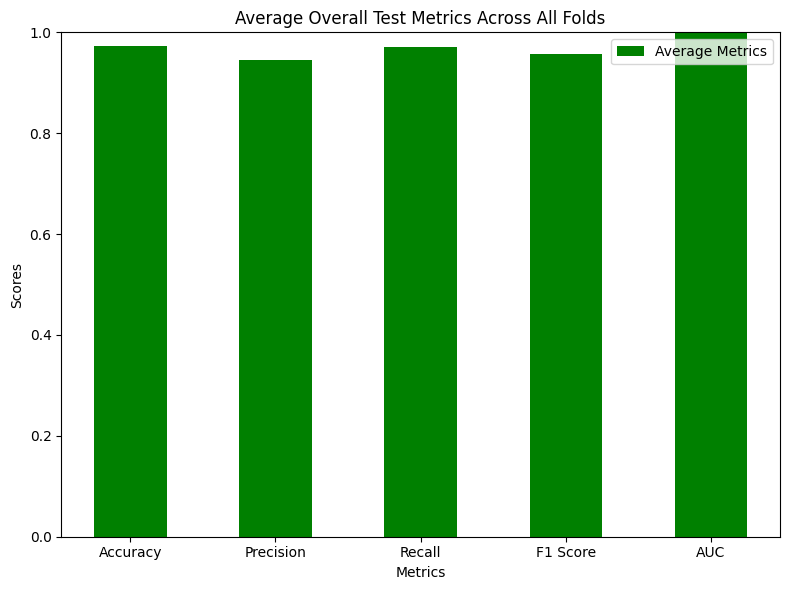

Average Overall Test Metrics Across All Folds:
Accuracy: 0.9724
Precision: 0.9455
Recall: 0.9707
F1 Score: 0.9567
AUC: 0.9989


In [40]:
# Calculate the average values for each metric across all folds
avg_accuracy = np.mean(all_test_metrics['accuracy'])
avg_precision = np.mean(all_test_metrics['precision'])
avg_recall = np.mean(all_test_metrics['recall'])
avg_f1 = np.mean(all_test_metrics['f1'])
avg_auc = np.mean(all_test_metrics['auc'])

# Create a bar chart to display the average values
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']
avg_metrics = [avg_accuracy, avg_precision, avg_recall, avg_f1, avg_auc]

x = np.arange(len(metric_labels))  # x positions for each metric
width = 0.5  # Bar width

# Plot the averages for overall metrics
fig, ax = plt.subplots(figsize=(8, 6))
ax.bar(x, avg_metrics, width, color='green', label='Average Metrics')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Overall Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average overall test metrics
print("Average Overall Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy:.4f}")
print(f"Precision: {avg_precision:.4f}")
print(f"Recall: {avg_recall:.4f}")
print(f"F1 Score: {avg_f1:.4f}")
print(f"AUC: {avg_auc:.4f}")

### Overall Per Fold for Test

Fold 1:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 2:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 3:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 4:
  Accuracy  : 0.9692
  Precision : 0.9707
  Recall    : 0.9578
  F1 Score  : 0.9639
  AUC       : 0.9973

Fold 5:
  Accuracy  : 0.9615
  Precision : 0.9583
  Recall    : 0.9522
  F1 Score  : 0.9552
  AUC       : 0.9951



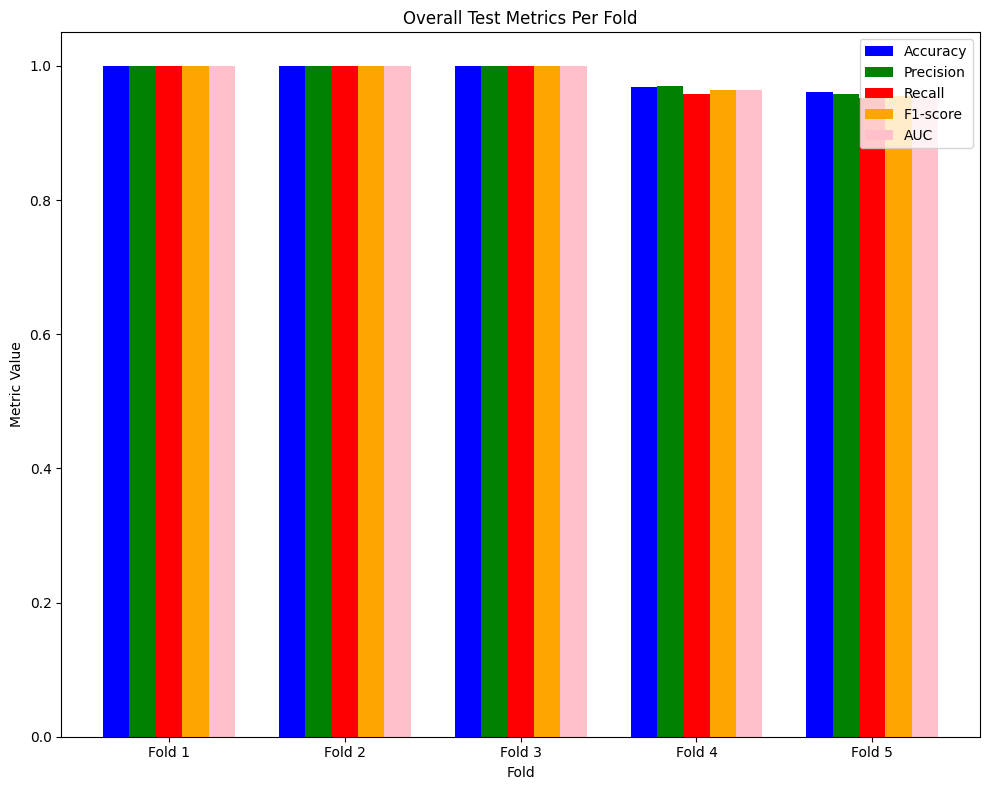

In [100]:
# Set up positions for the bars
folds = range(1, len(all_test_metrics['accuracy']) + 1)

# Set up the bar width
width = 0.15

# Create a figure
plt.figure(figsize=(10, 8))

# Plot one bar chart per fold
for fold in range(len(folds)):
    # Get the metrics for the current fold
    accuracy = all_test_metrics['accuracy'][fold]
    precision = all_test_metrics['precision'][fold]
    recall = all_test_metrics['recall'][fold]
    f1 = all_test_metrics['f1'][fold]
    auc = all_test_metrics['auc'][fold]

    # Print the metrics for this fold
    print(f"Fold {fold + 1}:")
    print(f"  Accuracy  : {accuracy:.4f}")
    print(f"  Precision : {precision:.4f}")
    print(f"  Recall    : {recall:.4f}")
    print(f"  F1 Score  : {f1:.4f}")
    print(f"  AUC       : {auc:.4f}\n")
    
    # Set x positions for the bars
    bar_positions = np.array([fold + 1 - 2 * width, fold + 1 - width, fold + 1, fold + 1 + width, fold + 1 + 2 * width])
    
    # Plot bars for the current fold
    plt.bar(bar_positions[0], accuracy, width, label='Accuracy' if fold == 0 else "", color='b')
    plt.bar(bar_positions[1], precision, width, label='Precision' if fold == 0 else "", color='g')
    plt.bar(bar_positions[2], recall, width, label='Recall' if fold == 0 else "", color='r')
    plt.bar(bar_positions[3], f1, width, label='F1-score' if fold == 0 else "", color='orange')
    plt.bar(bar_positions[4], f1, width, label='AUC' if fold == 0 else "", color='pink')

# Labeling the graph
plt.title('Overall Test Metrics Per Fold')
plt.xlabel('Fold')
plt.ylabel('Metric Value')
plt.xticks(folds, [f'Fold {i}' for i in folds])

# Display the legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Which Images Did Test Get Wrong?

Processing Confusion Matrix for Fold 1


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


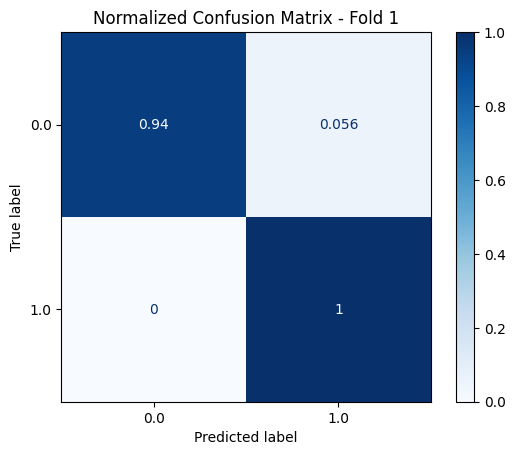

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


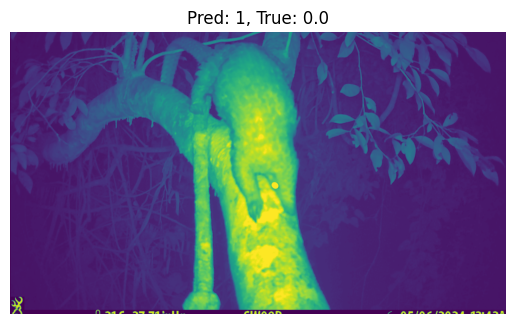

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0271.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


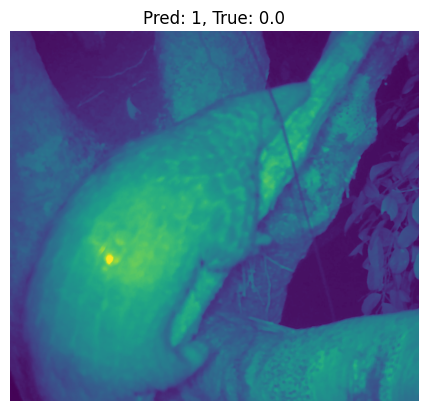

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1174.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


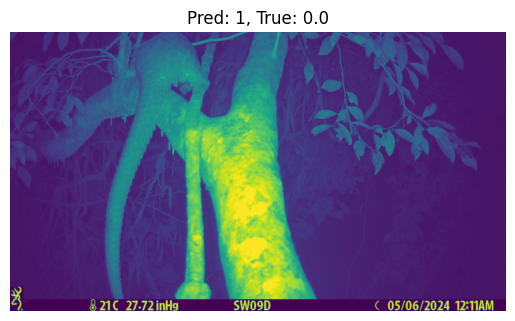

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


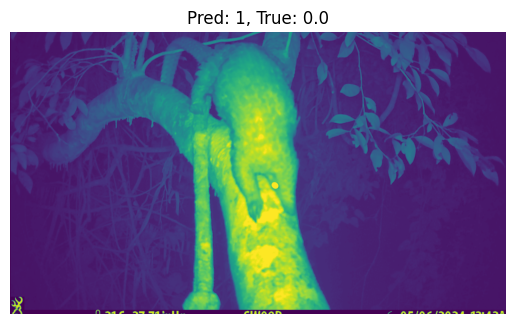

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0252.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


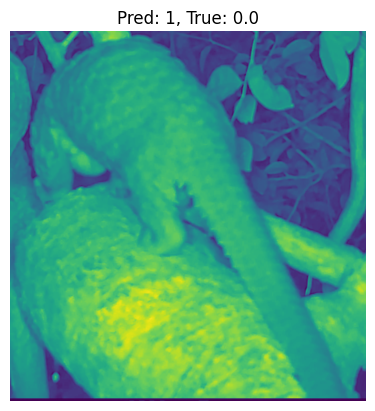

Processing Confusion Matrix for Fold 2


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


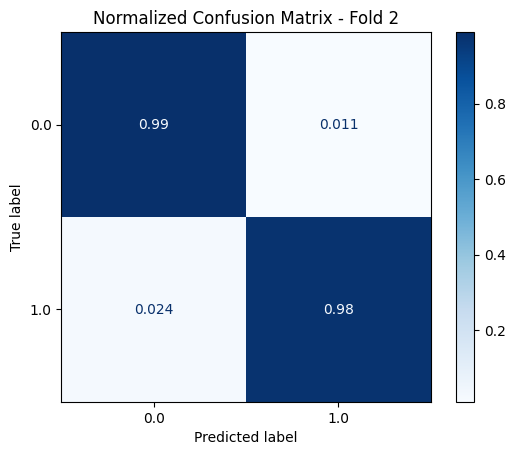

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1097.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


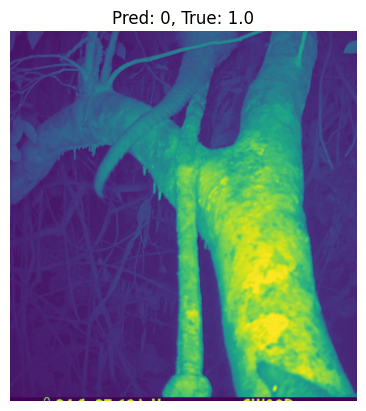

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0558.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


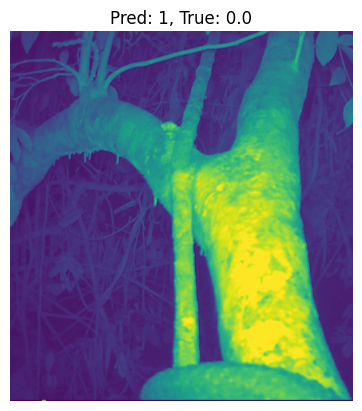

Processing Confusion Matrix for Fold 3


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


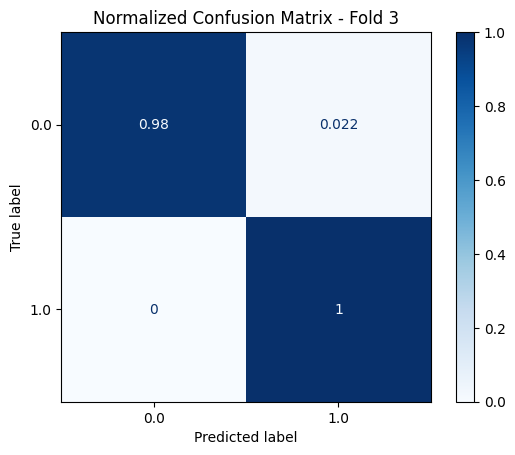

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0966.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


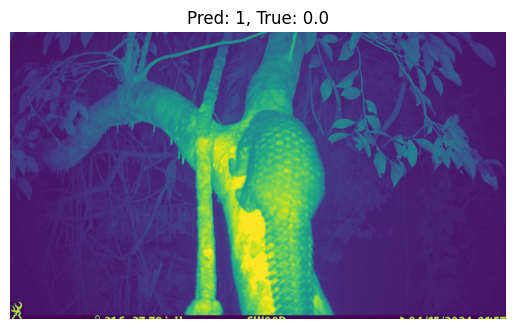

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1637.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


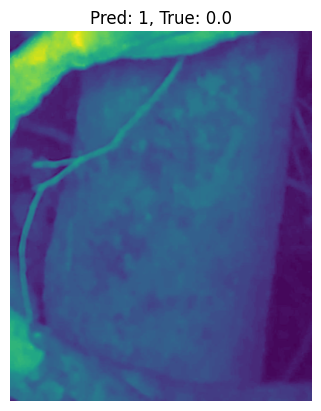

Processing Confusion Matrix for Fold 4


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


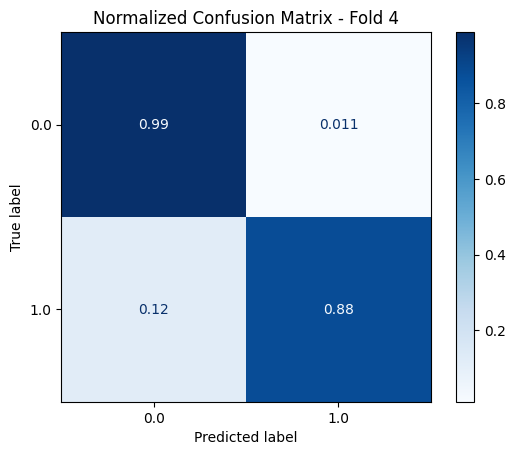

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1197.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


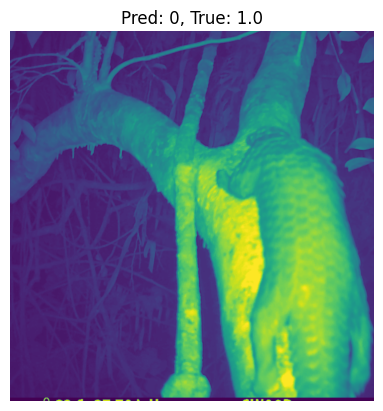

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1179.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


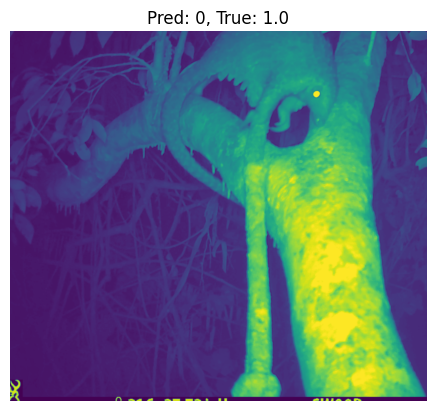

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1176.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


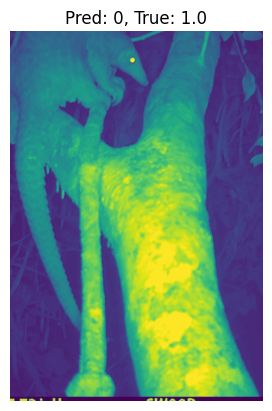

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1198.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


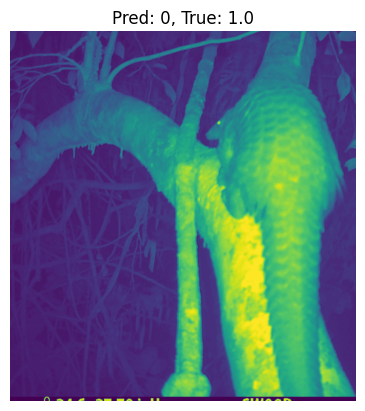

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1285.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


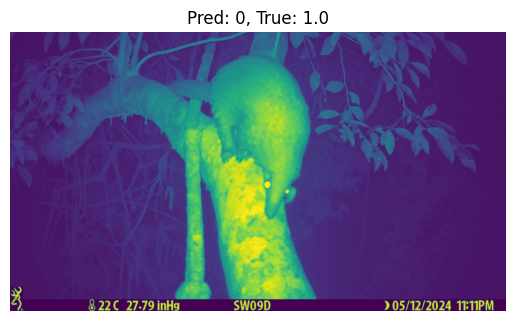

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0417.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


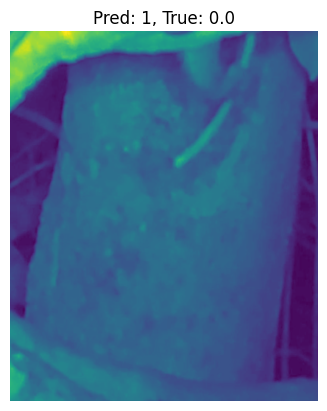

Processing Confusion Matrix for Fold 5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


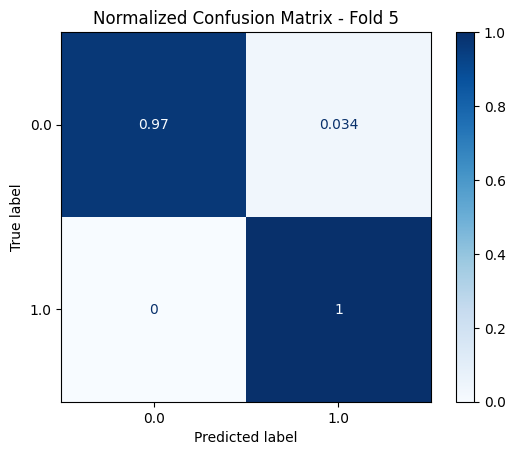

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1142.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


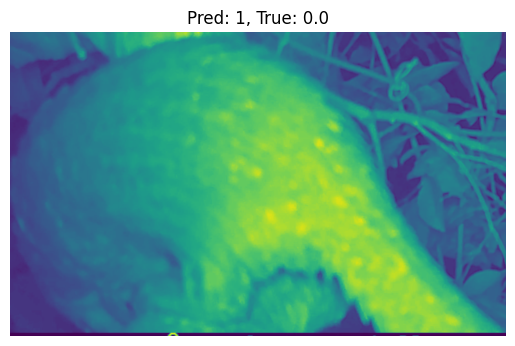

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0251.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


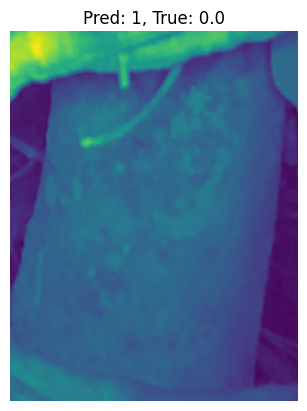

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1170.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


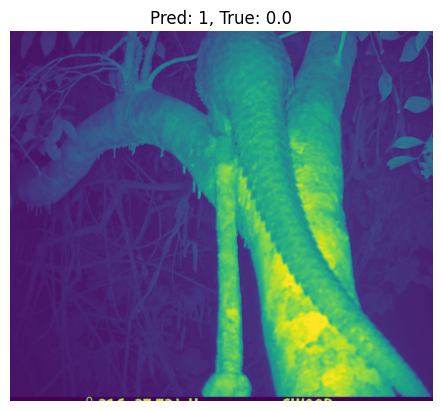

In [46]:
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image



strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=True)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    misclassified_images = []  # To store misclassified images and their predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            # Check for misclassified samples
            for i in range(len(preds)):
                if preds[i] != labels[i].item():  # If prediction is incorrect
                    misclassified_images.append((test_data.iloc[i]['filepath'], preds[i], labels[i].item(), images[i]))

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()

    # Now print out the misclassified images
    for file_path, pred, true_label, image in misclassified_images:
        print(f"Misclassified Image: {file_path}")
        print(f"Predicted Label: {pred}, True Label: {true_label}")

        # Load and display the image
        img = Image.open(file_path)
        plt.imshow(img)
        plt.title(f"Pred: {pred.item()}, True: {true_label}")
        plt.axis('off')  # Turn off axis labels
        plt.show()



        



In [10]:
from sklearn.model_selection import StratifiedKFold, train_test_split
import numpy as np
from collections import Counter

# Assume strat_kf, combined_df, x_train, and y_train are already defined
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set

    #print(f"Test indices (Fold {fold+1}): {test_index.tolist()}")

    # Further split the training data into training and validation (90/10 split)
    train_data, val_data, train_labels, val_labels, train_idx, val_idx = train_test_split(
        train_data, train_labels,  # Original training data and labels
        train_index,  # Pass train_index to track indices
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )

    #print(f"Train indices (Fold {fold+1}): {train_idx.tolist()}")
    #print(f"Validation indices (Fold {fold+1}): {val_idx.tolist()}")
    
    print(f"Train size: {len(train_idx)}, Validation size: {len(val_idx)}, Test size: {len(test_index)}")

    # Print label distributions
    print(f"Train label counts (Fold {fold+1}): {dict(Counter(train_labels))}")
    print(f"Validation label counts (Fold {fold+1}): {dict(Counter(val_labels))}")
    print(f"Test label counts (Fold {fold+1}): {dict(Counter(test_labels))}")
    print("\n")


    

Fold 1/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 1): {np.int64(0): 322, np.int64(1): 147}
Validation label counts (Fold 1): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 1): {np.int64(1): 42, np.int64(0): 89}


Fold 2/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 2): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 2): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 2): {np.int64(1): 41, np.int64(0): 90}


Fold 3/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 3): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 3): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 3): {np.int64(1): 41, np.int64(0): 90}


Fold 4/5
Train size: 470, Validation size: 53, Test size: 130
Train label counts (Fold 4): {np.int64(0): 322, np.int64(1): 148}
Validation label counts (Fold 4): {np.int64(0): 36, np.int64(1): 17}
Test label counts

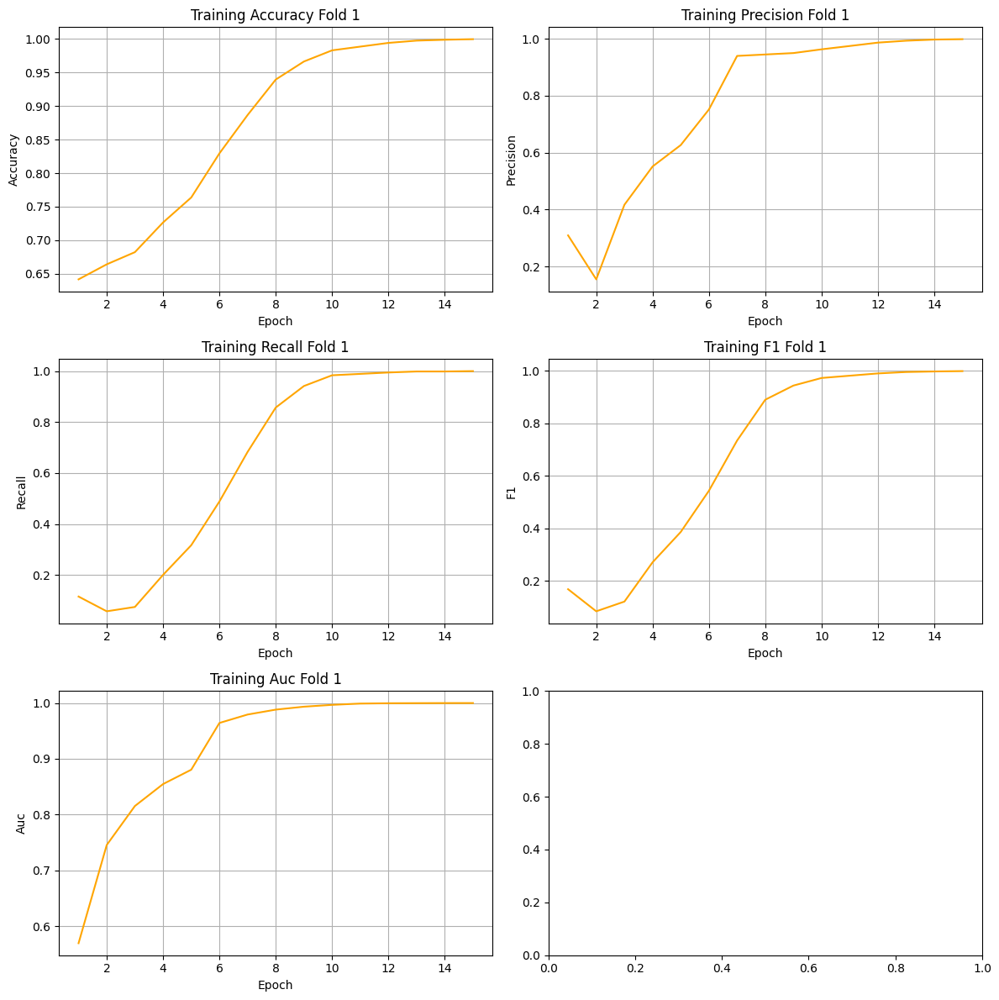

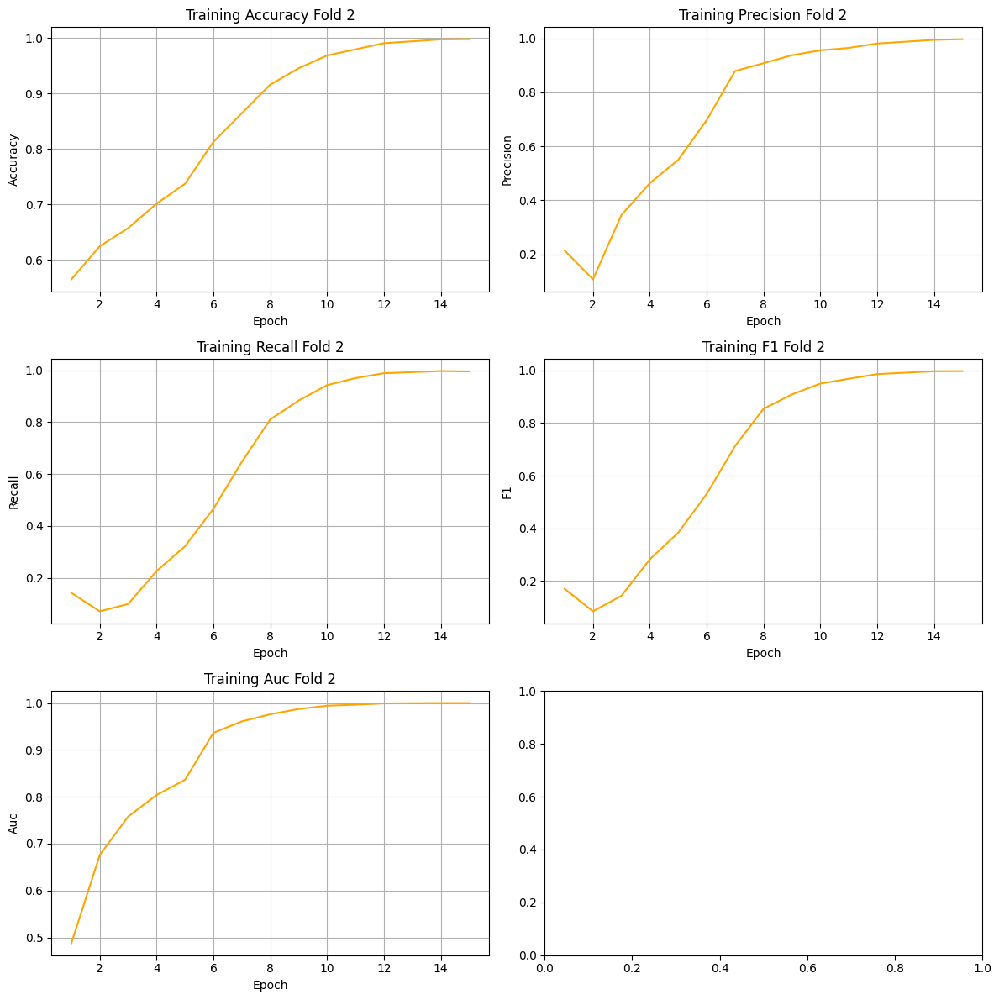

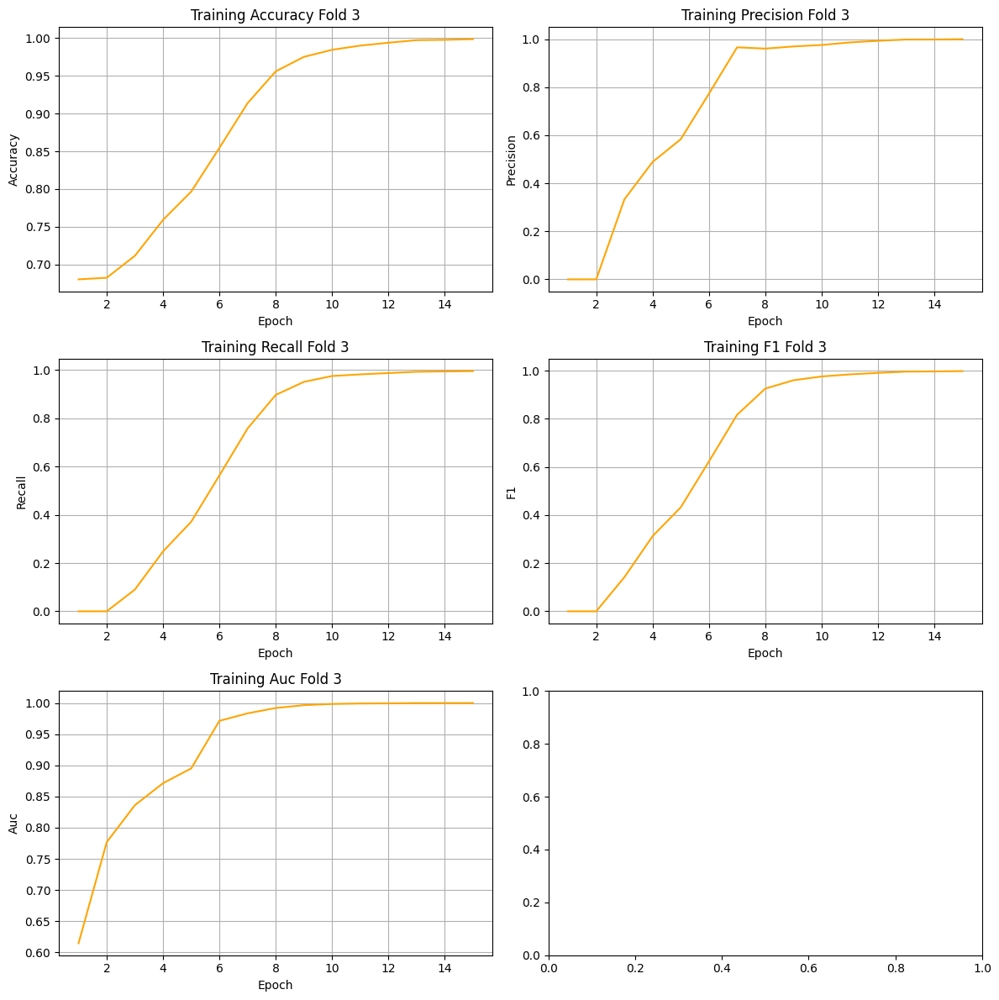

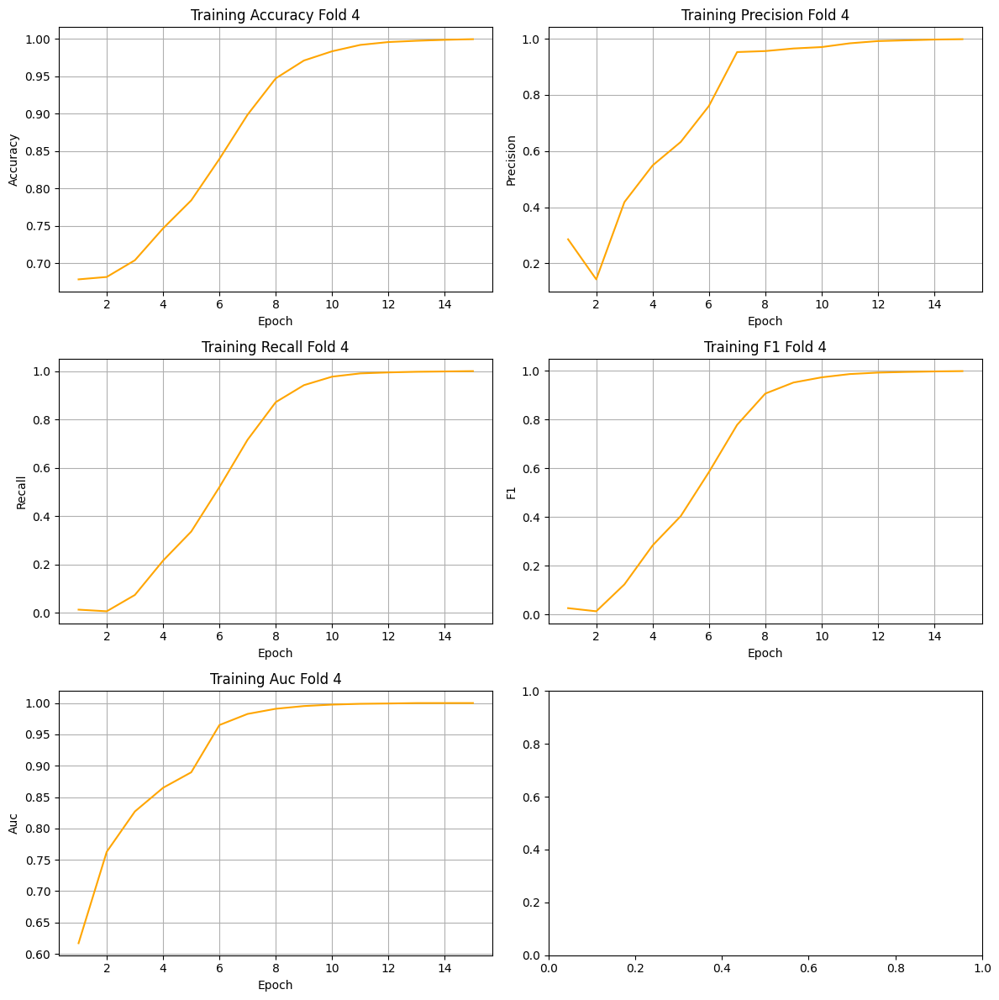

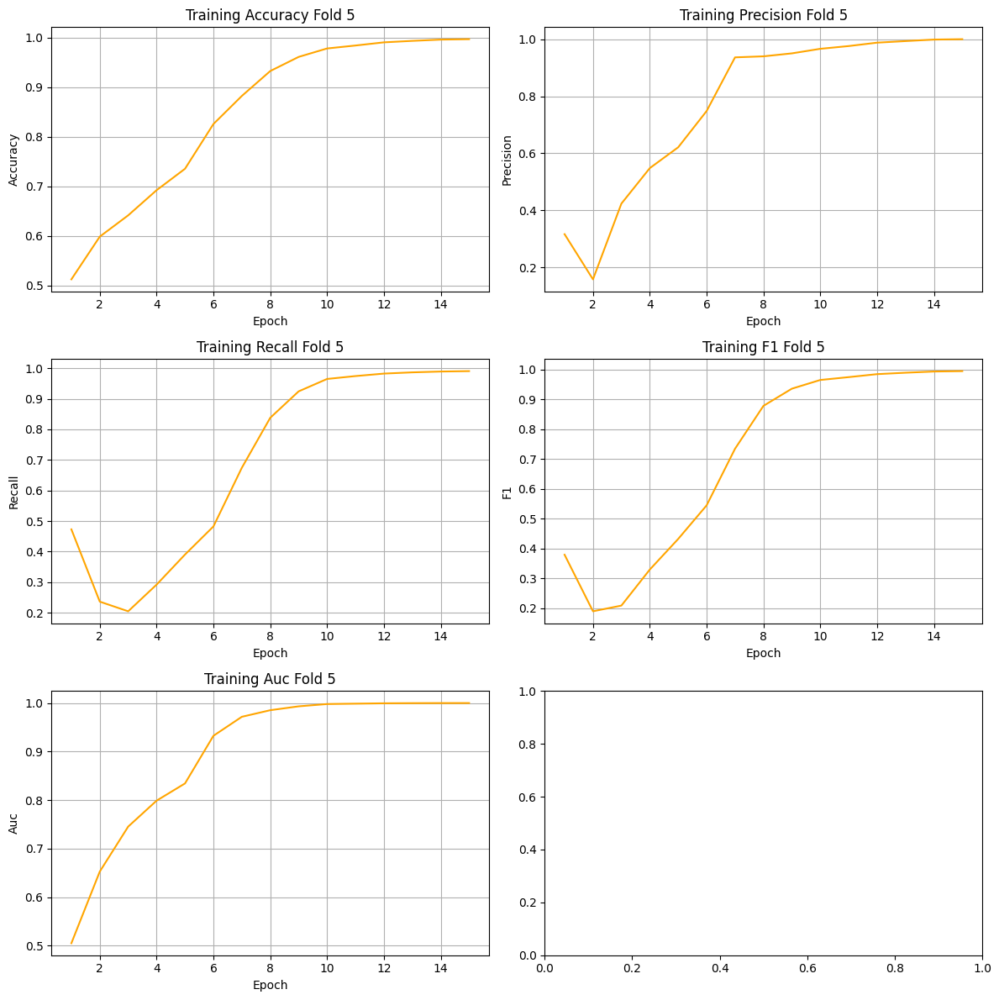

In [43]:
import matplotlib.pyplot as plt
import pandas as pd

# Function to create a DataFrame for Species 1 only
def create_dataframe_species_1(fold_data):
    species_1_values = [data[1] for data in fold_data]  # Extract only Species 1 values
    df = pd.DataFrame({
        "Species 1": species_1_values
    })
    df['Epoch'] = df.index + 1  # Add 'Epoch' column (starting from 1)
    return df

# Function to plot metrics for Species 1
def plot_metrics_for_species_1(fold_number, per_epoch_accuracy, per_epoch_precision, per_epoch_f1, per_epoch_recall, per_epoch_auc):
    metrics = ['accuracy', 'precision', 'recall', 'f1', 'auc']
    
    # Create subplots for each metric (single species)
    fig, axs = plt.subplots(3, 2, figsize=(12, 12))

    # For each metric, plot the values with moving averages
    for i, metric in enumerate(metrics):
        row = i // 2
        col = i % 2

        # Select the appropriate data for the current fold and metric
        if metric == 'accuracy':
            data = per_epoch_accuracy
        elif metric == 'precision':
            data = per_epoch_precision
        elif metric == 'f1':
            data = per_epoch_f1
        elif metric == 'recall':
            data = per_epoch_recall
        elif metric == 'auc':
            data = per_epoch_auc
        
        # Create a DataFrame for the metric data (Species 1 only)
        df = create_dataframe_species_1(data)
        
        # Calculate the moving average for Species 1
        df['Species 1 MA'] = df['Species 1'].rolling(window=5, min_periods=1).mean()

        # Plot the values for Species 1
        axs[row, col].plot(df['Epoch'], df['Species 1 MA'], label='Species 1', color='orange')
        axs[row, col].set_title(f'Training {metric.capitalize()} Fold {fold_number}')
        axs[row, col].set_xlabel('Epoch')
        axs[row, col].set_ylabel(f'{metric.capitalize()}')
        #axs[row, col].legend()
        axs[row, col].grid(True)

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Plot metrics for each fold (Species 1 only)
for fold_number in range(1, 6):
    plot_metrics_for_species_1(fold_number, 
                               all_per_species_train_metrics['accuracy'][fold_number-1], 
                               all_per_species_train_metrics['precision'][fold_number-1], 
                               all_per_species_train_metrics['f1'][fold_number-1], 
                               all_per_species_train_metrics['recall'][fold_number-1], 
                               all_per_species_train_metrics['auc'][fold_number-1])
